
# Módulo de productividad de pozos

Analisis estadístico y simulación de gasto en pozos. 

Información de producción histórica de hidrocarburos de la CNH.

In [28]:
import pandas as pd
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
import os
import scipy
import scipy.stats
from scipy.optimize import curve_fit
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
%matplotlib inline

import timeit

In [29]:
pd.set_option('display.max_rows', 100_000_000)
pd.set_option('display.max_columns', 100_000_000)
pd.set_option('display.width', 1_000)
pd.set_option('precision', 2)
pd.options.display.float_format = '{:,.2f}'.format

# Función Productividad de pozos

In [45]:
def productividad():
    
    global campo
    global unique_well_list
    global input_campo
    global well_data
    global results
    
    tic=timeit.default_timer()
    
#####################   DISTRIBUCION DE PROBABILIDAD   #####################
    
    class Distribution(object):
    
        def __init__(self,dist_names_list = []):
            self.dist_names = ['beta',
                                'expon',
                                'gamma',
                                'lognorm',
                                'norm',
                                'pearson3',
                                'triang',
                                'uniform',
                                'weibull_min', 
                                'weibull_max']
            self.dist_results = []
            self.params = {}

            self.DistributionName = ""
            self.PValue = 0
            self.Param = None

            self.isFitted = False


        def Fit(self, y):
            self.dist_results = []
            self.params = {}
            for dist_name in self.dist_names:
                dist = getattr(scipy.stats, dist_name)
                param = dist.fit(y)

                self.params[dist_name] = param
                #Applying the Kolmogorov-Smirnov test
                D, p = scipy.stats.kstest(y, dist_name, args=param);
                self.dist_results.append((dist_name,p))
            #select the best fitted distribution
            sel_dist,p = (max(self.dist_results,key=lambda item:item[1]))
            #store the name of the best fit and its p value
            self.DistributionName = sel_dist
            self.PValue = p

            self.isFitted = True
            return self.DistributionName,self.PValue

        def Random(self, n = 1):
            if self.isFitted:
                dist_name = self.DistributionName
                param = self.params[dist_name]
                #initiate the scipy distribution
                dist = getattr(scipy.stats, dist_name)
                return dist.rvs(*param[:-2], loc=param[-2], scale=param[-1], size=n)
            else:
                raise ValueError('Must first run the Fit method.')

        def Plot(self,y):
            x = self.Random(n=len(y))
            fig, ax = plt.subplots(figsize=(16,8))
            plt.hist(x, alpha=0.5, label='Fitted',bins=50)
            plt.hist(y, alpha=0.5, label='Actual',bins=50)
            plt.legend(loc='upper right')

    
#####################  ESTADISTICA DE POZOS   #####################
    
    
    #Carga de datos   
    mx_stats=pd.read_csv(r'C:/Users/elias/Google Drive/python/csv/benchmark/mexico/pozos/mx_benchmark.csv',
                         low_memory=False)
    
    display('Numero de datos en BD: '+str(len(mx_stats)))
    
    #Input de campo
    input_campo = input("Nombre de Campo: ")
    
    selected_rows=mx_stats.pozo.str.contains(str(input_campo))
    campo=mx_stats.loc[selected_rows]

    display('Numero de datos para '+str(input_campo)+': ' +str(len(campo)))
    
    unique_well_list=pd.unique(campo['pozo'])

    display('Número de pozos en ' +str(input_campo)+': '+str(len(unique_well_list)),
            unique_well_list)
    
    #Estadistica descriptiva
    display('Percentiles y estadistica descriptiva: ')
    display(campo.aceite_Mbd.quantile([.1,.5,.9]),
            campo.describe())  
    
    #Analisis de dispersion
    fig, ax = plt.subplots(figsize=(16,8))
    ax.scatter(campo.pozo,campo.aceite_Mbd)
    ax.set_xlabel('Pozo')
    ax.set_xticklabels(labels=campo.pozo,rotation=90)
    ax.set_ylabel('Gasto de aceite Mbd')
    plt.show()
    
    #Ajuste de distribucion
    dst=Distribution()
    display(dst.Fit(campo.aceite_Mbd))
    dst.Plot(campo.aceite_Mbd)
    
    #Generacion de archivo de resultados
    campo.to_csv(r'C:/Users/elias/Google Drive/python/csv/benchmark/'+str(input_campo)+str('.csv'))
    

#####################  ANALISIS DE DECLINACION DE POZOS   #####################
    
    
    def remove_nan_and_zeroes_from_columns(df, variable):
        """
        This function cleans up a dataframe by removing rows in a specific 
        column that are null/NaN or equal to 0. This basically removes zero 
        production time periods.
        Arguments:
        df: Pandas dataframe.
        variable: String. Name of the column where we want to filter out
        NaN's or 0 values
        Output:
        filtered_df: Pandas dataframe. Dataframe with NaN's and zeroes filtered out of 
        the specified column
        """
        filtered_df = df[(df[variable].notnull()) & (df[variable]>0)]
        return filtered_df

    def generate_time_delta_column(df, time_column, date_first_online_column):
        """
        Create column for the time that a well has been online at each reading, with 
        the first non-null month in the series listed as the start of production
        Arguments:
        df: Pandas dataframe
        time_column: String. Name of the column that includes the specific record date
        that the data was taken at. Column type is pandas datetime
        date_first_online_column: Name of the column that includes the date that the
        well came online. Column type is pandas datetime
        Outputs:
        Pandas series containing the difference in days between the date the well
        came online and the date that the data was recorded (cumulative days online)
        """
        df['Dias Produciendo']=(df[time_column]-df[date_first_online_column]).dt.days
        return (df[time_column]-df[date_first_online_column]).dt.days

    def get_min_or_max_value_in_column_by_group(dataframe, group_by_column, calc_column, calc_type):
        """
        This function obtains the min or max value for a column, with a group by applied. For example,
        it could return the earliest (min) RecordDate for each API number in a dataframe 
        Arguments:
        dataframe: Pandas dataframe 
        group_by_column: string. Name of column that we want to apply a group by to
        calc_column: string. Name of the column that we want to get the aggregated max or min for
        calc_type: string; can be either 'min' or 'max'. Defined if we want to pull the min value 
        or the max value for the aggregated column
        Outputs:
        value: Depends on the calc_column type.
        """
        value=dataframe.groupby(group_by_column)[calc_column].transform(calc_type)
        return value

    def get_max_initial_production(df, number_first_months, variable_column, date_column):
        """
        This function allows you to look at the first X months of production, and selects 
        the highest production month as max initial production
        Arguments:
        df: Pandas dataframe. 
        number_first_months: float. Number of months from the point the well comes online
        to compare to get the max initial production rate qi (this looks at multiple months
        in case there is a production ramp-up)
        variable_column: String. Column name for the column where we're attempting to get
        the max volume from (can be either 'Gas' or 'Oil' in this script)
        date_column: String. Column name for the date that the data was taken at 
        """
        #First, sort the data frame from earliest to most recent prod date
        df=df.sort_values(by=date_column)
        #Pull out the first x months of production, where number_first_months is x
        df_beginning_production=df.head(number_first_months)
        #Return the max value in the selected variable column from the newly created 
        #df_beginning_production df
        return df_beginning_production[variable_column].max()

    def hyperbolic_equation(t, qi, b, di):
        """
        Hyperbolic decline curve equation
        Arguments:
        t: Float. Time since the well first came online, can be in various units 
        (days, months, etc) so long as they are consistent.
        qi: Float. Initial production rate when well first came online.
        b: Float. Hyperbolic decline constant
        di: Float. Nominal decline rate at time t=0
        Output: 
        Returns q, or the expected production rate at time t. Float.
        """
        return qi/((1.0+b*di*t)**(1.0/b))

    def exponential_equation(t, qi, di):
        """
        Exponential decline curve equation
        Arguments:
        t: Float. Time since the well first came online, can be in various units 
        (days, months, etc) so long as they are consistent.
        qi: Float. Initial production rate when well first came online.
        di: Float. Nominal decline rate (constant)
        Output: 
        Returns q, or the expected production rate at time t. Float.
        """
        return qi*np.exp(-di*t)

    def harmonic_equation (t, qi, di):
        """
        Harmonic decline curve equation
        Arguments:
        t: Float. Time since the well first came online, can be in various units 
        (days, months, etc) so long as they are consistent.
        qi: Float. Initial production rate when well first came online.
        di: Float. Nominal decline rate (constant)
        Output: 
        Returns q, or the expected production rate at time t. Float.
        """
        return qi/(1+(di*t))

    def plot_actual_vs_predicted_by_equations(df, x_variable, y_variables, plot_title):
        """
        This function is used to map x- and y-variables against each other
        Arguments:
        df: Pandas dataframe.
        x_variable: String. Name of the column that we want to set as the 
        x-variable in the plot
        y_variables: string (single), or list of strings (multiple). Name(s) 
        of the column(s) that we want to set as the y-variable in the plot
        """
        #Plot results
        df.plot(x=x_variable, y=y_variables, title=plot_title,figsize=(10,5))
        plt.show()
   
    results=pd.DataFrame()
    #Read the oil and gas data
    well_data=campo
    #Perform some data cleaning to get the columns as the right data type
    well_data['fecha']=pd.to_datetime(well_data['fecha'])
    #Declare the desired product that we want to curve fit for--it can either by 'Gas' or 'Oil'
    hydrocarbon='aceite_Mbd'
    #Remove all rows with null values in the desired time series column
    well_data=remove_nan_and_zeroes_from_columns(well_data, hydrocarbon)
    #Get a list of unique wells to loop through
    unique_well_list=pd.unique(list(well_data.pozo))
    #Get the earliest RecordDate for each Well
    well_data['first_oil']= get_min_or_max_value_in_column_by_group(well_data, group_by_column='pozo', 
                                                                    calc_column='fecha', calc_type='min')
    #Generate column for time online delta
    well_data['days_online']=generate_time_delta_column(well_data, time_column='fecha', 
                  date_first_online_column='first_oil')
    #Pull data that came online between an specified range
    well_data_range=well_data[(well_data.fecha>='1900-01-01') & (well_data.fecha<='2019-12-01')]
    #Loop through each well, and perform calculations
    for pozo in unique_well_list:
        #Subset the dataframe by Well
        production_time_series=well_data_range[well_data_range.pozo==pozo]
        #Get the highest value of production in the first X months of production, to use as qi value
        qi=get_max_initial_production(production_time_series, 6, hydrocarbon, 'fecha')
        #Exponential curve fit the data to get best fit equation
        popt_exp, pcov_exp=curve_fit(exponential_equation, production_time_series['days_online'], 
                                     production_time_series[hydrocarbon],bounds=(0, [qi,10]))
        print('Exponential Fit Curve-fitted Variables: qi='+str(popt_exp[0])+', di='+str(popt_exp[1]))
        #Hyperbolic curve fit the data to get best fit equation
        popt_hyp, pcov_hyp=curve_fit(hyperbolic_equation, production_time_series['days_online'], 
                                     production_time_series[hydrocarbon],bounds=(0, [qi,2,10]))
        print('Hyperbolic Fit Curve-fitted Variables: qi='+str(popt_hyp[0])+', b='+str(popt_hyp[1])+', di='+str(popt_hyp[2]))
        #Harmonic curve fit the data to get best fit equation
        popt_harm, pcov_harm=curve_fit(harmonic_equation, production_time_series['days_online'], 
                                     production_time_series[hydrocarbon],bounds=(0, [qi,10]))
        print('Harmonic Fit Curve-fitted Variables: qi='+str(popt_harm[0])+', di='+str(popt_harm[1]))
        #Exponential fit results
        production_time_series.loc[:,'Exponential_Predicted']=exponential_equation(production_time_series['days_online'], 
                                  *popt_exp)

        #Hyperbolic fit results
        production_time_series.loc[:,'Hyperbolic_Predicted']=hyperbolic_equation(production_time_series['days_online'], 
                                  *popt_hyp)
        #Harmonic fit results
        production_time_series.loc[:,'Harmonic_Predicted']=harmonic_equation(production_time_series['days_online'], 
                                  *popt_harm)

        production_time_series.loc[:,'Qi']=popt_harm[0]
        production_time_series.loc[:,'di']=popt_harm[1]

        #Declare the x- and y- variables that we want to plot against each other
        y_variables=[hydrocarbon,"Hyperbolic_Predicted", "Exponential_Predicted", "Harmonic_Predicted"]
        x_variable='days_online'
        #Create the plot title
        plot_title=hydrocarbon+' for '+str(pozo)
        #Plot the data to visualize the equation fit
        plot_actual_vs_predicted_by_equations(production_time_series, x_variable, y_variables, plot_title)

        results=results.append(production_time_series,sort=True)

#####################  RESULTADOS DCA   #####################

    results.to_csv(r'C:/Users/elias/Google Drive/python/csv/benchmark/'+str(input_campo)+'_dca.csv')
    
    fig2, ax2 = plt.subplots(figsize=(16,8))
    plt.hist(results.aceite_Mbd, alpha=0.5, label='Qo Historico',bins=50)
    plt.hist(results.Hyperbolic_Predicted, alpha=0.5, label='Hyperbolic Predicted',bins=50)
    plt.legend(loc='upper right')


    toc=timeit.default_timer()
    tac= toc - tic #elapsed time in seconds

    return display('Tiempo de procesamiento: ' +str(tac)+' segundos')

'Numero de datos en BD: 2838332'

Nombre de Campo: HUMAPA


'Numero de datos para HUMAPA: 20362'

'Número de pozos en HUMAPA: 342'

array(['HUMAPA-1002', 'HUMAPA-1005', 'HUMAPA-1007', 'HUMAPA-1013',
       'HUMAPA-1015', 'HUMAPA-1017', 'HUMAPA-1019', 'HUMAPA-1023',
       'HUMAPA-1025', 'HUMAPA-1026', 'HUMAPA-1027', 'HUMAPA-1029',
       'HUMAPA-1035', 'HUMAPA-1037', 'HUMAPA-1041', 'HUMAPA-1043',
       'HUMAPA-1049', 'HUMAPA-1062', 'HUMAPA-1066', 'HUMAPA-1077',
       'HUMAPA-1082', 'HUMAPA-1083', 'HUMAPA-1091', 'HUMAPA-1234',
       'HUMAPA-1238', 'HUMAPA-1296', 'HUMAPA-1303', 'HUMAPA-1305',
       'HUMAPA-1345', 'HUMAPA-1361', 'HUMAPA-1363', 'HUMAPA-1365',
       'HUMAPA-1368', 'HUMAPA-1381', 'HUMAPA-1383', 'HUMAPA-1385',
       'HUMAPA-1386', 'HUMAPA-1398', 'HUMAPA-1404', 'HUMAPA-1416',
       'HUMAPA-1418', 'HUMAPA-1431', 'HUMAPA-1433', 'HUMAPA-1436',
       'HUMAPA-1442', 'HUMAPA-1452', 'HUMAPA-1453', 'HUMAPA-1456',
       'HUMAPA-1458', 'HUMAPA-1471', 'HUMAPA-1474', 'HUMAPA-1478',
       'HUMAPA-1482', 'HUMAPA-1484', 'HUMAPA-1494', 'HUMAPA-1496',
       'HUMAPA-1498', 'HUMAPA-1602', 'HUMAPA-1603', 'HUMAPA-16

'Percentiles y estadistica descriptiva: '

0.10   0.00
0.50   0.01
0.90   0.03
Name: aceite_Mbd, dtype: float64

,Unnamed: 0,aceite_Mbd,agua_Mbd,condensado_Mbd,gas_asociado_MMpcd,gas_no_asociado_MMpcd
count,"20,362.00","20,362.00","20,362.00","20,362.00","20,362.00","20,362.00"
mean,"506,556.56",0.02,0.00,0.00,0.03,0.00
std,"410,812.94",0.02,0.01,0.00,0.05,0.00
min,"3,109.00",0.00,0.00,0.00,0.00,0.00
25%,"92,483.25",0.01,0.00,0.00,0.01,0.00
50%,"764,192.50",0.01,0.00,0.00,0.02,0.00
75%,"918,076.75",0.02,0.00,0.00,0.04,0.00
max,"999,319.00",0.54,0.31,0.00,0.98,0.00


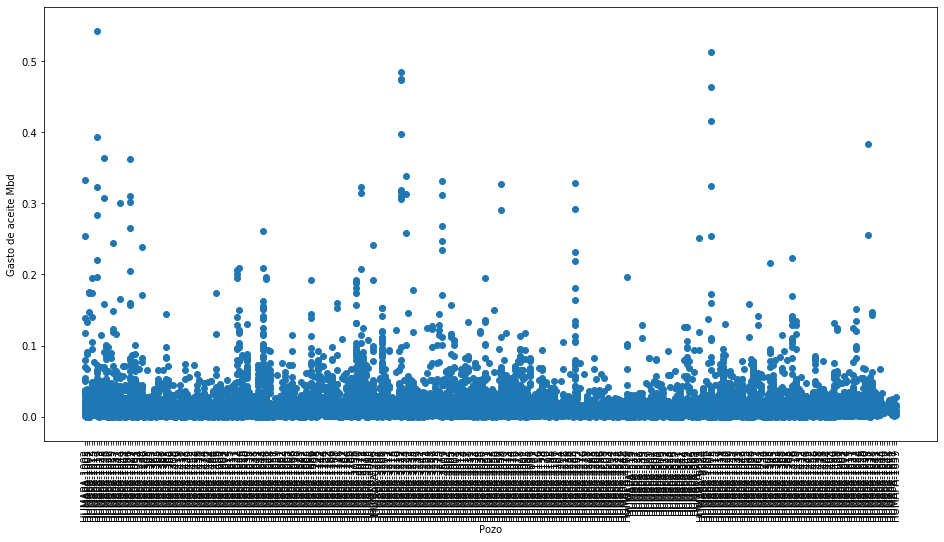

C:\Users\elias\Anaconda\lib\site-packages\scipy\stats\_continuous_distns.py:515: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
C:\Users\elias\Anaconda\lib\site-packages\scipy\optimize\minpack.py:162: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


('lognorm', 5.322498234145575e-46)

C:\Users\elias\Anaconda\lib\site-packages\ipykernel_launcher.py:249: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


Exponential Fit Curve-fitted Variables: qi=0.13897507168747925, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.24769597934894944, b=4.667732651794834e-08, di=0.006289513766115356
Harmonic Fit Curve-fitted Variables: qi=0.24225655282968914, di=0.012174762226110998


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


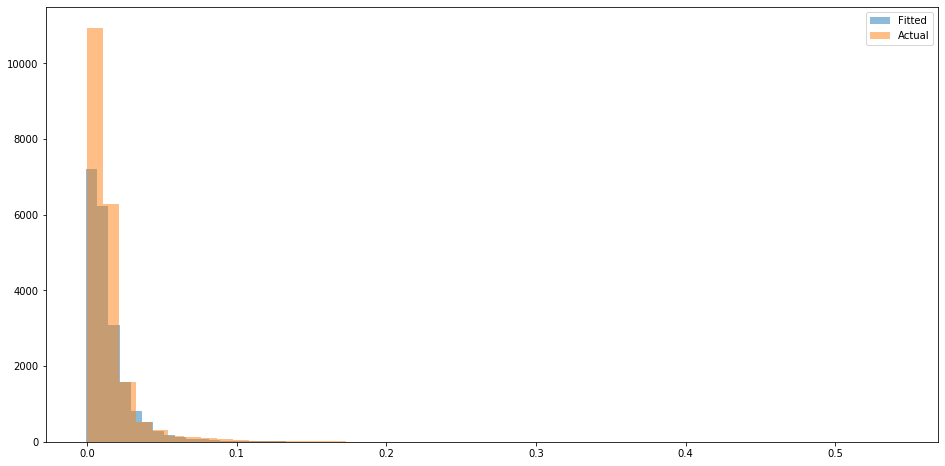

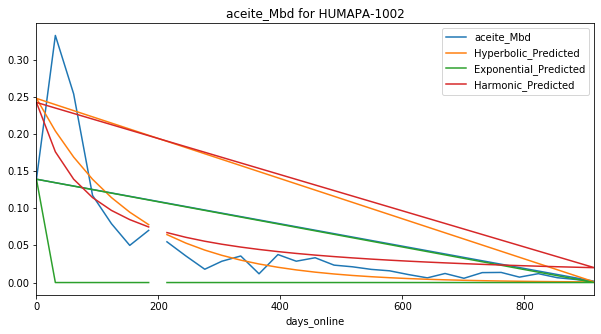

Exponential Fit Curve-fitted Variables: qi=0.13349978271484378, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.133565, b=1.3211474712410107, di=0.019175060930813774
Harmonic Fit Curve-fitted Variables: qi=0.133565, di=0.014524586348663975


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


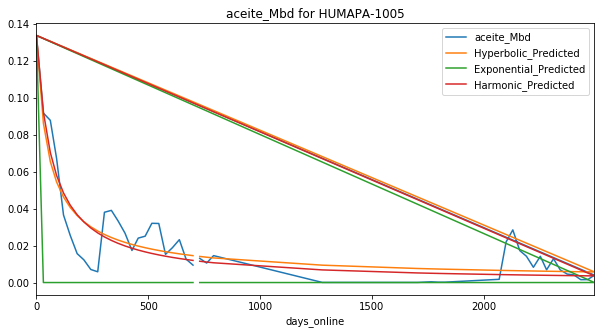

Exponential Fit Curve-fitted Variables: qi=0.1757281533203125, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.17581399999999997, b=0.530050051923764, di=0.013264974295497653
Harmonic Fit Curve-fitted Variables: qi=0.17581399999999991, di=0.019215789081405664


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


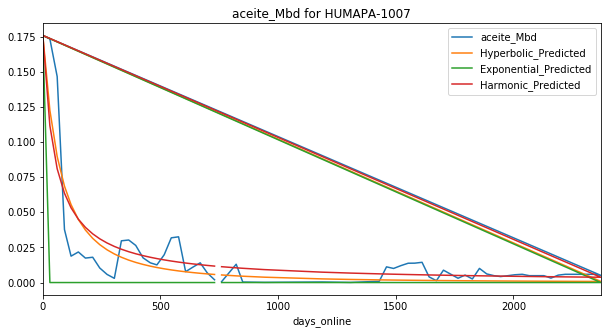

Exponential Fit Curve-fitted Variables: qi=0.09479607614305056, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.15125518018331627, b=1.4874620357195125, di=0.00910150229166217
Harmonic Fit Curve-fitted Variables: qi=0.14942005913582068, di=0.006178217920356741


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


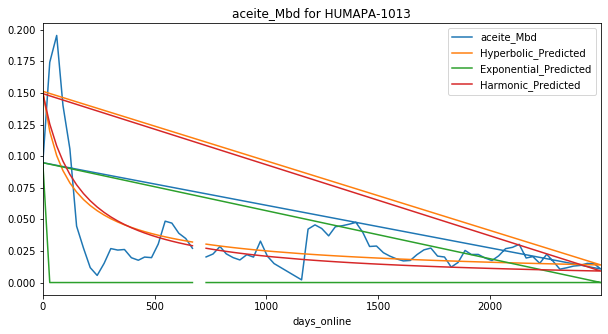

Exponential Fit Curve-fitted Variables: qi=0.07694878125, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.07349158806170707, b=1.9999999999999998, di=0.03107856334662244
Harmonic Fit Curve-fitted Variables: qi=0.041918121884820976, di=0.0033101683309616397


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


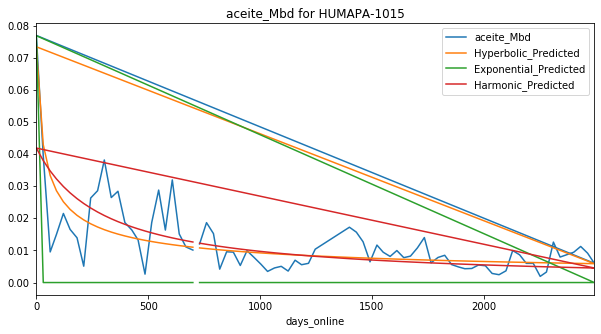

Exponential Fit Curve-fitted Variables: qi=0.19608000022217437, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.4082536926689066, b=0.46616097282940294, di=0.006567842570729811
Harmonic Fit Curve-fitted Variables: qi=0.40154691766582556, di=0.009704936041771183


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


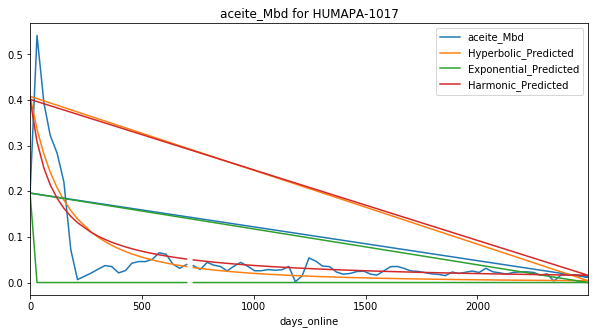

Exponential Fit Curve-fitted Variables: qi=0.01576600016541276, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.027892540272317155, b=1.8889757450461013, di=0.002851795052821475
Harmonic Fit Curve-fitted Variables: qi=0.024643739627791643, di=0.0012808478336831142


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


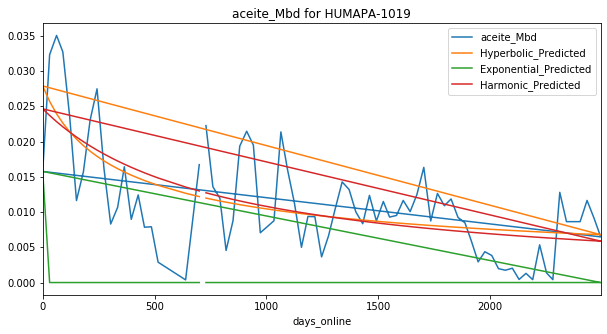

Exponential Fit Curve-fitted Variables: qi=0.114396115234375, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.11445199999999998, b=1.8581757930887048, di=0.07130083053012506
Harmonic Fit Curve-fitted Variables: qi=0.11199671070940222, di=0.026270049279612746


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


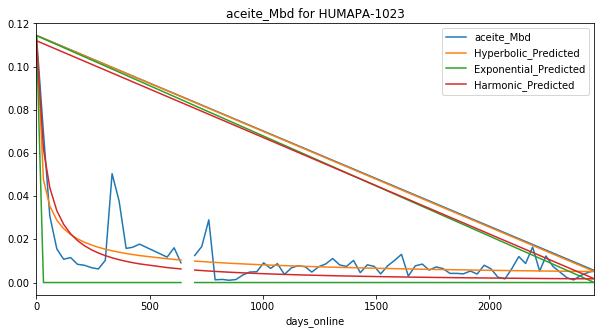

Exponential Fit Curve-fitted Variables: qi=0.06926701472242276, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.2507214980179716, b=1.4629001290921164e-08, di=0.006756654520721482
Harmonic Fit Curve-fitted Variables: qi=0.22306861178154724, di=0.010155726781202851


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


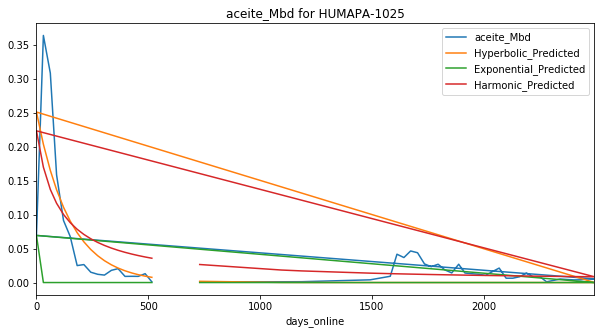

Exponential Fit Curve-fitted Variables: qi=0.09739179312150897, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.09440653825649867, b=0.18175783540971688, di=0.002145413784248688
Harmonic Fit Curve-fitted Variables: qi=0.10111799999999999, di=0.00447441272239216


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


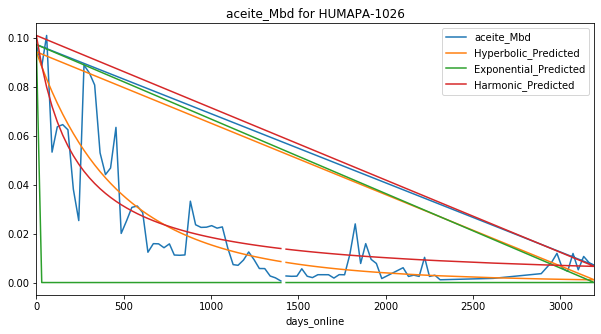

Exponential Fit Curve-fitted Variables: qi=0.04536500005270163, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.0709969037407887, b=0.39567339946248625, di=0.006719700060778182
Harmonic Fit Curve-fitted Variables: qi=0.07204600002012669, di=0.010819218534666546


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


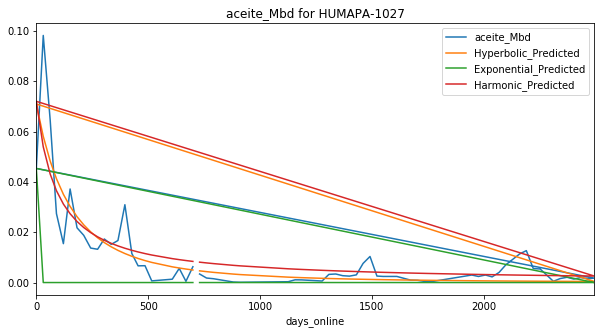

Exponential Fit Curve-fitted Variables: qi=0.03703902645867834, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.06578508409493522, b=1.30701441490994, di=0.007148461306701071
Harmonic Fit Curve-fitted Variables: qi=0.06475876872650316, di=0.005561053667157545


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


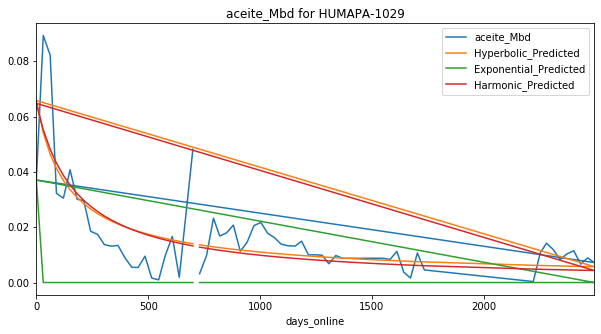

Exponential Fit Curve-fitted Variables: qi=0.06215300000731688, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.14312876698572916, b=5.256438347028528e-07, di=0.004259533351960414
Harmonic Fit Curve-fitted Variables: qi=0.13775944756647632, di=0.007526671489108083


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


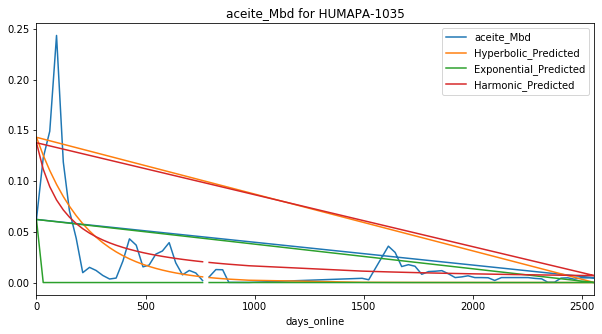

Exponential Fit Curve-fitted Variables: qi=0.0018874032406511446, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.04022148204090459, b=1.9999999999772855, di=0.0019351417448831018
Harmonic Fit Curve-fitted Variables: qi=0.03510494591164851, di=0.0008262227357989809


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


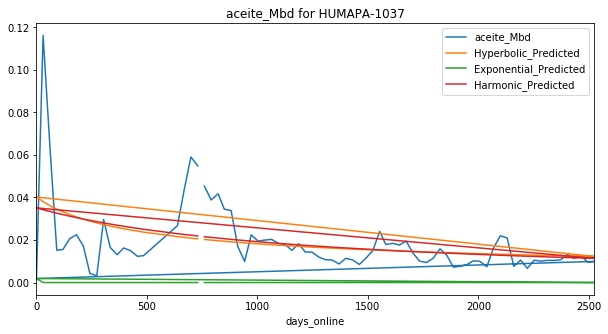

Exponential Fit Curve-fitted Variables: qi=0.040066999589975644, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.04876332044558341, b=1.5324680918883837, di=0.010506993184317148
Harmonic Fit Curve-fitted Variables: qi=0.04463750103586181, di=0.005740243181642712


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


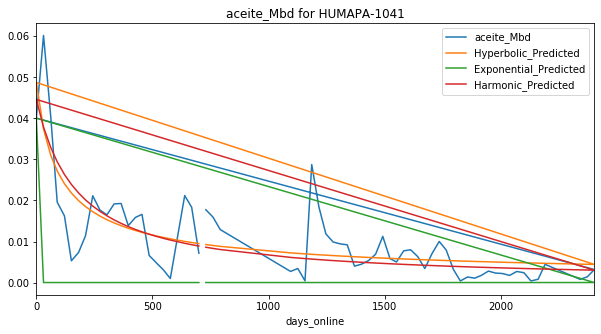

Exponential Fit Curve-fitted Variables: qi=0.0549580245934204, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.1549178663330735, b=0.666965454785505, di=0.009164112167033101
Harmonic Fit Curve-fitted Variables: qi=0.15085425945887, di=0.011143628000016708


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


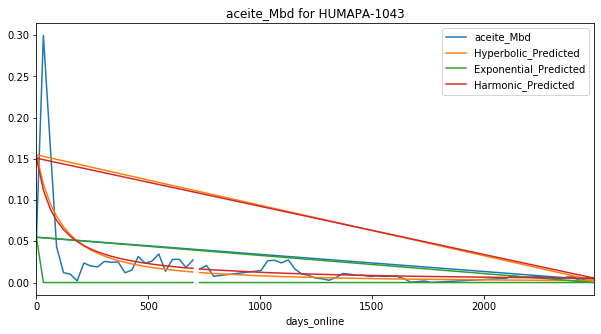

Exponential Fit Curve-fitted Variables: qi=0.07060598144531251, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.07067499751045594, b=1.999999999999996, di=0.049055005447009366
Harmonic Fit Curve-fitted Variables: qi=0.06763747193914094, di=0.016511745827285672


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


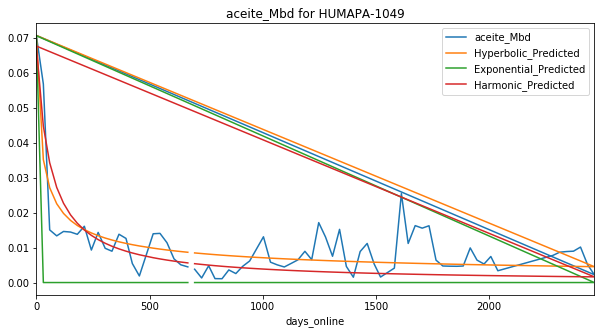

Exponential Fit Curve-fitted Variables: qi=0.022018004520783917, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.0330269851368638, b=1.9999999999606226, di=0.005036578198326452
Harmonic Fit Curve-fitted Variables: qi=0.02570603538740381, di=0.0014519716431941295


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


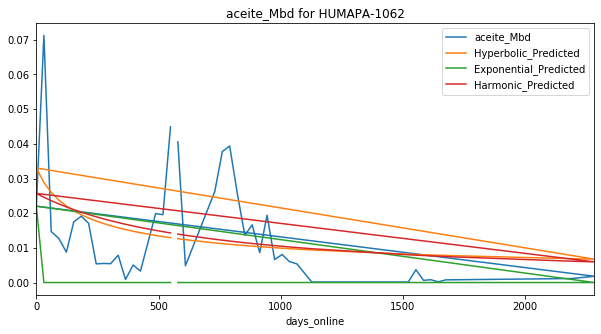

Exponential Fit Curve-fitted Variables: qi=0.010437017299082176, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.015061852068996396, b=4.842857308300487e-06, di=0.00018099210138007287
Harmonic Fit Curve-fitted Variables: qi=0.015368733951657061, di=0.0002340695111129739


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


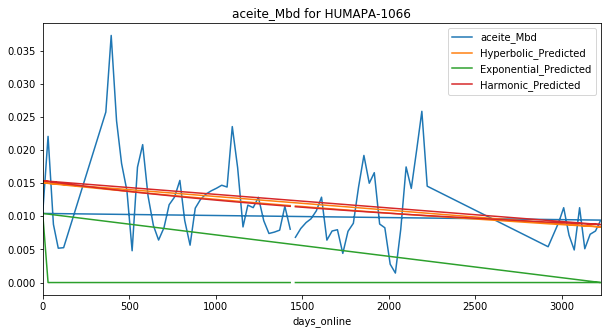

Exponential Fit Curve-fitted Variables: qi=0.36178365234375004, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.3618719999999973, b=0.9763125232922868, di=0.011874278546546529
Harmonic Fit Curve-fitted Variables: qi=0.36187199999999997, di=0.012148507097676169


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


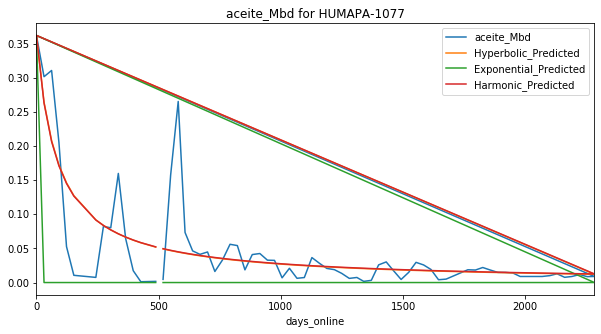

Exponential Fit Curve-fitted Variables: qi=0.07313187526275164, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.07187365841285076, b=1.2319975428364636, di=0.012247239827868248
Harmonic Fit Curve-fitted Variables: qi=0.06935402167152288, di=0.009292965014315232


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


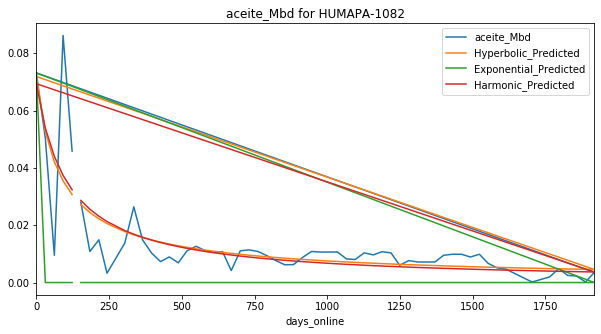

Exponential Fit Curve-fitted Variables: qi=0.087496470703125, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.08758199999982956, b=1.9999999999999998, di=0.010022103109275904
Harmonic Fit Curve-fitted Variables: qi=0.06494144943527672, di=0.0023629903248859386


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


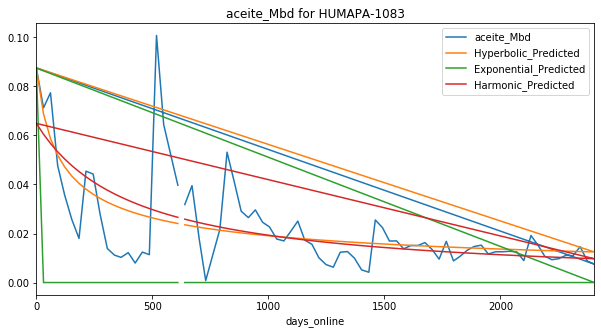

Exponential Fit Curve-fitted Variables: qi=0.013357134053020272, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.022274745043927974, b=0.2093558751718469, di=0.0015215879777956227
Harmonic Fit Curve-fitted Variables: qi=0.02351414161290868, di=0.002592935370686401


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


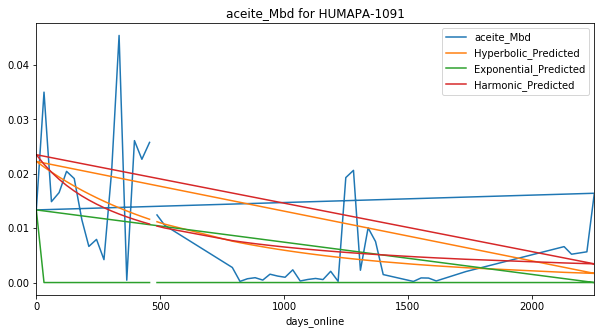

Exponential Fit Curve-fitted Variables: qi=0.0669555498046875, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.0645467033342049, b=1.9999999999999993, di=0.0552156298378121
Harmonic Fit Curve-fitted Variables: qi=0.0445758941497793, di=0.008259608998695678


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


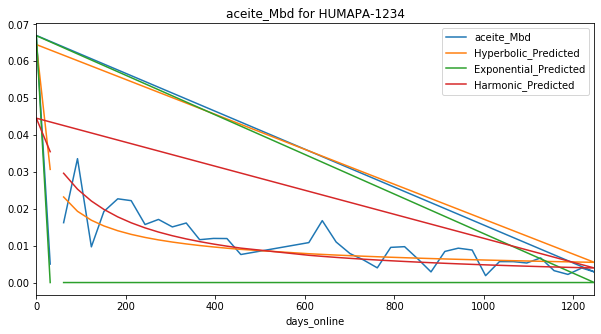

Exponential Fit Curve-fitted Variables: qi=0.07671600521786792, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.154074951903718, b=0.8474310375029496, di=0.009195058298557766
Harmonic Fit Curve-fitted Variables: qi=0.15324859916117803, di=0.01028804990086827


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


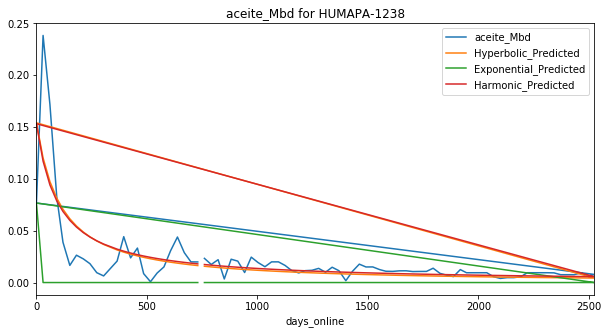

Exponential Fit Curve-fitted Variables: qi=0.019888915102363267, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.02518781377631068, b=1.5065868315726272, di=0.008416447844318033
Harmonic Fit Curve-fitted Variables: qi=0.02414639339559007, di=0.005293547798596328


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


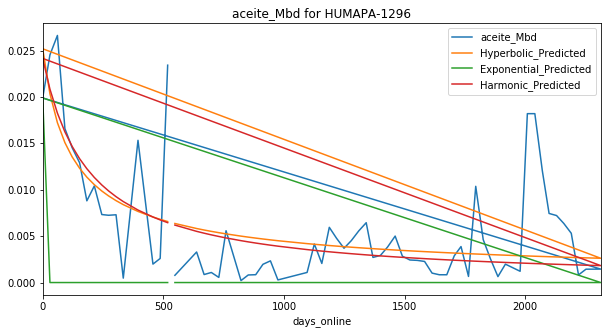

Exponential Fit Curve-fitted Variables: qi=0.009597160741004192, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.03216744119671319, b=1.0016452881598148, di=0.004438923226798366
Harmonic Fit Curve-fitted Variables: qi=0.03216185292711973, di=0.004432226423163526


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


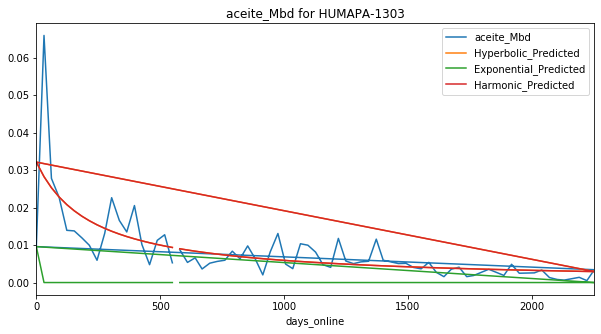

Exponential Fit Curve-fitted Variables: qi=0.016318957495335983, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.017661963331636304, b=1.999999999997618, di=0.003412566147174353
Harmonic Fit Curve-fitted Variables: qi=0.015683723870274068, di=0.0015906791352124747


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


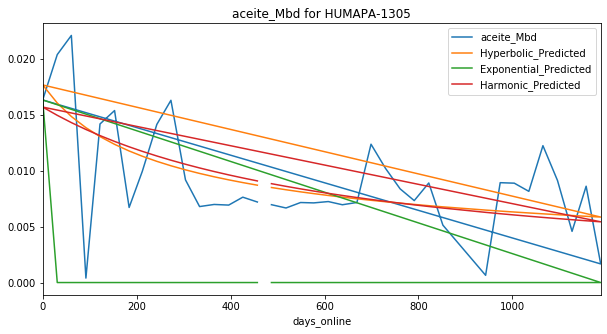

Exponential Fit Curve-fitted Variables: qi=0.011165393783932592, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.010561128595488087, b=1.2820078431969244e-14, di=0.0001845952516193971
Harmonic Fit Curve-fitted Variables: qi=0.010491880478002156, di=0.0002137584791474626


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


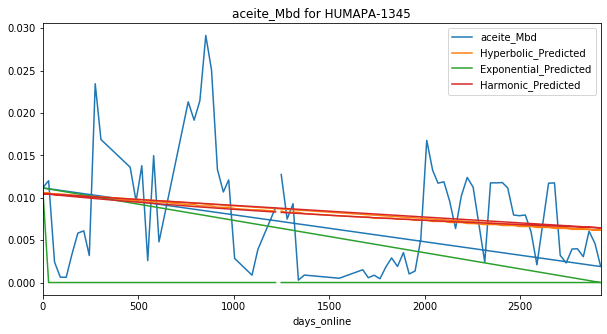

Exponential Fit Curve-fitted Variables: qi=0.038704257812500004, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.038779999999999724, b=1.6033643928307952, di=0.02679879645017403
Harmonic Fit Curve-fitted Variables: qi=0.03877999999999992, di=0.015354619066733927


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


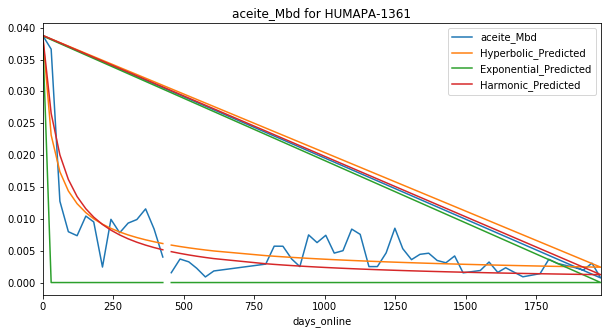

Exponential Fit Curve-fitted Variables: qi=0.023099496709871506, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.024009475670551905, b=1.9999999999999076, di=0.0048735704552430835
Harmonic Fit Curve-fitted Variables: qi=0.018383748481858798, di=0.0014083910979530829


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


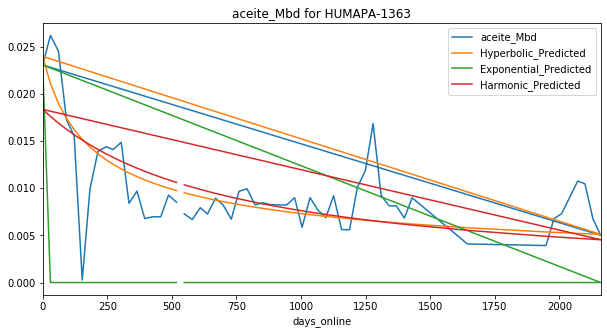

Exponential Fit Curve-fitted Variables: qi=0.013243001118090821, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.03643604012150104, b=0.6945853058960774, di=0.0015636644474615695
Harmonic Fit Curve-fitted Variables: qi=0.03671813575711934, di=0.00189955678253535


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


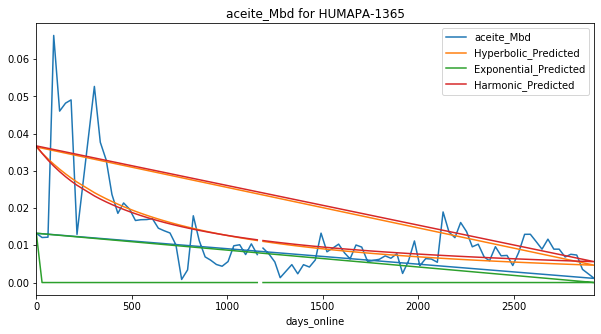

Exponential Fit Curve-fitted Variables: qi=0.01101828681226993, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.008493487060059927, b=6.780846146432068e-06, di=3.66661107971169e-21
Harmonic Fit Curve-fitted Variables: qi=0.008493487016190054, di=9.753692534583647e-16


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


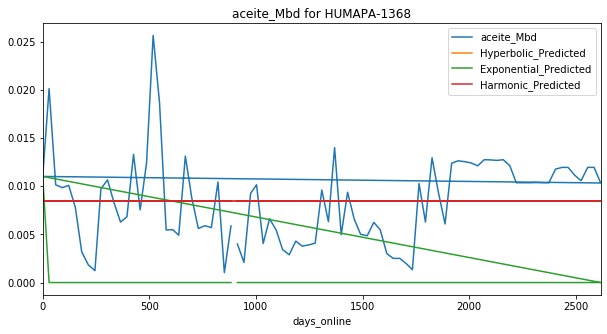

Exponential Fit Curve-fitted Variables: qi=0.038512983855694086, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.028327188544206006, b=1.0568631929813073, di=0.0015878448333700198
Harmonic Fit Curve-fitted Variables: qi=0.028053933269503804, di=0.0015026376133655502


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


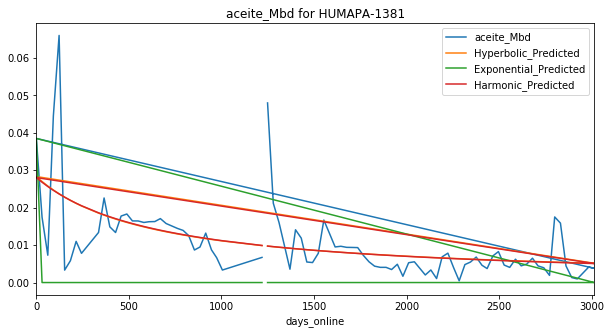

Exponential Fit Curve-fitted Variables: qi=0.02151315782598583, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.05356117376877808, b=0.06496806174553223, di=0.0011442794657182185
Harmonic Fit Curve-fitted Variables: qi=0.05586456103181765, di=0.0021636486716711486


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


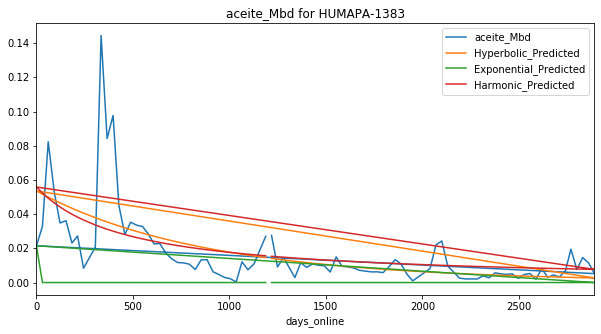

Exponential Fit Curve-fitted Variables: qi=0.03115303515625, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.024246145988707644, b=0.3576497697414856, di=0.0006235337142380732
Harmonic Fit Curve-fitted Variables: qi=0.024746008677914957, di=0.0008462308822223245


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


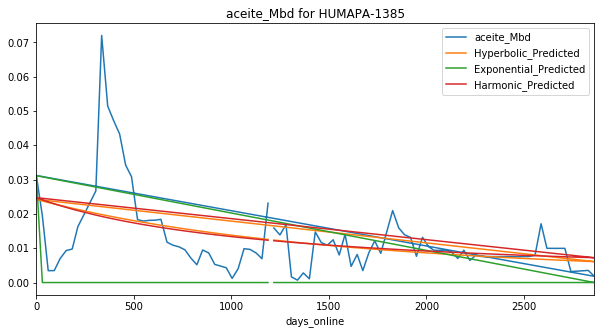

Exponential Fit Curve-fitted Variables: qi=0.0075109274827942435, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.013512002472770446, b=3.5045182294329846e-09, di=0.000795344055608219
Harmonic Fit Curve-fitted Variables: qi=0.013088685952481353, di=0.0008198060794297028


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


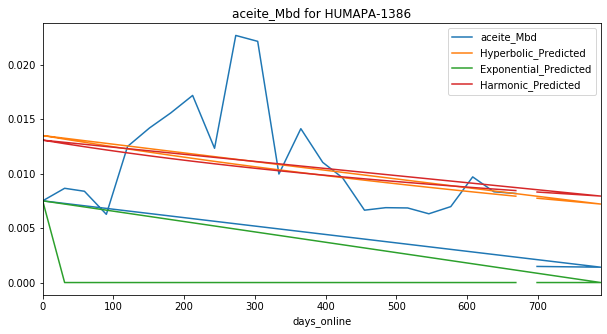

Exponential Fit Curve-fitted Variables: qi=0.0034800765404437643, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.019867648138584073, b=1.3331106195378242, di=0.0008438910092976378
Harmonic Fit Curve-fitted Variables: qi=0.019718629374230072, di=0.0007384847927440169


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


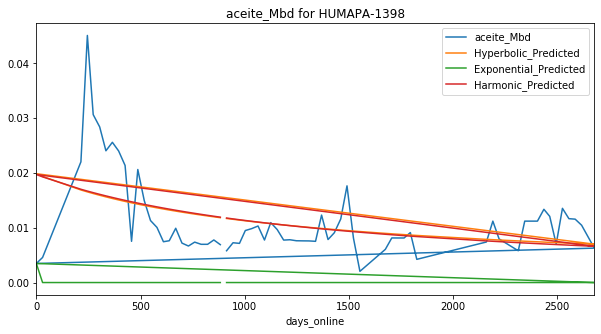

Exponential Fit Curve-fitted Variables: qi=0.011976562886244255, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.013590128404073075, b=0.29558752413702405, di=0.002479198147384754
Harmonic Fit Curve-fitted Variables: qi=0.014015347011403952, di=0.0038200474316195587


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


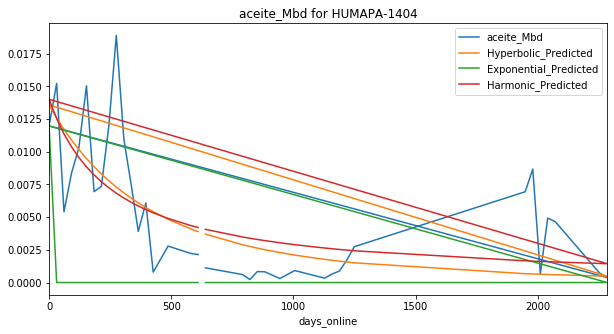

Exponential Fit Curve-fitted Variables: qi=0.03351840625, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.02948456675905659, b=1.9999999999999998, di=0.018494254410492492
Harmonic Fit Curve-fitted Variables: qi=0.010022726665230072, di=0.0002923924464575873


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


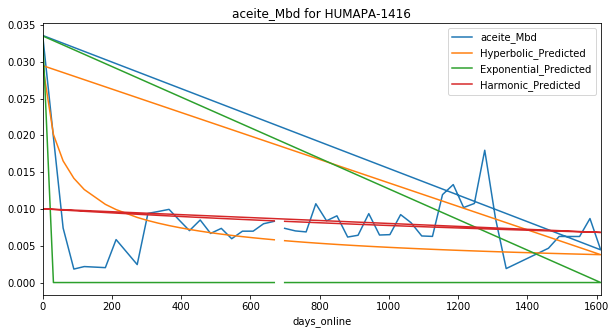

Exponential Fit Curve-fitted Variables: qi=0.04468655078125, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.04206234817647038, b=1.9999999999999856, di=0.013493347228614517
Harmonic Fit Curve-fitted Variables: qi=0.03181712940955367, di=0.003291412304502145


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


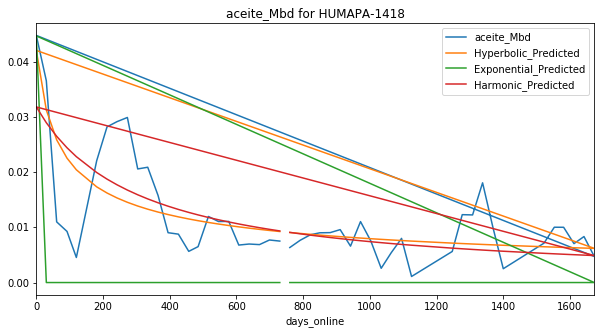

Exponential Fit Curve-fitted Variables: qi=0.019967695312500002, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.018258239500643297, b=1.9999999782732532, di=0.009482788809368646
Harmonic Fit Curve-fitted Variables: qi=0.015905224562807147, di=0.0036286537458466253


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


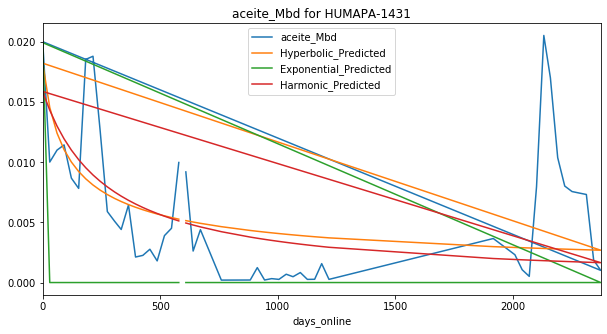

Exponential Fit Curve-fitted Variables: qi=0.0735590947265625, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.07363099999999997, b=1.2840377937758716, di=0.015830836225213023
Harmonic Fit Curve-fitted Variables: qi=0.07363099981306154, di=0.012811329143947623


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


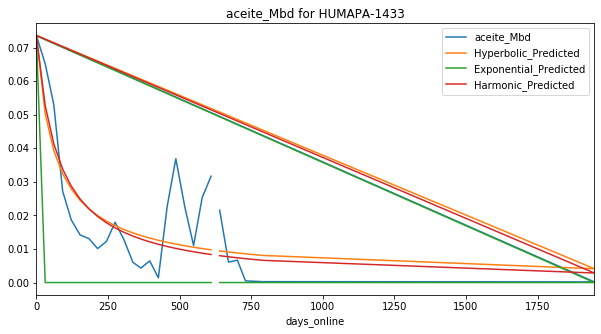

Exponential Fit Curve-fitted Variables: qi=0.0314225078125, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.017316868123341884, b=1.4564898131043422, di=0.0012801289601921887
Harmonic Fit Curve-fitted Variables: qi=0.016981192405472127, di=0.0010380323268536235


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


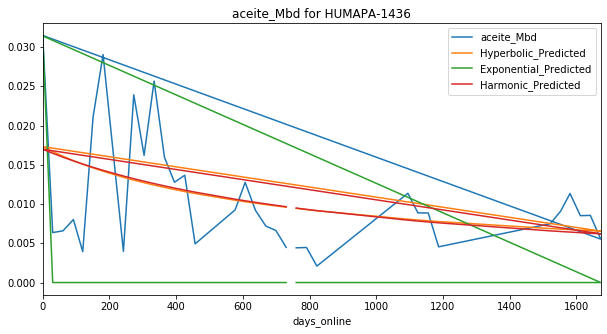

Exponential Fit Curve-fitted Variables: qi=0.023876367187500004, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.01388558872156416, b=1.9999999999889837, di=0.0006515328453234442
Harmonic Fit Curve-fitted Variables: qi=0.013161022387067633, di=0.0004118881195882554


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


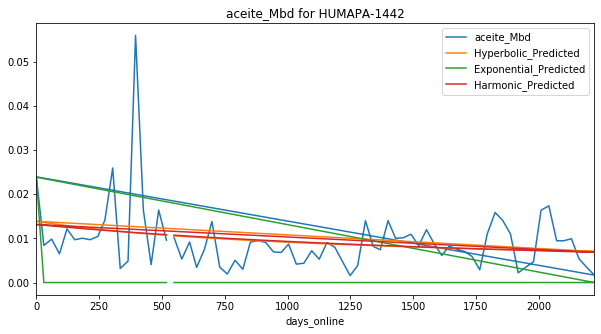

Exponential Fit Curve-fitted Variables: qi=0.0021460327220354397, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.009216840213605778, b=1.896365088972424e-07, di=0.0003432650663623681
Harmonic Fit Curve-fitted Variables: qi=0.009190938697803996, di=0.0004296767055177128


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


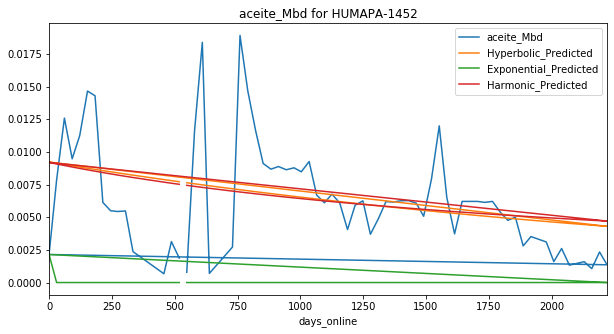

Exponential Fit Curve-fitted Variables: qi=0.07317746777343749, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.07317090257231453, b=1.9999999999999998, di=0.09366851314170696
Harmonic Fit Curve-fitted Variables: qi=0.07001041289217903, di=0.029100889345410927


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


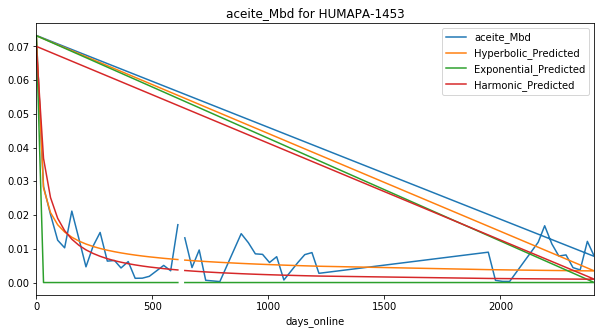

Exponential Fit Curve-fitted Variables: qi=0.006206002545853645, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.024605315076372647, b=1.999999999987187, di=0.002202739553809166
Harmonic Fit Curve-fitted Variables: qi=0.022677981678676705, di=0.0011188308038595123


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


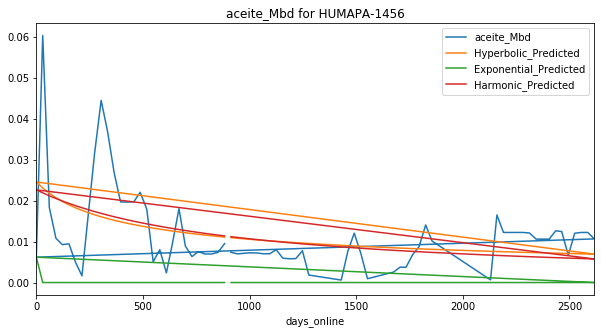

Exponential Fit Curve-fitted Variables: qi=0.051669492187500006, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.04638112736199806, b=1.9999999999999998, di=0.034309011518666055
Harmonic Fit Curve-fitted Variables: qi=0.021168863698166316, di=0.0019492004025631457


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


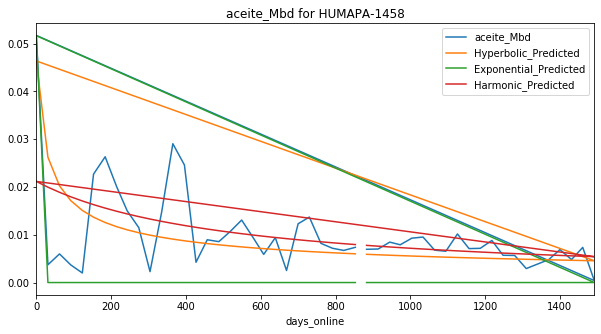

Exponential Fit Curve-fitted Variables: qi=0.01803626953125, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.01231552378475059, b=3.536842561979976e-05, di=0.0007138636228130655
Harmonic Fit Curve-fitted Variables: qi=0.013623013462051607, di=0.0014399158084565879


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


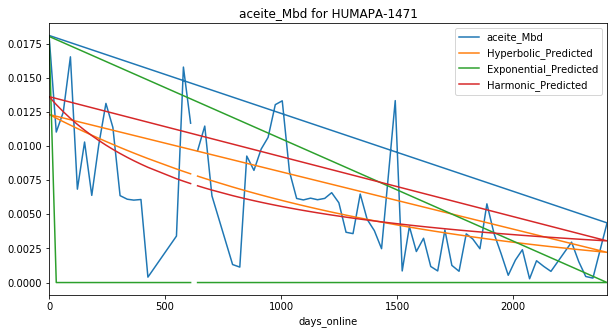

Exponential Fit Curve-fitted Variables: qi=0.047012998046875004, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.028872618588572953, b=1.6925074696777928e-07, di=0.001797653722865038
Harmonic Fit Curve-fitted Variables: qi=0.02978755307210564, di=0.002871764943815599


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


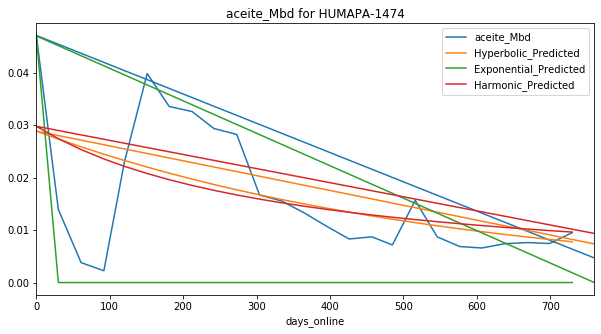

Exponential Fit Curve-fitted Variables: qi=0.023170982023413816, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.024016766559975568, b=1.9999999999994245, di=0.009688108656220752
Harmonic Fit Curve-fitted Variables: qi=0.015258596154390165, di=0.0016432076622602675


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


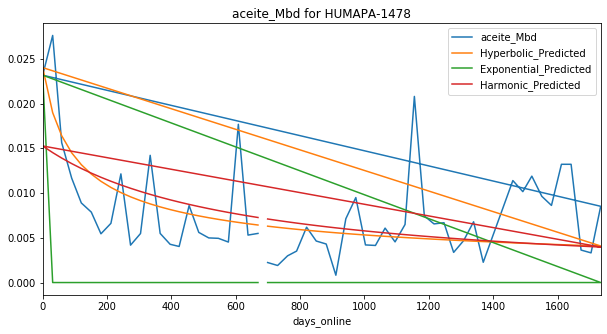

Exponential Fit Curve-fitted Variables: qi=0.00670426565462176, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.019672559084387864, b=1.9999999999996363, di=0.004059052866095609
Harmonic Fit Curve-fitted Variables: qi=0.014942341165823294, di=0.0010812285573935198


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


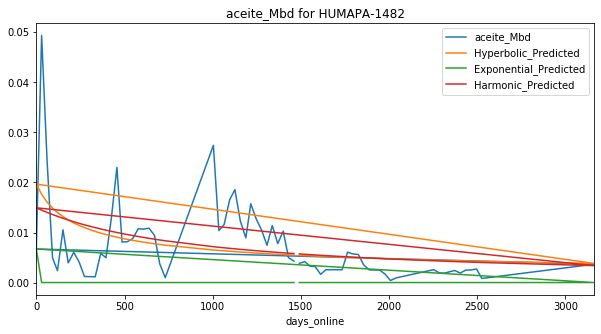

Exponential Fit Curve-fitted Variables: qi=0.0020420431313396964, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.025321609356291633, b=1.5162357507669058, di=0.0040073985430282184
Harmonic Fit Curve-fitted Variables: qi=0.022808515601414517, di=0.002190680697424558


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


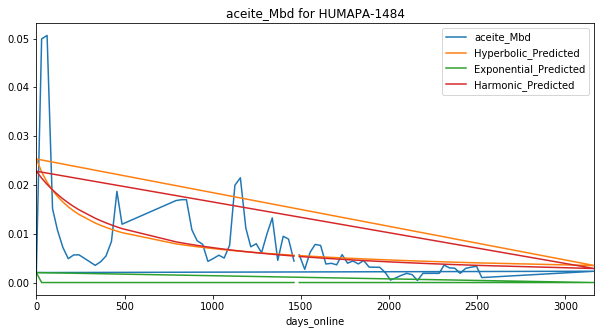

Exponential Fit Curve-fitted Variables: qi=0.00258604374643131, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.006490023065574185, b=1.9999999999999998, di=9.389614572543817e-12
Harmonic Fit Curve-fitted Variables: qi=0.00649002240330092, di=9.630229639996612e-12


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


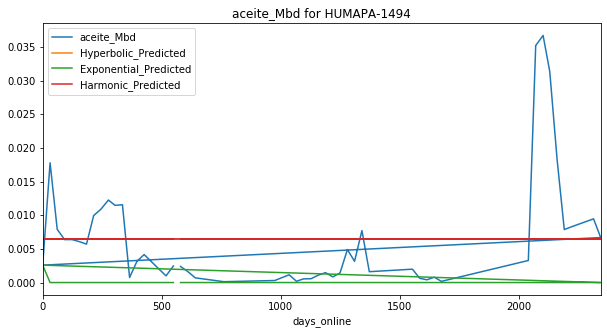

Exponential Fit Curve-fitted Variables: qi=0.17334731640625, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.17343199999999998, b=1.1912876180174363, di=0.03729373768070944
Harmonic Fit Curve-fitted Variables: qi=0.17343199999999998, di=0.030575665184215412


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


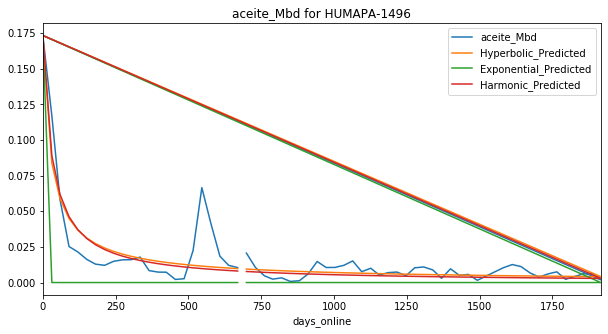

Exponential Fit Curve-fitted Variables: qi=0.014851999751128817, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.017412202344473653, b=1.9999999999999998, di=0.0009163088732521042
Harmonic Fit Curve-fitted Variables: qi=0.013769845928231425, di=0.00026372129370735495


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


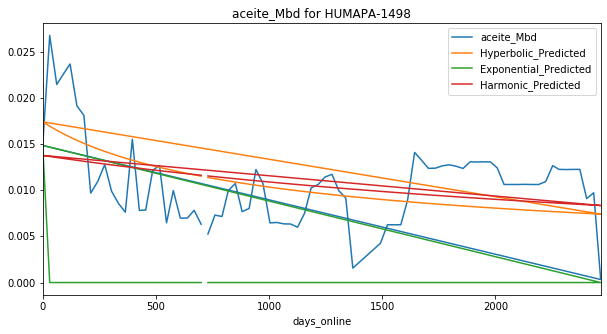

Exponential Fit Curve-fitted Variables: qi=0.005239103501430698, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.025948460267161667, b=0.16689531851920855, di=0.000722950333638329
Harmonic Fit Curve-fitted Variables: qi=0.026560134376255946, di=0.001131554406890285


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


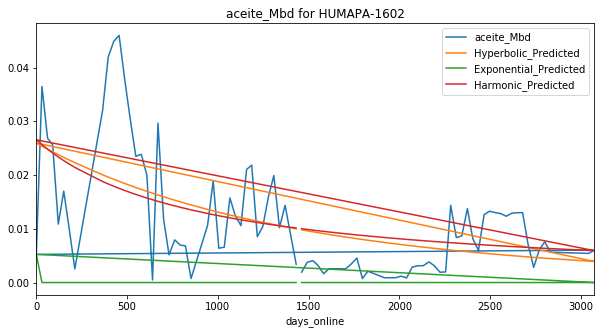

Exponential Fit Curve-fitted Variables: qi=0.0038839506420011716, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.004286428301836211, b=1.999999999977512, di=6.29670295024931e-17
Harmonic Fit Curve-fitted Variables: qi=0.004286420545837624, di=4.6045081929417664e-10


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


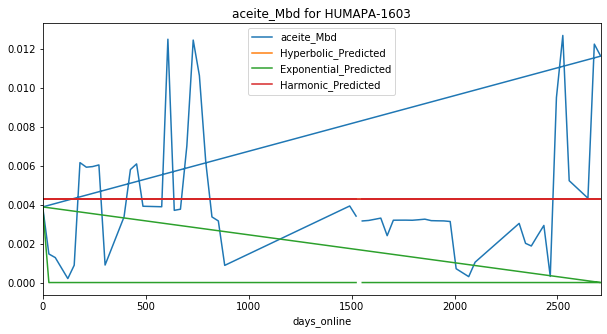

Exponential Fit Curve-fitted Variables: qi=0.015915585937499997, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.00833712471766459, b=0.0022043807742226917, di=2.8515199590979806e-14
Harmonic Fit Curve-fitted Variables: qi=0.008337119356611113, di=6.716811433311072e-13


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


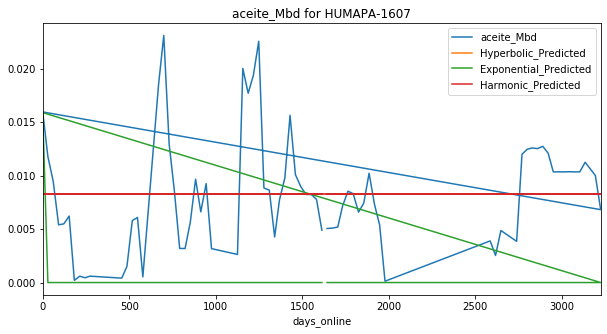

Exponential Fit Curve-fitted Variables: qi=0.024875010874189023, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.03676588818518021, b=1.1201606385840455, di=0.0024925535357774808
Harmonic Fit Curve-fitted Variables: qi=0.03636332906893472, di=0.0022760001981940356


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


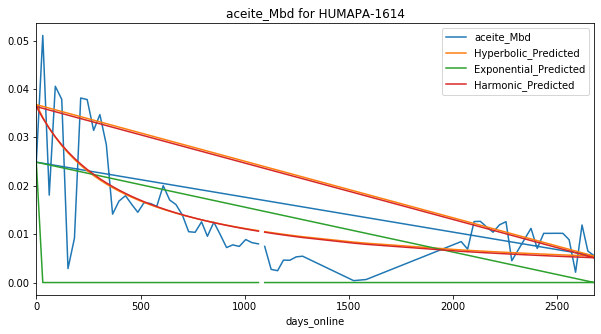

Exponential Fit Curve-fitted Variables: qi=0.027586015625, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.025069370739137516, b=1.9999999999999998, di=0.012357980521074825
Harmonic Fit Curve-fitted Variables: qi=0.017948141810887643, di=0.0027333475684153978


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


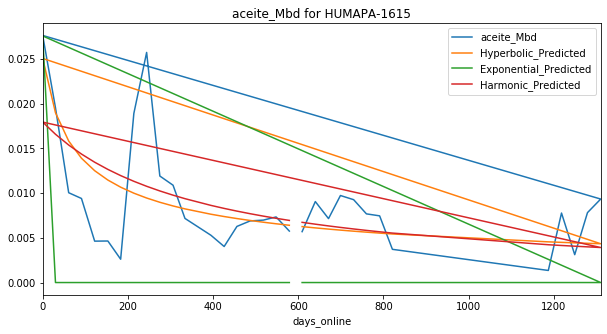

Exponential Fit Curve-fitted Variables: qi=0.043707466796875, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.043792999999989014, b=1.7521199307050905, di=0.04512857349659034
Harmonic Fit Curve-fitted Variables: qi=0.04379299999999999, di=0.025039808741277005


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


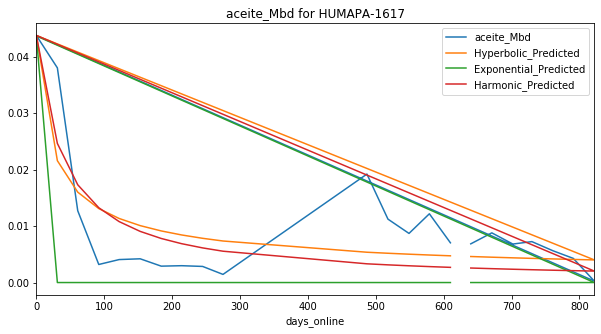

Exponential Fit Curve-fitted Variables: qi=0.03333499289881312, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.026200644510436875, b=0.612989478713383, di=0.0010611132224127894
Harmonic Fit Curve-fitted Variables: qi=0.02686473674546917, di=0.0013413444172729126


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


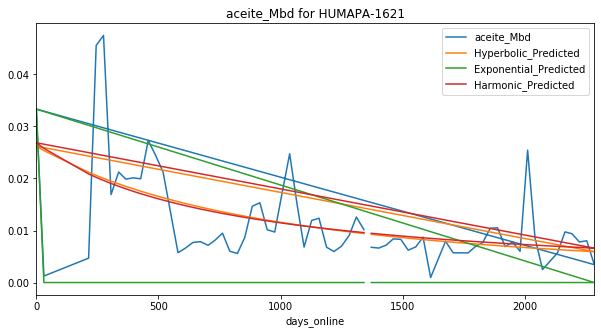

Exponential Fit Curve-fitted Variables: qi=0.12828099998994846, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.2030660241677792, b=0.4538762366590086, di=0.0052032104766413165
Harmonic Fit Curve-fitted Variables: qi=0.2059766839253124, di=0.008193644167432264


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


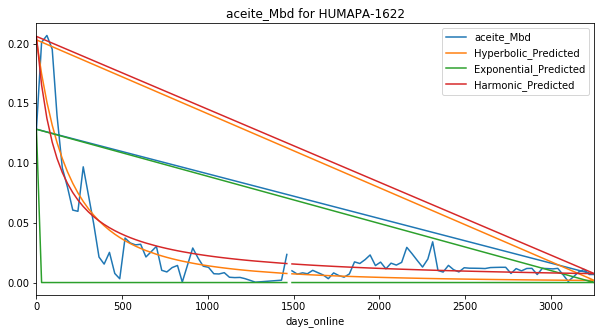

Exponential Fit Curve-fitted Variables: qi=0.014706000036712876, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.0637279999979056, b=1.2888062845352919e-11, di=0.0009220644789197682
Harmonic Fit Curve-fitted Variables: qi=0.06372799999999994, di=0.0014975467201438306


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


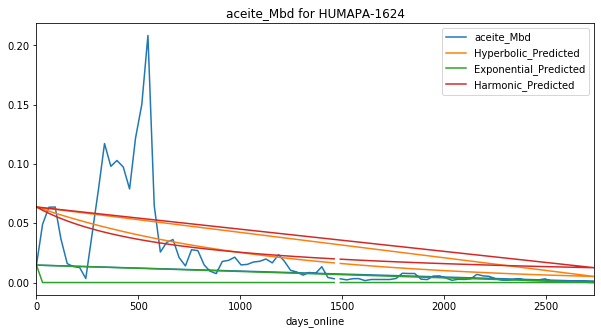

Exponential Fit Curve-fitted Variables: qi=0.056133966709487934, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.04582612817328603, b=5.972652703317944e-08, di=0.001205725815529772
Harmonic Fit Curve-fitted Variables: qi=0.05068788839652892, di=0.0026447128052430437


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


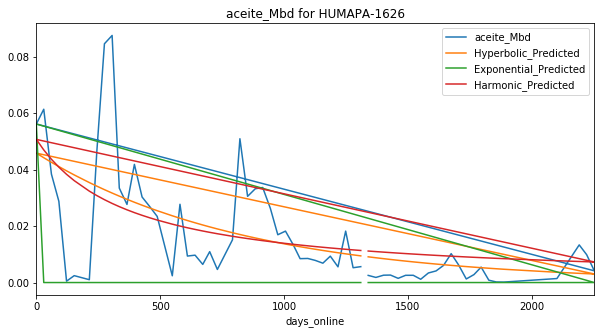

Exponential Fit Curve-fitted Variables: qi=0.024243925781249998, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.013000382755372502, b=1.9999999999999998, di=0.0005545002062247378
Harmonic Fit Curve-fitted Variables: qi=0.011540979059245953, di=0.0002631096117664198


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


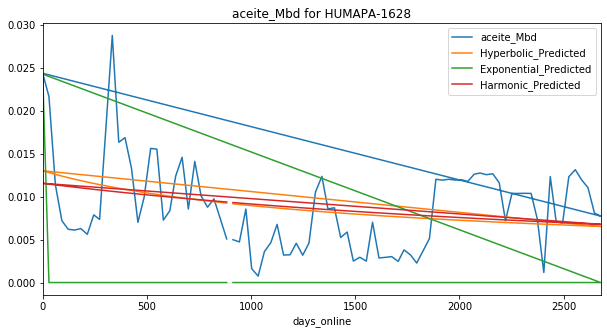

Exponential Fit Curve-fitted Variables: qi=0.03361528035154917, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.08494287765151426, b=5.417966231498796e-08, di=0.0016121822140959204
Harmonic Fit Curve-fitted Variables: qi=0.08998774207304165, di=0.0032357298545618797


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


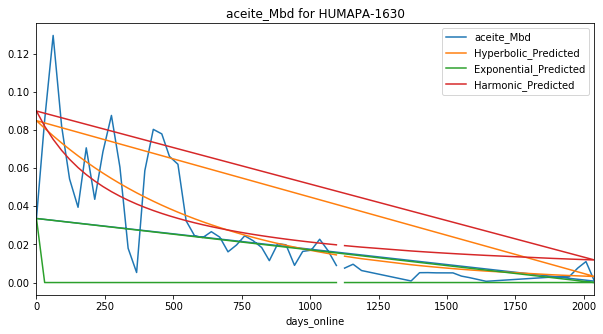

Exponential Fit Curve-fitted Variables: qi=0.022184547442691358, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.028612253363924256, b=1.999999999999426, di=0.0052964298888594314
Harmonic Fit Curve-fitted Variables: qi=0.01771570457539295, di=0.0008463556841045962


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


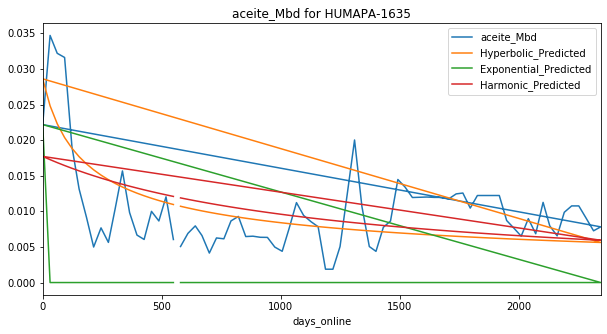

Exponential Fit Curve-fitted Variables: qi=0.015883998743357223, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.02112853156737589, b=0.12714338388221136, di=0.0021826468179438297
Harmonic Fit Curve-fitted Variables: qi=0.02206865064252722, di=0.0035746618806769223


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


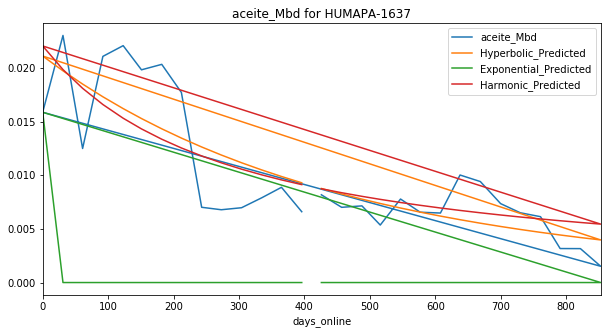

Exponential Fit Curve-fitted Variables: qi=0.012463003644550497, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.012347048705982277, b=3.14816013263899e-05, di=0.00021479343736288887
Harmonic Fit Curve-fitted Variables: qi=0.01228363552514566, di=0.00024035897537440516


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


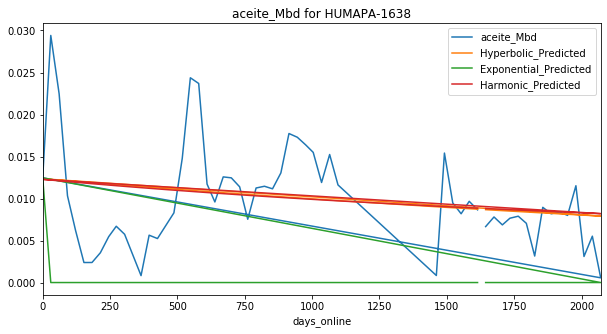

Exponential Fit Curve-fitted Variables: qi=0.007140001869763026, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.00968035771204128, b=5.289669974236935e-06, di=1.6834192848620182e-05
Harmonic Fit Curve-fitted Variables: qi=0.009664542762584657, di=1.5896603774213482e-05


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


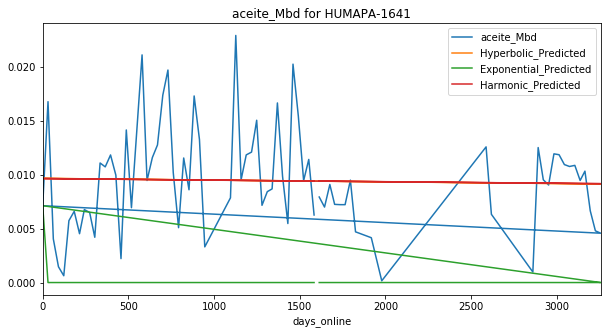

Exponential Fit Curve-fitted Variables: qi=0.02217200637705303, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.03469690800934482, b=3.696150942453928e-07, di=0.0005653737207605496
Harmonic Fit Curve-fitted Variables: qi=0.03551043677113385, di=0.0008661118888030862


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


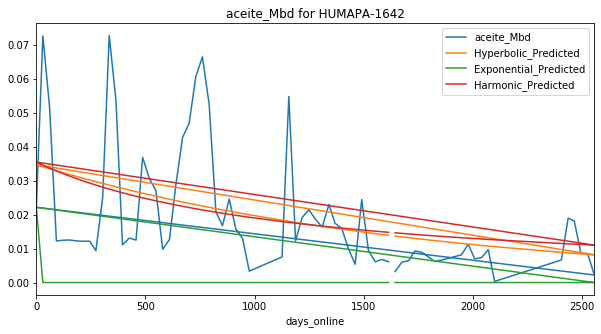

Exponential Fit Curve-fitted Variables: qi=0.035218080078125, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.01273678857859994, b=1.999999999999989, di=0.0002620957989399777
Harmonic Fit Curve-fitted Variables: qi=0.012426254424146722, di=0.00019401690052912247


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


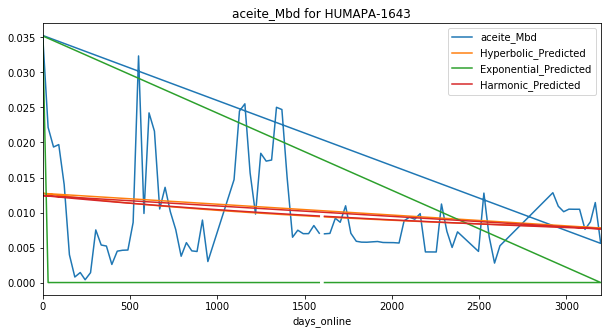

Exponential Fit Curve-fitted Variables: qi=0.08549099999442045, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.1468577918332408, b=4.904520885251045e-08, di=0.0013317856132010297
Harmonic Fit Curve-fitted Variables: qi=0.15977635538302085, di=0.003036122540266604


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


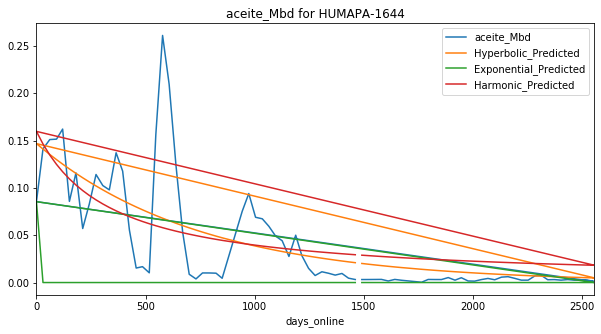

Exponential Fit Curve-fitted Variables: qi=0.19336656474562897, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.19674999999999807, b=1.0902532723584226, di=0.02175462107455538
Harmonic Fit Curve-fitted Variables: qi=0.19674999999999998, di=0.01994937751360954


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


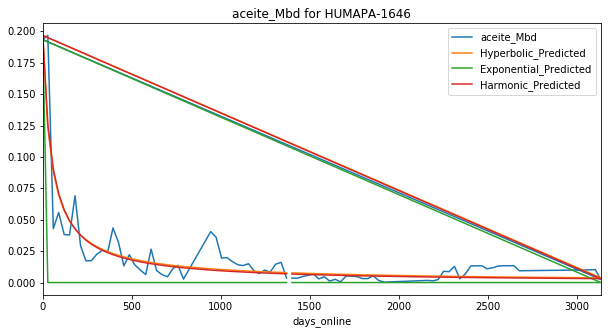

Exponential Fit Curve-fitted Variables: qi=0.06090999985323555, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.07763870939527208, b=0.5479172049611836, di=0.005107790719160304
Harmonic Fit Curve-fitted Variables: qi=0.0815087118766113, di=0.007973989871688453


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


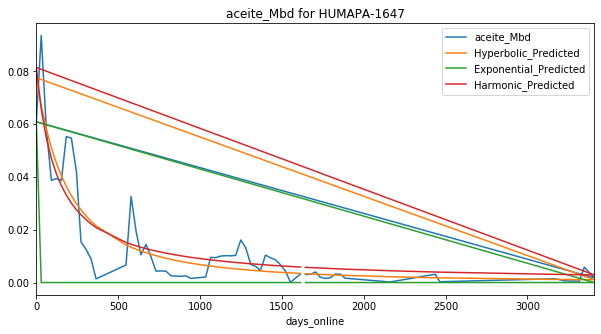

Exponential Fit Curve-fitted Variables: qi=0.06066899975119672, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.0844264839871458, b=0.791689707966033, di=0.004823694735177427
Harmonic Fit Curve-fitted Variables: qi=0.08580732559428458, di=0.005773980827373593


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


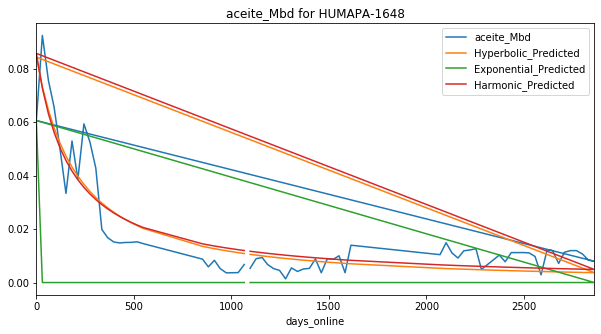

Exponential Fit Curve-fitted Variables: qi=0.0011741168997270778, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.0071924578358850706, b=1.0293760609217744e-08, di=0.0007143435148464005
Harmonic Fit Curve-fitted Variables: qi=0.006814201123494905, di=0.0008753517044818684


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


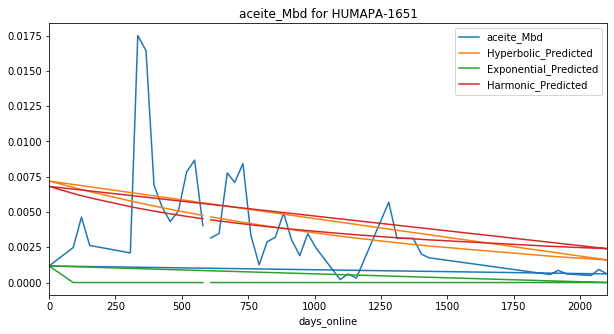

Exponential Fit Curve-fitted Variables: qi=0.013785978094910037, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.01873869822386255, b=1.4865503117513573e-05, di=0.005575315682822435
Harmonic Fit Curve-fitted Variables: qi=0.01889354054589156, di=0.008725373623241477


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


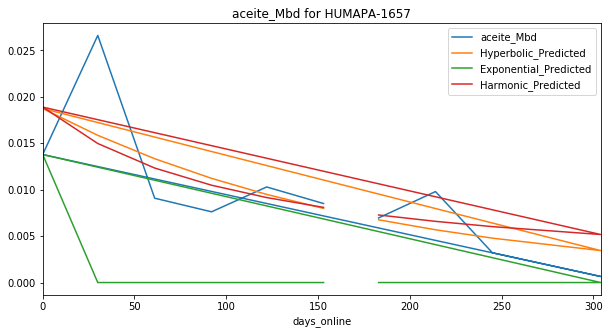

Exponential Fit Curve-fitted Variables: qi=0.019584000384215393, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.008929494979300973, b=1.9999999999999998, di=3.2556855704551386e-13
Harmonic Fit Curve-fitted Variables: qi=0.00892949522816064, di=8.388355739267052e-15


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


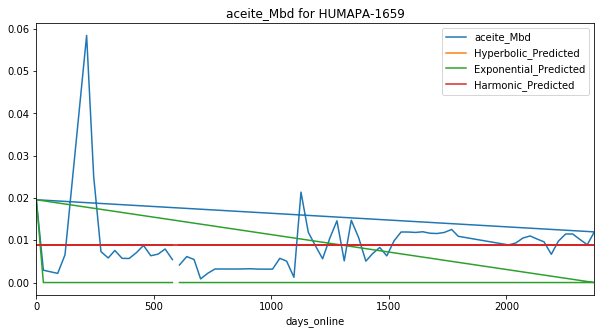

Exponential Fit Curve-fitted Variables: qi=0.008372003860431635, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.008860600561301954, b=1.987130053154974, di=2.5517015714357024e-12
Harmonic Fit Curve-fitted Variables: qi=0.008860601177732307, di=5.756246607679443e-10


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


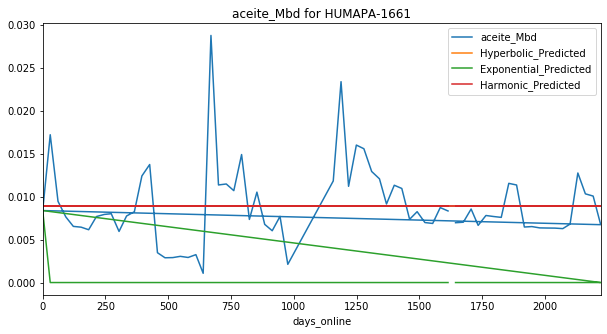

Exponential Fit Curve-fitted Variables: qi=0.0021684601233828617, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.010174124693286612, b=3.177239215513705e-13, di=9.914285211083935e-05
Harmonic Fit Curve-fitted Variables: qi=0.010117955850065835, di=0.00010472570470575023


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


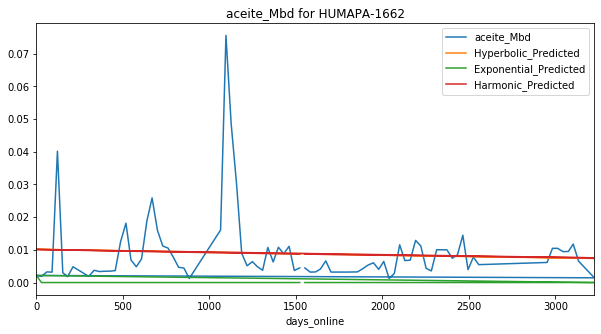

Exponential Fit Curve-fitted Variables: qi=0.011433265079704831, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.024570999996753138, b=4.1512231806578007e-07, di=0.0004159994573006192
Harmonic Fit Curve-fitted Variables: qi=0.024570999999999992, di=0.0005949045234024551


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


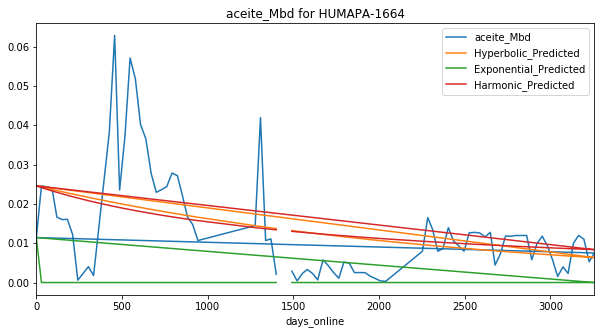

Exponential Fit Curve-fitted Variables: qi=0.0020111012818499543, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.010521080741115426, b=0.011569683251166474, di=2.5250596798181416e-15
Harmonic Fit Curve-fitted Variables: qi=0.010521076844172477, di=3.9133904395199835e-14


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


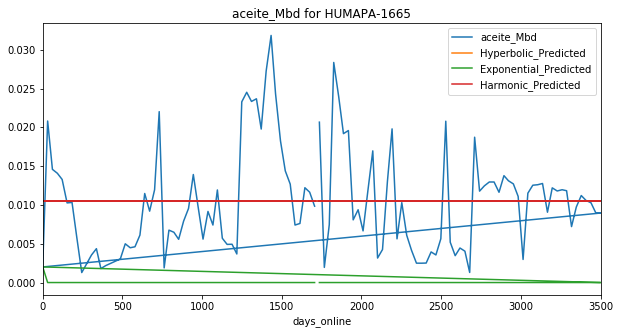

Exponential Fit Curve-fitted Variables: qi=0.006808012041290704, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.026099383739796287, b=0.057977505679902765, di=0.0003239403176501498
Harmonic Fit Curve-fitted Variables: qi=0.027073937862513504, di=0.0004721386799908392


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


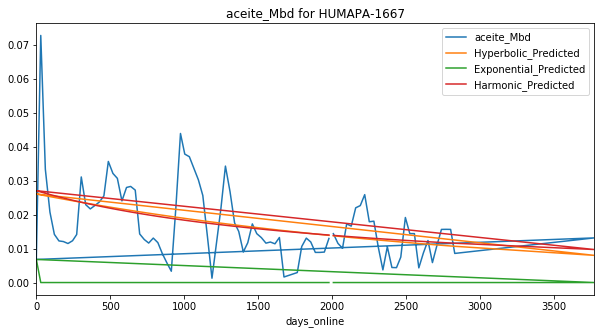

Exponential Fit Curve-fitted Variables: qi=0.037912001124512984, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.06907529698713549, b=0.9692995697265278, di=0.0045491217275333475
Harmonic Fit Curve-fitted Variables: qi=0.06933568248944427, di=0.004690596038526796


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


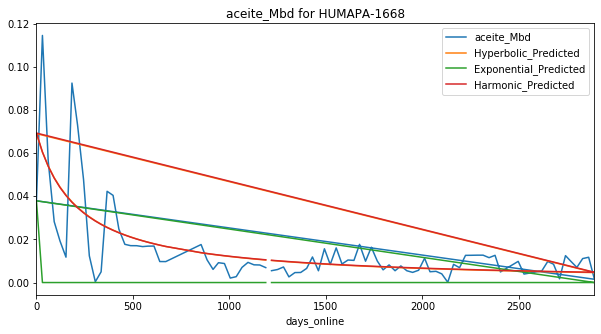

Exponential Fit Curve-fitted Variables: qi=0.038258130859374996, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.017098575964766865, b=1.9999999999999998, di=0.0007607930597149196
Harmonic Fit Curve-fitted Variables: qi=0.015291017773285313, di=0.00037464182220651543


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


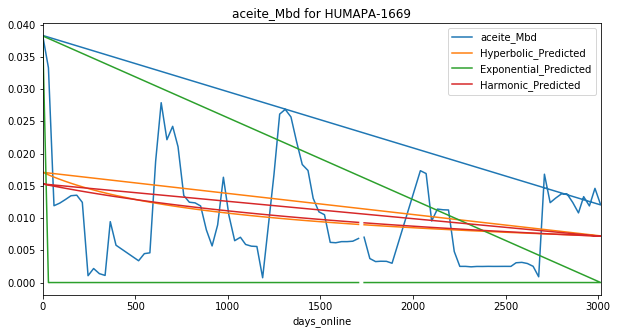

Exponential Fit Curve-fitted Variables: qi=0.007778000981914975, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.019521575554858762, b=1.5405202485580518, di=0.004606531955979142
Harmonic Fit Curve-fitted Variables: qi=0.01904422399980989, di=0.0033898702353779057


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


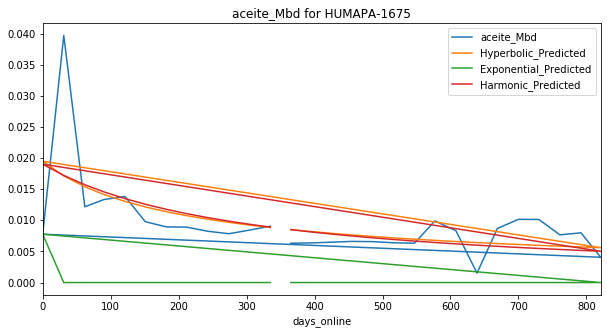

Exponential Fit Curve-fitted Variables: qi=0.016583235523732972, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.019187538461824912, b=0.524660753803312, di=0.0033060599116044374
Harmonic Fit Curve-fitted Variables: qi=0.020066649556832433, di=0.004783277973514244


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


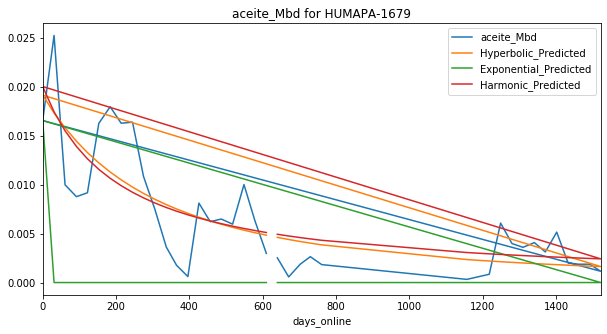

Exponential Fit Curve-fitted Variables: qi=0.030409490234375, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.01482363467502111, b=1.9999999999622204, di=0.0007102591579118898
Harmonic Fit Curve-fitted Variables: qi=0.014018667289595246, di=0.000419405889984302


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


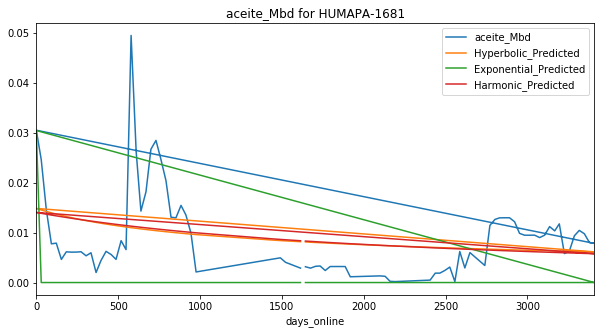

Exponential Fit Curve-fitted Variables: qi=0.044926082031249995, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.0446531842768394, b=1.9999999999999998, di=0.04313096841659503
Harmonic Fit Curve-fitted Variables: qi=0.04050678279647736, di=0.015390412717334954


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


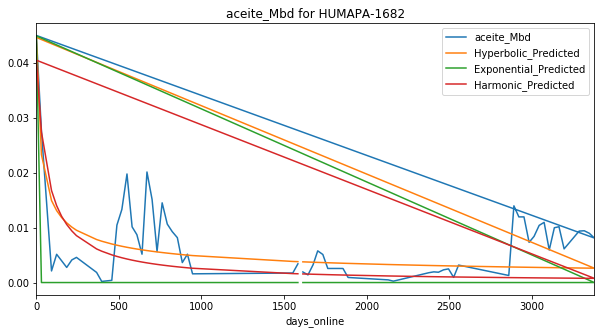

Exponential Fit Curve-fitted Variables: qi=0.04445896578094045, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.05405017786014719, b=1.9999999999920732, di=0.006831533468957613
Harmonic Fit Curve-fitted Variables: qi=0.046688602592024675, di=0.002513664935005019


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


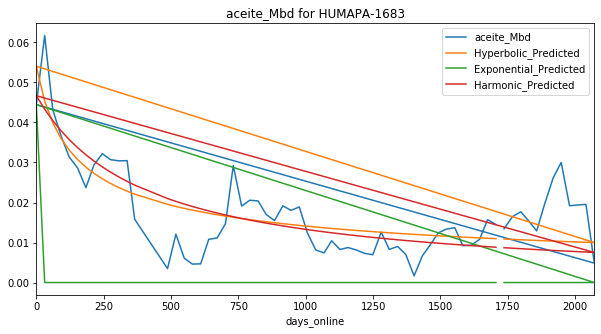

Exponential Fit Curve-fitted Variables: qi=0.007615010192407892, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.010723522052435097, b=4.049058951292306e-09, di=5.008115201099456e-05
Harmonic Fit Curve-fitted Variables: qi=0.010707760254390882, di=5.206319510893533e-05


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


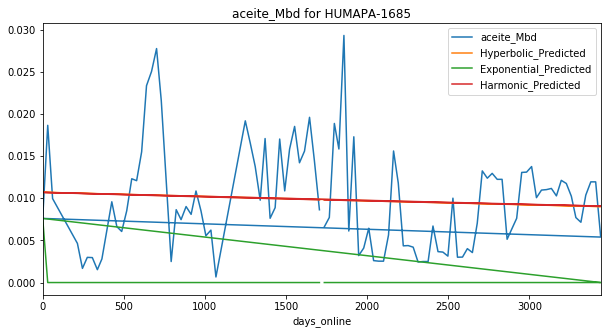

Exponential Fit Curve-fitted Variables: qi=0.07634500000068785, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.1464206084219822, b=0.3265429105567387, di=0.0036414451336148077
Harmonic Fit Curve-fitted Variables: qi=0.1505251771747184, di=0.006352827933507612


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


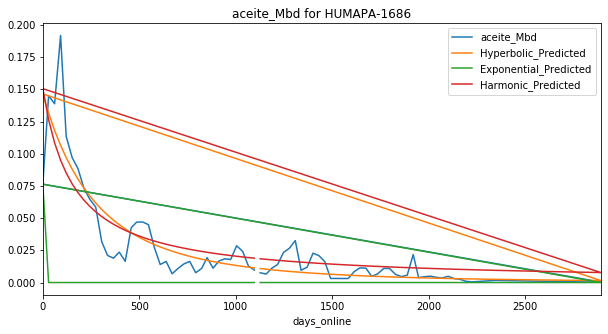

Exponential Fit Curve-fitted Variables: qi=0.042307934600978814, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.036644022970521176, b=1.9999999999999998, di=0.0029761238835555055
Harmonic Fit Curve-fitted Variables: qi=0.02304041990813983, di=0.00048159572308660993


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


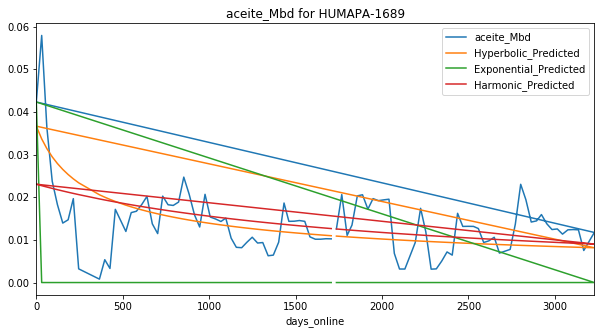

Exponential Fit Curve-fitted Variables: qi=0.010941001168802703, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.0258457498767773, b=0.324687287951164, di=0.001969108023321462
Harmonic Fit Curve-fitted Variables: qi=0.028901765257925652, di=0.0038122921974062833


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


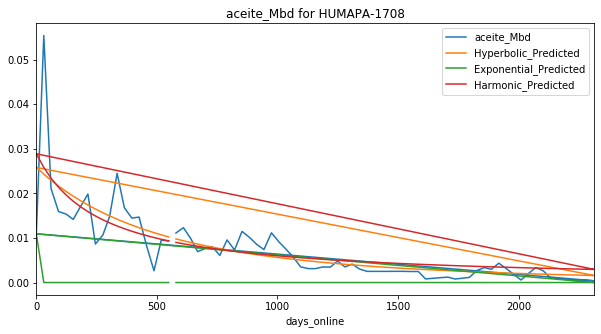

Exponential Fit Curve-fitted Variables: qi=0.03651516604602873, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.07048038133116126, b=2.0242308740344743e-09, di=0.0011772229288358627
Harmonic Fit Curve-fitted Variables: qi=0.07629112212183418, di=0.002287137849443518


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


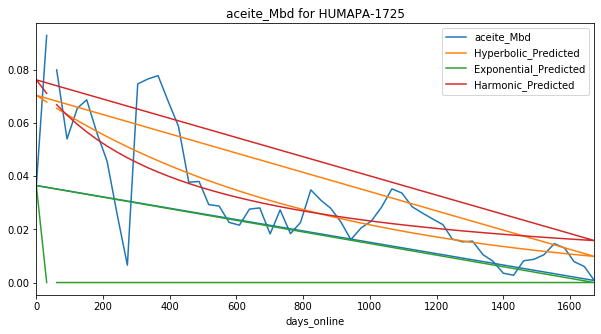

Exponential Fit Curve-fitted Variables: qi=0.05788297116476001, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.06731081894194187, b=1.0495420201741792, di=0.010402568640678178
Harmonic Fit Curve-fitted Variables: qi=0.06710802001091475, di=0.009962713258477992


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


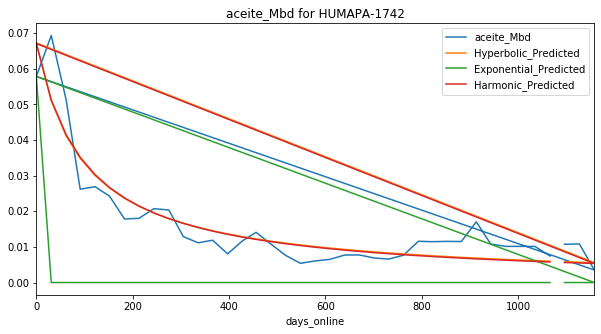

Exponential Fit Curve-fitted Variables: qi=0.020928016395842308, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.034816607499851486, b=1.99999999999999, di=0.0018764600415750062
Harmonic Fit Curve-fitted Variables: qi=0.02996093905763335, di=0.000788916913903158


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


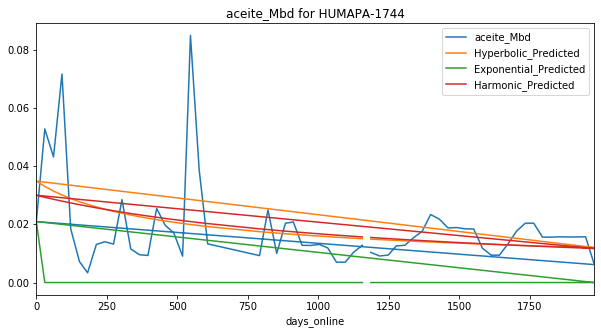

Exponential Fit Curve-fitted Variables: qi=0.010490024551315286, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.01265624394477361, b=1.0836186884600961e-06, di=0.00011284137157486743
Harmonic Fit Curve-fitted Variables: qi=0.012624323705098873, di=0.00012299167752468358


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


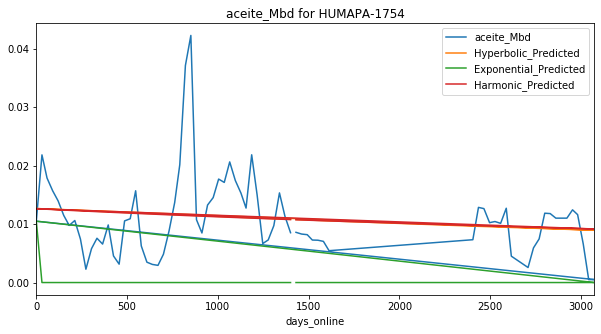

Exponential Fit Curve-fitted Variables: qi=0.03549899388862878, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.05300787457047403, b=1.387144376334702, di=0.006146571159887016
Harmonic Fit Curve-fitted Variables: qi=0.051879896940571504, di=0.004663055004476224


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


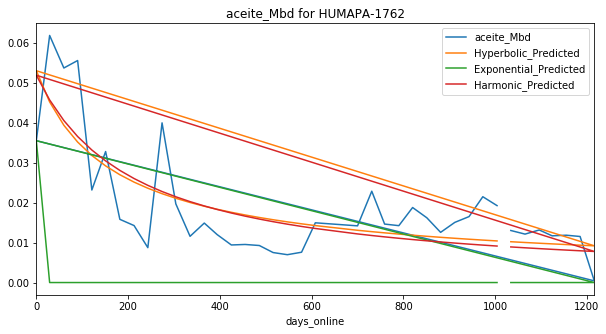

Exponential Fit Curve-fitted Variables: qi=0.044918378058944115, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.03402682833868277, b=1.9999999999999998, di=0.0033298327558035946
Harmonic Fit Curve-fitted Variables: qi=0.026849098734650245, di=0.001026519919140608


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


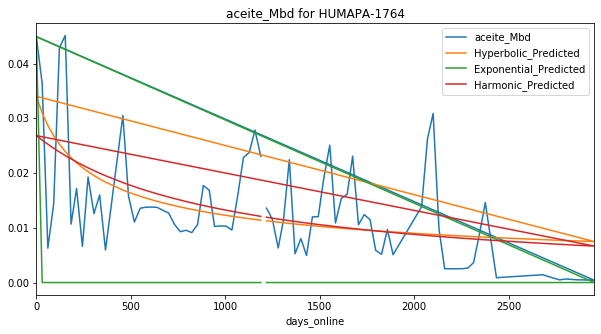

Exponential Fit Curve-fitted Variables: qi=0.02624111261050002, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.0630553503497975, b=1.6197755306094755e-05, di=0.0012126492226758763
Harmonic Fit Curve-fitted Variables: qi=0.07167622996142842, di=0.0028360790150121556


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


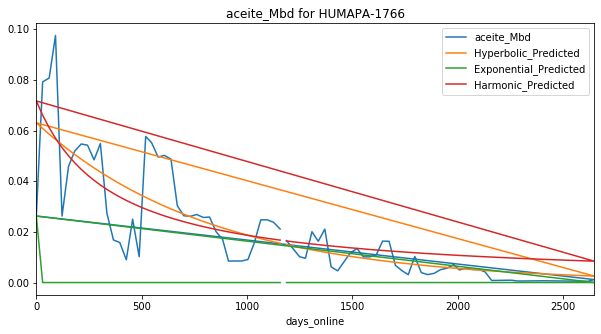

Exponential Fit Curve-fitted Variables: qi=0.005621318696192904, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.022377186739281164, b=1.6229583618166183e-08, di=0.00023914227114332735
Harmonic Fit Curve-fitted Variables: qi=0.02278893903451305, di=0.00032859970131526525


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


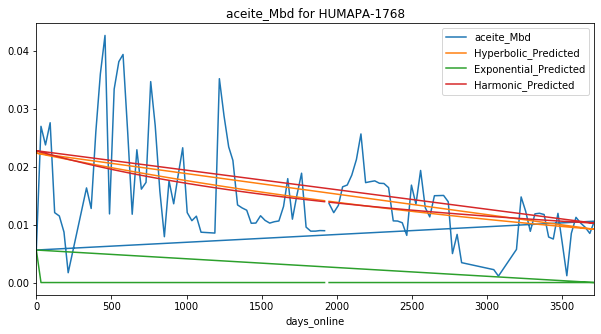

Exponential Fit Curve-fitted Variables: qi=0.0015280781829726706, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.09257013342552987, b=0.8157210764616828, di=0.004279256510674706
Harmonic Fit Curve-fitted Variables: qi=0.09333206516268124, di=0.004966754358094788


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


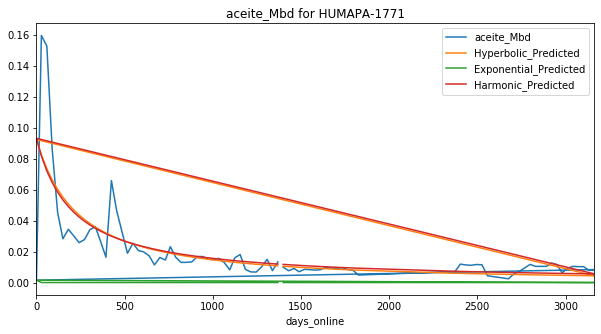

Exponential Fit Curve-fitted Variables: qi=0.03137830234842898, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.01233248915901058, b=1.9999999999999998, di=0.00019859567346937695
Harmonic Fit Curve-fitted Variables: qi=0.011788835846732534, di=0.00012741288064493895


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


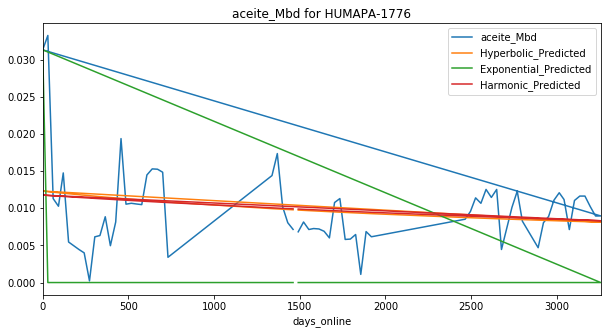

Exponential Fit Curve-fitted Variables: qi=0.01481264174423112, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.05406152787282064, b=0.6455958625672382, di=0.00631437280641892
Harmonic Fit Curve-fitted Variables: qi=0.053693827364411355, di=0.00800842816733339


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


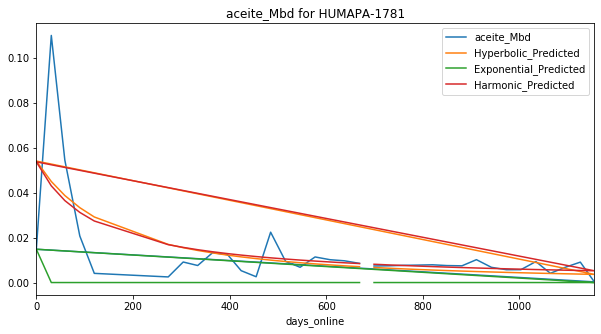

Exponential Fit Curve-fitted Variables: qi=0.05924009179687499, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.05929799999999944, b=1.9999999999999998, di=0.02432763679314251
Harmonic Fit Curve-fitted Variables: qi=0.042216420967332545, di=0.004856089081472609


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


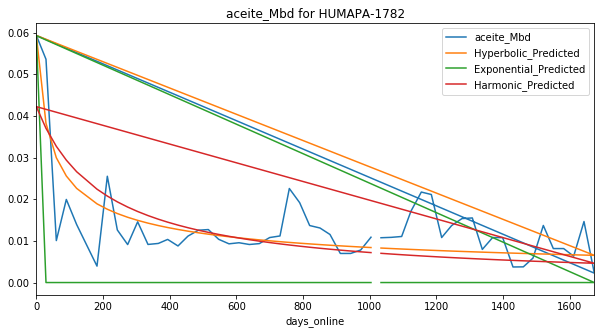

Exponential Fit Curve-fitted Variables: qi=0.06114423046875, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.061203999999999995, b=1.4423900094990403, di=0.015146788517856882
Harmonic Fit Curve-fitted Variables: qi=0.06120399999999999, di=0.010787556511499975


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


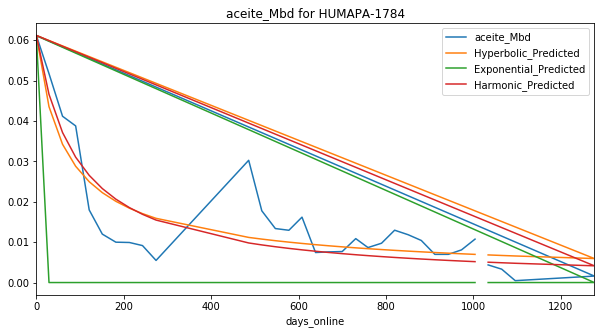

Exponential Fit Curve-fitted Variables: qi=0.027433999950666622, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.028516448569880865, b=1.9999999999999998, di=0.0019675006140657692
Harmonic Fit Curve-fitted Variables: qi=0.02143205836316452, di=0.0005291893376713347


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


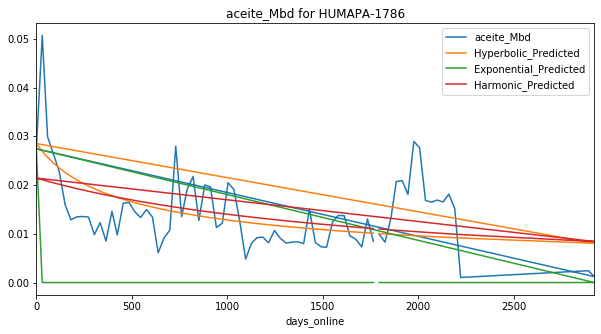

Exponential Fit Curve-fitted Variables: qi=0.0531010927734375, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.031380686417217814, b=0.22377078544330598, di=0.0007053036143268716
Harmonic Fit Curve-fitted Variables: qi=0.03292790742597915, di=0.0011156677862874278


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


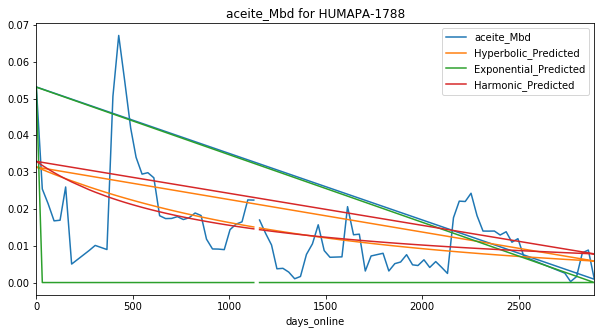

Exponential Fit Curve-fitted Variables: qi=0.005399775416491395, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.005848999999906866, b=0.00015770379541280022, di=4.2974741574268975e-13
Harmonic Fit Curve-fitted Variables: qi=0.005848999711517918, di=2.3650871727956274e-10


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


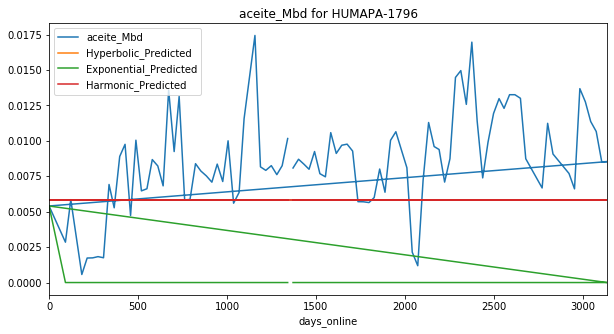

Exponential Fit Curve-fitted Variables: qi=0.09843498184872605, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.19020086797979985, b=0.26338952094209916, di=0.002086906903602676
Harmonic Fit Curve-fitted Variables: qi=0.19283199999999998, di=0.003728960120794243


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


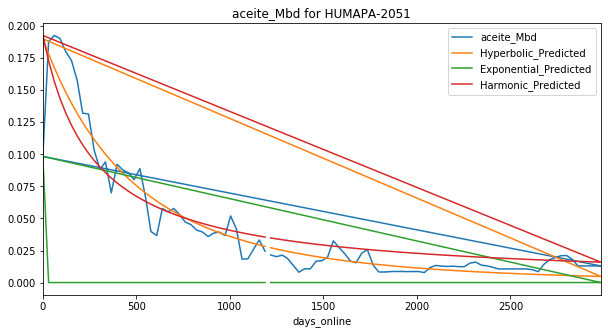

Exponential Fit Curve-fitted Variables: qi=0.04981299602010184, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.054307549045459445, b=1.8482805932376096, di=0.015855776398619514
Harmonic Fit Curve-fitted Variables: qi=0.05163502057216839, di=0.007401883835227859


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


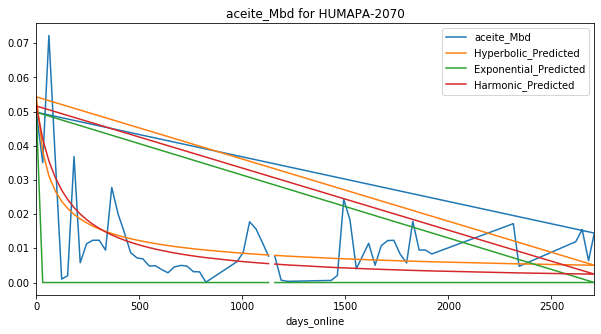

Exponential Fit Curve-fitted Variables: qi=0.043489000085760544, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.2124036277643706, b=0.8524715923793478, di=0.004460401049928419
Harmonic Fit Curve-fitted Variables: qi=0.21412901560009626, di=0.00507222365639484


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


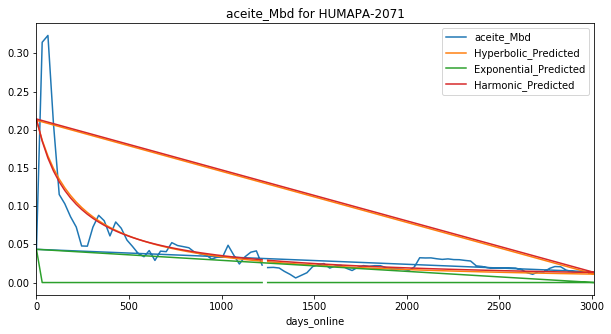

Exponential Fit Curve-fitted Variables: qi=0.0071010012748380915, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.07513855588813463, b=0.9092854453283666, di=0.002290652663945437
Harmonic Fit Curve-fitted Variables: qi=0.07576532105693355, di=0.0024722666542076298


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


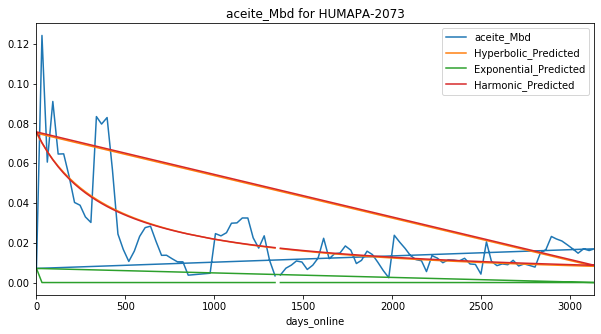

Exponential Fit Curve-fitted Variables: qi=0.072794841796875, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.07286599999997233, b=1.4497539116306752, di=0.00942341115965336
Harmonic Fit Curve-fitted Variables: qi=0.07286599999999999, di=0.006430632304828441


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


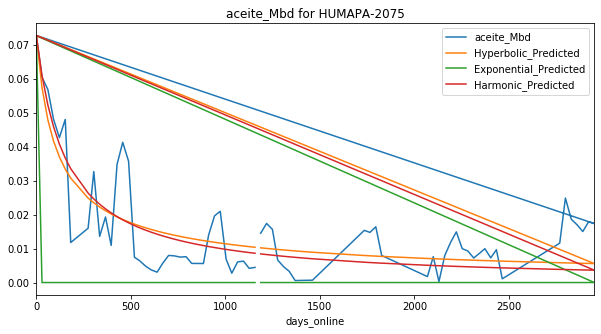

Exponential Fit Curve-fitted Variables: qi=0.04106000000431037, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.06823132739582909, b=1.3491398603152431, di=0.010720399958014189
Harmonic Fit Curve-fitted Variables: qi=0.068210632045333, di=0.00820582264089051


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


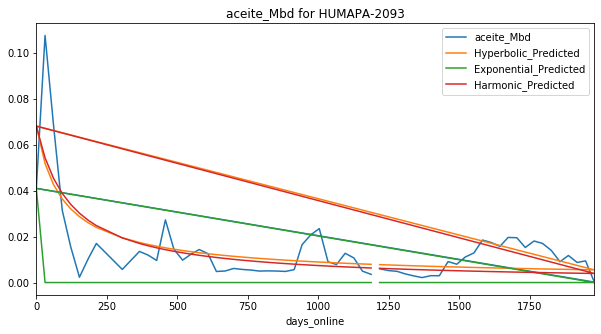

Exponential Fit Curve-fitted Variables: qi=0.01980298231144318, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.010295432608171172, b=8.00443242641169e-05, di=1.9476191099180557e-11
Harmonic Fit Curve-fitted Variables: qi=0.010295432112666396, di=4.65537559670191e-11


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


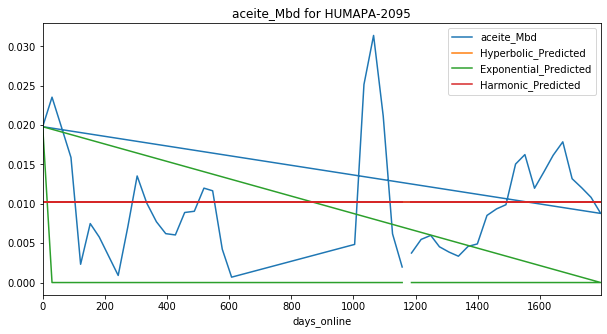

Exponential Fit Curve-fitted Variables: qi=0.24127208129882813, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.24133099999999996, b=1.1737012647782077, di=0.01874399645561827
Harmonic Fit Curve-fitted Variables: qi=0.23581549231743018, di=0.01484116565719455


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


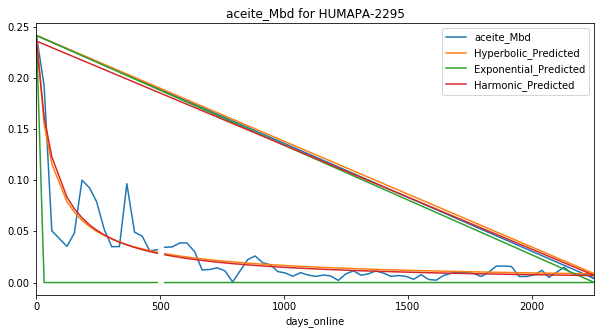

Exponential Fit Curve-fitted Variables: qi=0.01847788970474442, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.02019073587978179, b=1.9999999999999998, di=0.0019557925423781615
Harmonic Fit Curve-fitted Variables: qi=0.016812723214083773, di=0.0007469749387022657


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


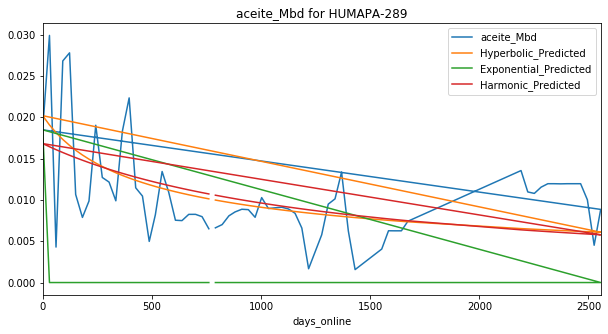

Exponential Fit Curve-fitted Variables: qi=0.011208337071640442, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.012008999999993759, b=7.605179019942526e-16, di=0.0001551110230027765
Harmonic Fit Curve-fitted Variables: qi=0.012008999999999994, di=0.00015428540602969692


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


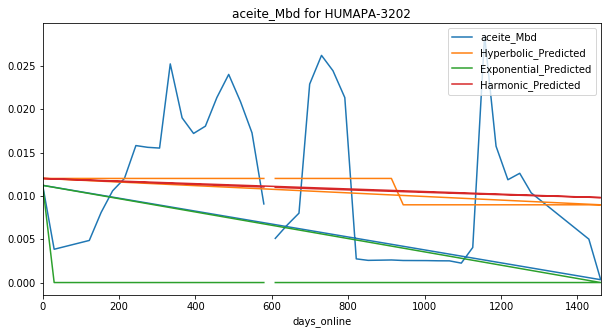

Exponential Fit Curve-fitted Variables: qi=0.005616002649992727, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.03170853200151308, b=0.5861080803557042, di=0.002231399093531457
Harmonic Fit Curve-fitted Variables: qi=0.03207327324745528, di=0.0028906170142400356


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


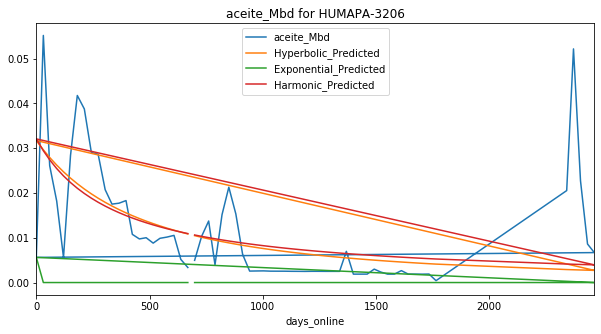

Exponential Fit Curve-fitted Variables: qi=0.07742567081388861, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.1036539999965759, b=1.5639369623909975e-13, di=0.0008342511200217901
Harmonic Fit Curve-fitted Variables: qi=0.10365399999999998, di=0.0013833830567183797


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


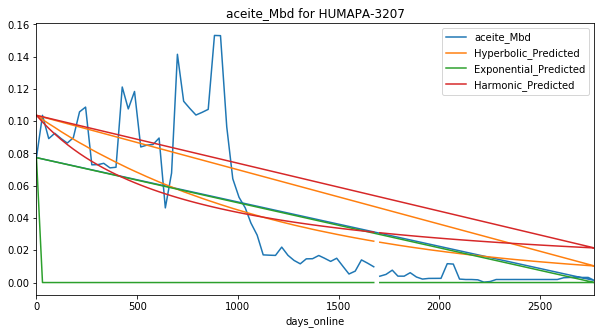

Exponential Fit Curve-fitted Variables: qi=0.0412057744630964, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.050705900305782065, b=1.9999999999999998, di=0.00501964279483072
Harmonic Fit Curve-fitted Variables: qi=0.03096405985005814, di=0.0007128018567581203


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


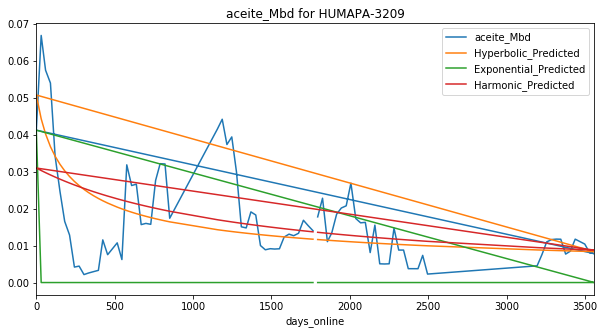

Exponential Fit Curve-fitted Variables: qi=0.012376000149328657, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.020629137043854065, b=1.8363851415270866e-10, di=0.0005523977491646804
Harmonic Fit Curve-fitted Variables: qi=0.020069967808996413, di=0.0007080083322290845


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


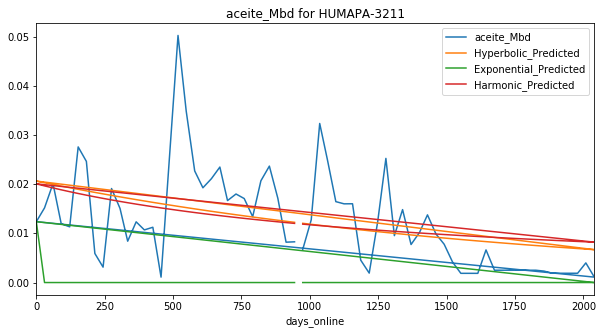

Exponential Fit Curve-fitted Variables: qi=0.04335515625, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.027537703910357095, b=0.4802768939799759, di=0.0008632016903581527
Harmonic Fit Curve-fitted Variables: qi=0.028225573943031764, di=0.0011188944203000739


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


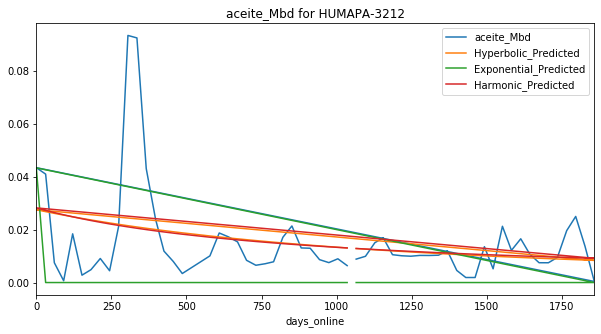

Exponential Fit Curve-fitted Variables: qi=0.019329997229320977, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.015251371275555292, b=1.9999999999999998, di=2.8301226061501827e-16
Harmonic Fit Curve-fitted Variables: qi=0.01525136510411866, di=4.7683923993728576e-12


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


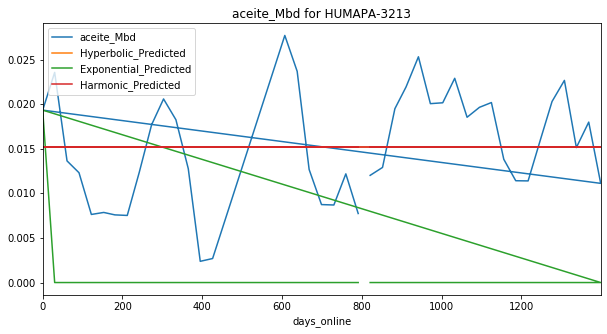

Exponential Fit Curve-fitted Variables: qi=0.00913302757203118, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.01181554014709489, b=1.9999999998662683, di=0.00011787257956374153
Harmonic Fit Curve-fitted Variables: qi=0.01177163540865099, di=0.00010537384308224015


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


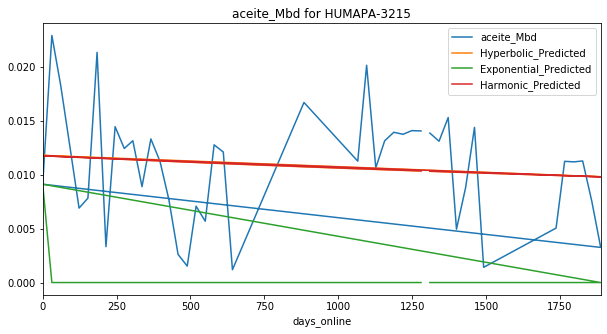

Exponential Fit Curve-fitted Variables: qi=0.005325041868636662, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.052752397505993524, b=1.3716983695383753, di=0.006442019215859409
Harmonic Fit Curve-fitted Variables: qi=0.05223672348186031, di=0.00491431342736685


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


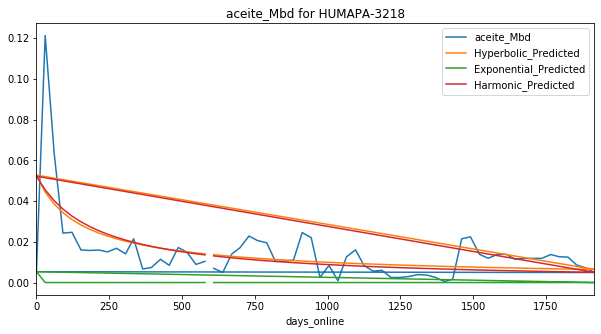

Exponential Fit Curve-fitted Variables: qi=0.09280528125000001, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.09110308060511152, b=1.9999999999999982, di=0.0147166077188378
Harmonic Fit Curve-fitted Variables: qi=0.06900663896035522, di=0.003605503989036638

C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


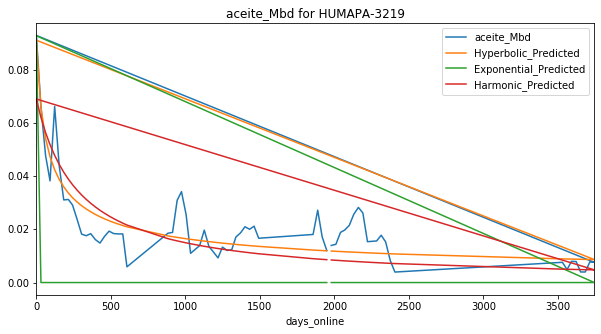

Exponential Fit Curve-fitted Variables: qi=0.09857900539502629, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.42574901682266686, b=1.1332328856701374e-07, di=0.0028513326595112987
Harmonic Fit Curve-fitted Variables: qi=0.41703545840611345, di=0.0042555923295984135


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


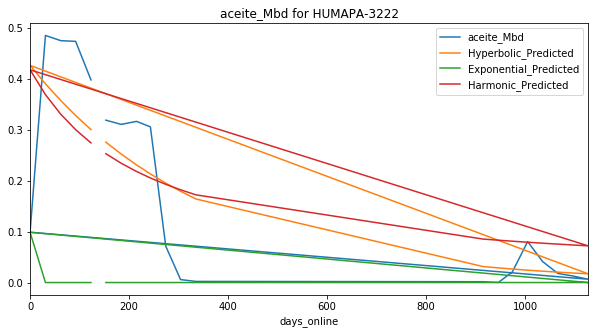

Exponential Fit Curve-fitted Variables: qi=0.020998839403685507, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.023304906838348967, b=1.3689429741873154, di=0.002090466818540683
Harmonic Fit Curve-fitted Variables: qi=0.02280862016470972, di=0.0016619914874936952


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


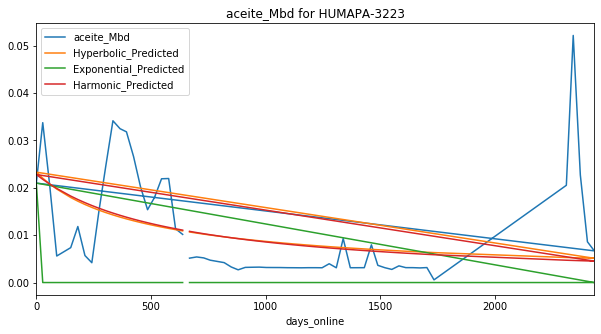

Exponential Fit Curve-fitted Variables: qi=0.3124709999844744, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.3383289999986474, b=8.685884533318839e-16, di=0.011589164706482342
Harmonic Fit Curve-fitted Variables: qi=0.33832899999999994, di=0.02553970083749028


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


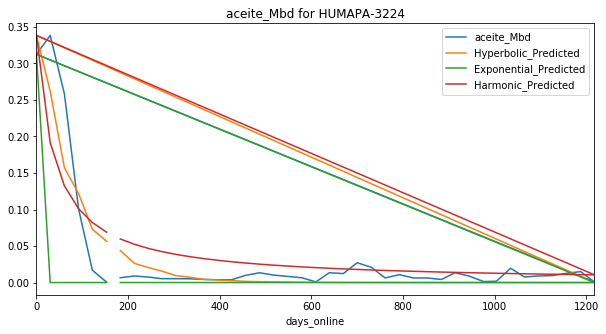

Exponential Fit Curve-fitted Variables: qi=0.1454189599609375, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.1443428317666578, b=1.9999999999999998, di=0.113758517903613
Harmonic Fit Curve-fitted Variables: qi=0.13346474203783243, di=0.0318450610721256


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


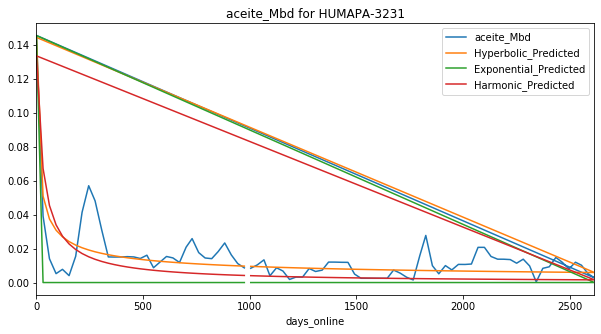

Exponential Fit Curve-fitted Variables: qi=0.012162000247652967, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.028779215410910032, b=0.5845193470312937, di=0.002060966729947803
Harmonic Fit Curve-fitted Variables: qi=0.028635806350699945, di=0.0025160167147596853


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


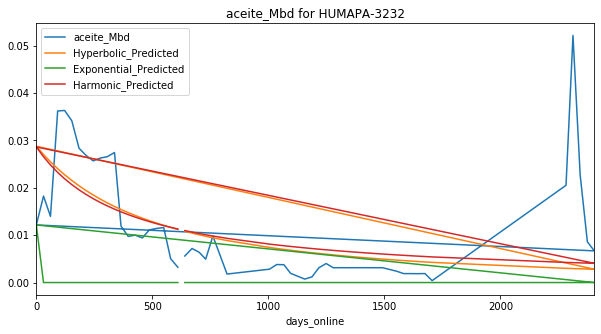

Exponential Fit Curve-fitted Variables: qi=0.03133102956226239, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.05896399746668838, b=1.359228676528616, di=0.003624574508805002
Harmonic Fit Curve-fitted Variables: qi=0.0575445700872818, di=0.002735819029593639


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


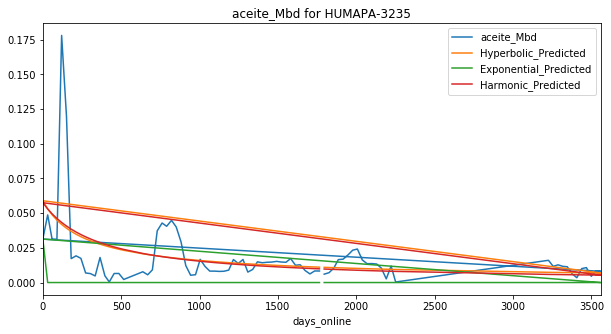

Exponential Fit Curve-fitted Variables: qi=0.008854621014054544, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.025103521612599173, b=1.3390501980175327, di=0.0028432095846355303
Harmonic Fit Curve-fitted Variables: qi=0.024770407458086452, di=0.002424744829240825


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


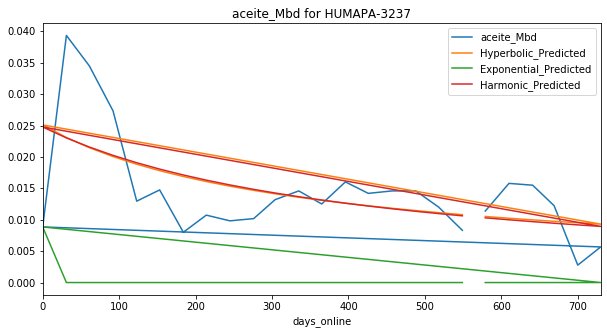

Exponential Fit Curve-fitted Variables: qi=0.035556417968750004, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.021840749954632824, b=1.9999999999999998, di=0.0028159172251145787
Harmonic Fit Curve-fitted Variables: qi=0.016666516918641884, di=0.0007788652907393515


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


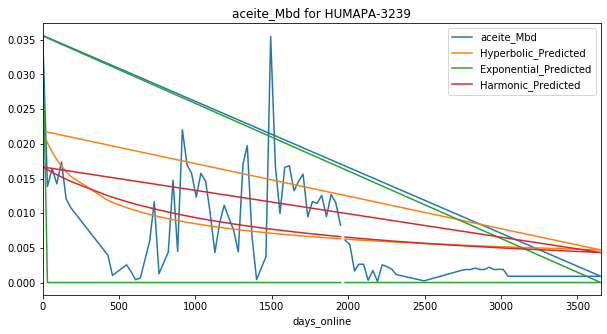

Exponential Fit Curve-fitted Variables: qi=0.005905000798631466, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.020791489877859202, b=1.999999999978787, di=0.0011513720970202821
Harmonic Fit Curve-fitted Variables: qi=0.019848174458174796, di=0.0007588688762865674


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


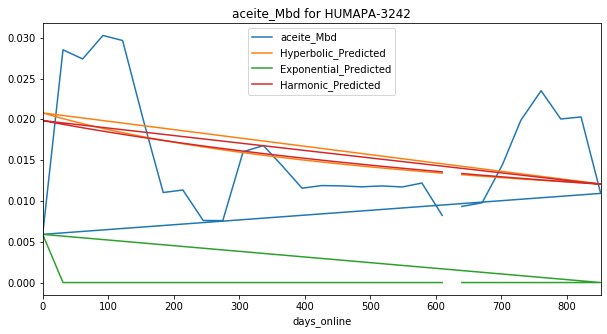

Exponential Fit Curve-fitted Variables: qi=0.032692324219188676, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.029763078869718757, b=1.9999999999999998, di=0.007335955204329286
Harmonic Fit Curve-fitted Variables: qi=0.021611926122121344, di=0.0017424662228042156


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


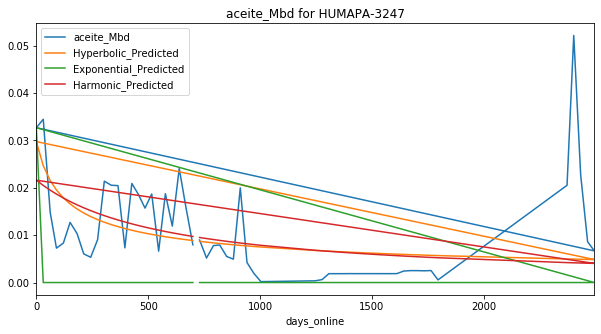

Exponential Fit Curve-fitted Variables: qi=0.0475110234375, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.018301474192819987, b=1.2270047944018944e-06, di=0.00027407941860211
Harmonic Fit Curve-fitted Variables: qi=0.01853699935673225, di=0.00034150380828811146


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


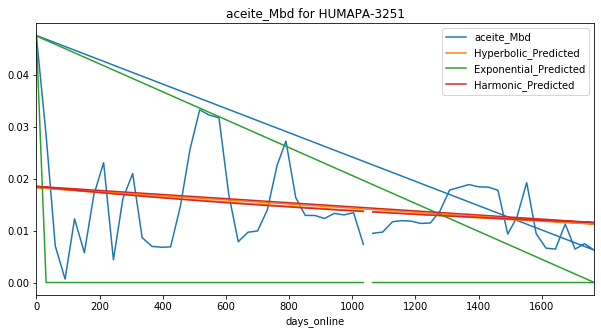

Exponential Fit Curve-fitted Variables: qi=0.0032260040964754906, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.04606391397648552, b=1.7969061905007595, di=0.007948027062170331
Harmonic Fit Curve-fitted Variables: qi=0.04454027054444737, di=0.0042230353084575425


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


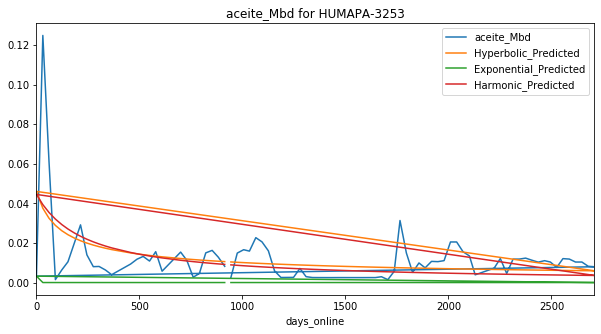

Exponential Fit Curve-fitted Variables: qi=0.05114496421059381, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.05243381669097539, b=1.9999999999999996, di=0.012190824736317742
Harmonic Fit Curve-fitted Variables: qi=0.029454516893668774, di=0.0014205173297559203


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


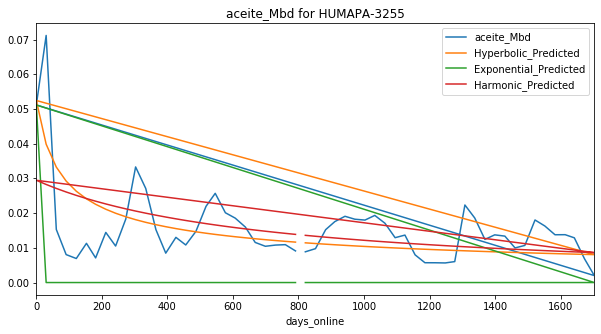

Exponential Fit Curve-fitted Variables: qi=0.09766199995811181, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.12776899999999988, b=8.150241587396897e-11, di=0.007403791883167463
Harmonic Fit Curve-fitted Variables: qi=0.12776899999999997, di=0.015852731394127868


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


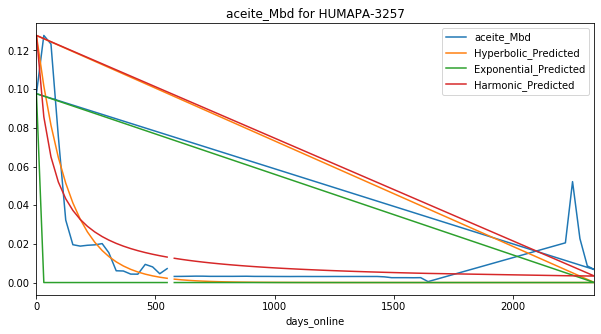

Exponential Fit Curve-fitted Variables: qi=0.031339788529844315, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.030777805980024605, b=0.12040015252118987, di=0.0006183001584882823
Harmonic Fit Curve-fitted Variables: qi=0.032554217235090374, di=0.0009980634275639029


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


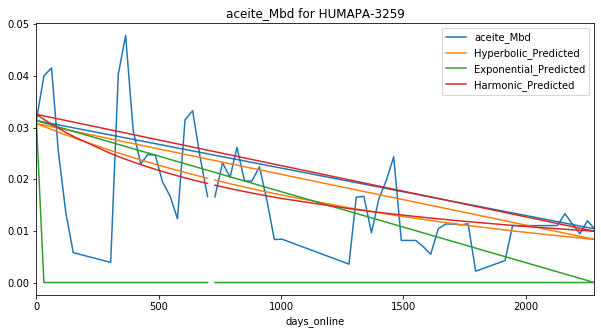

Exponential Fit Curve-fitted Variables: qi=0.10057568554687499, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.10067399999999846, b=1.1780958749270907, di=0.01875997333873053
Harmonic Fit Curve-fitted Variables: qi=0.10067399930907742, di=0.01581508392214598


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


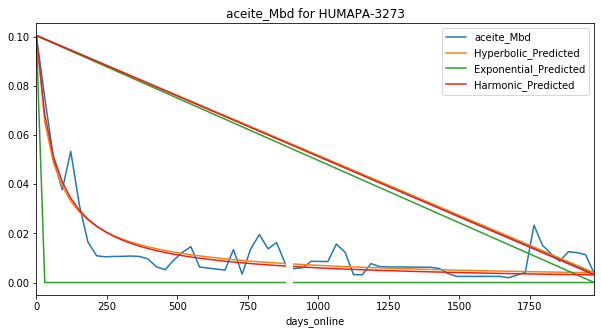

Exponential Fit Curve-fitted Variables: qi=0.12836599849522282, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.14451499999999998, b=0.4514387254790861, di=0.0077058682594668875
Harmonic Fit Curve-fitted Variables: qi=0.14451499999999998, di=0.011939758654616935


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


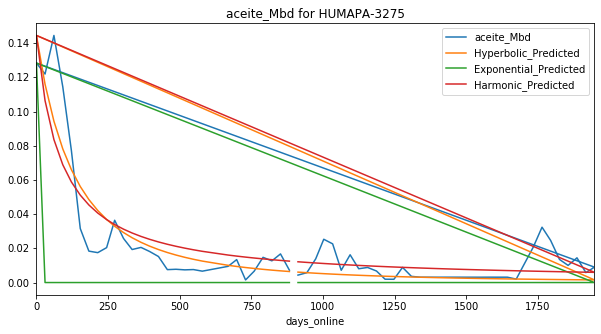

Exponential Fit Curve-fitted Variables: qi=0.10136902612345902, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.3011374776457626, b=2.783377316192338e-10, di=0.0047383003460411315
Harmonic Fit Curve-fitted Variables: qi=0.28001116352236677, di=0.00872402858285776


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


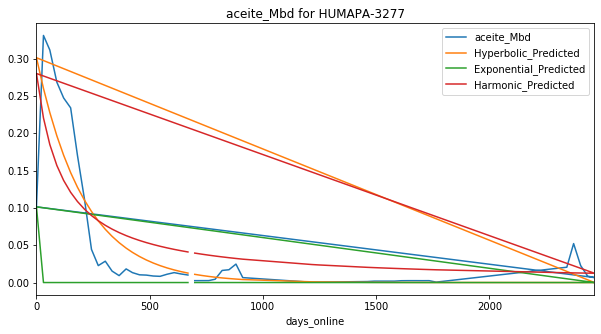

Exponential Fit Curve-fitted Variables: qi=0.0533948056640625, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.04910188829609493, b=1.9999999999999998, di=0.0118465400717401
Harmonic Fit Curve-fitted Variables: qi=0.02669932889698569, di=0.001285360397000968


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


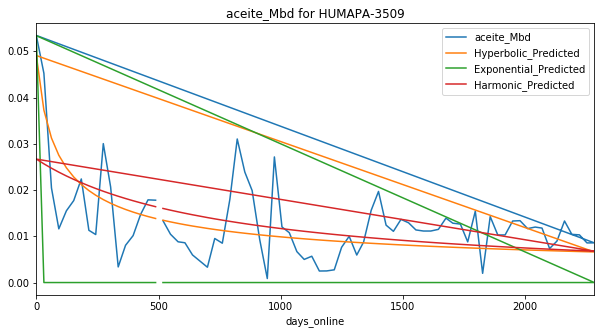

Exponential Fit Curve-fitted Variables: qi=0.046743525390625, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.02187259454439348, b=2.202240661523229e-05, di=0.0002146694691631121
Harmonic Fit Curve-fitted Variables: qi=0.02179438494176457, di=0.0002649694397181109


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


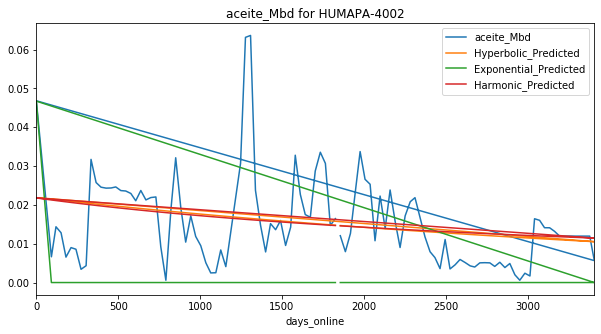

Exponential Fit Curve-fitted Variables: qi=0.014623005085044556, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.018936897070371477, b=8.599896409719e-09, di=0.00020868562101287346
Harmonic Fit Curve-fitted Variables: qi=0.018982312800878833, di=0.0002599867127524039


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


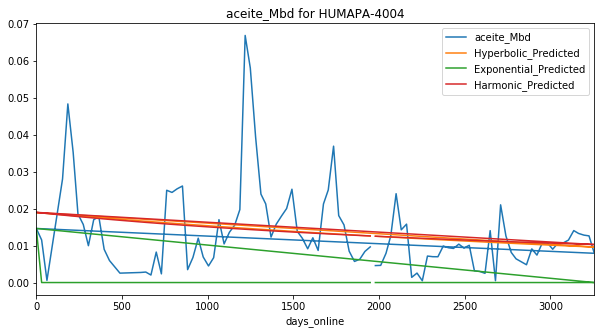

Exponential Fit Curve-fitted Variables: qi=0.038815000013346784, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.11986192023441526, b=4.052068435231501e-07, di=0.0032485921799307997
Harmonic Fit Curve-fitted Variables: qi=0.11951847155188747, di=0.005786005907847552


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


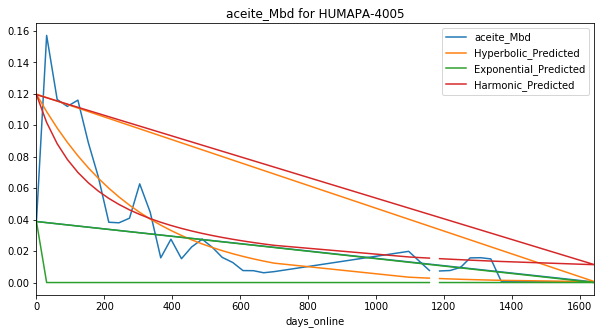

Exponential Fit Curve-fitted Variables: qi=0.05358706264082082, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.09726066626393329, b=0.3805461077802056, di=0.0035002137218546722
Harmonic Fit Curve-fitted Variables: qi=0.10035487236171306, di=0.005868625958912727


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


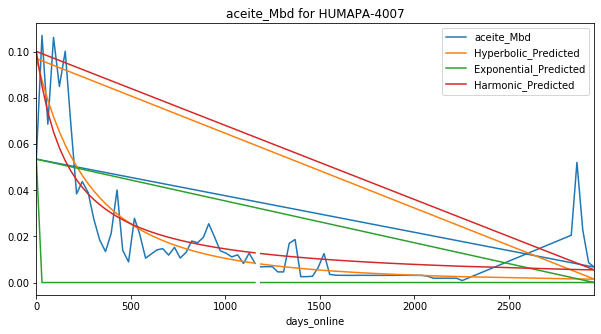

Exponential Fit Curve-fitted Variables: qi=0.03074183984375, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.014044965264495383, b=1.9999999999999998, di=0.00012064598063834644
Harmonic Fit Curve-fitted Variables: qi=0.013808426768706066, di=9.380097963057003e-05


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


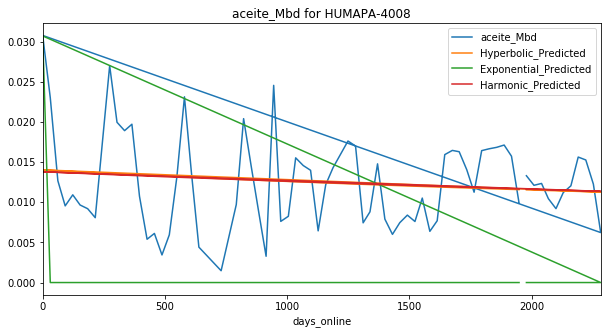

Exponential Fit Curve-fitted Variables: qi=0.002246281696480526, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.015636457777340015, b=1.999999999132045, di=0.00011272661327729079
Harmonic Fit Curve-fitted Variables: qi=0.015505977908213807, di=9.537363856704294e-05


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


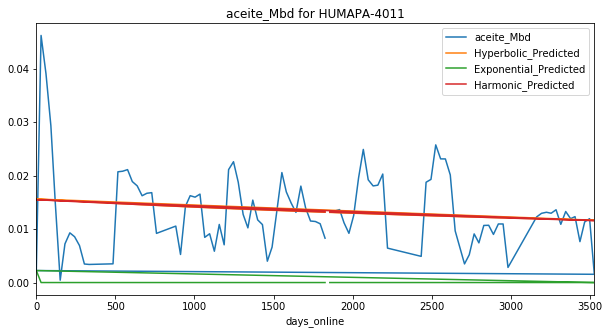

Exponential Fit Curve-fitted Variables: qi=0.06026508984375, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.03957279849153138, b=0.4451425403068746, di=0.0006025070421762872
Harmonic Fit Curve-fitted Variables: qi=0.04125793107818854, di=0.0008454230193665763


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


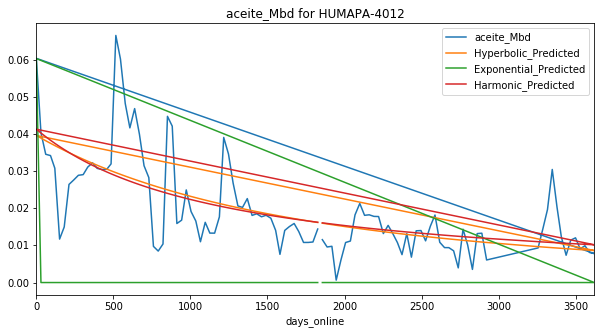

Exponential Fit Curve-fitted Variables: qi=0.032958501953125004, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.01469733080267823, b=0.005172872873687284, di=4.192567872767159e-16
Harmonic Fit Curve-fitted Variables: qi=0.014697318136208594, di=1.63952173094907e-11


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


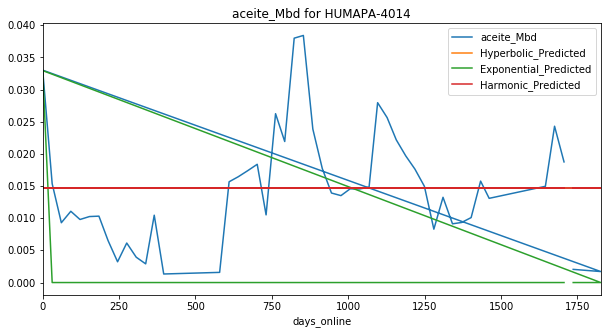

Exponential Fit Curve-fitted Variables: qi=0.05998395164061142, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.08076535276567805, b=1.4305887406341784, di=0.007815392876325574
Harmonic Fit Curve-fitted Variables: qi=0.07790247499029389, di=0.005179828344369796


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


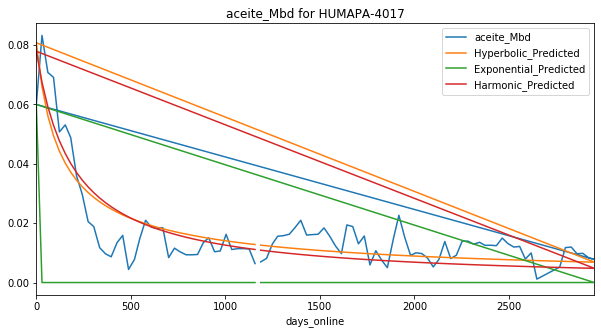

Exponential Fit Curve-fitted Variables: qi=0.06832695767963881, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.11100143142165439, b=0.49083008707142667, di=0.005263253708288625
Harmonic Fit Curve-fitted Variables: qi=0.11246424387753917, di=0.00789402963467337


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


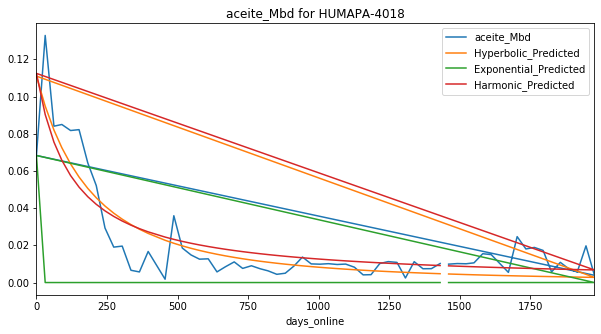

Exponential Fit Curve-fitted Variables: qi=0.03689608888076524, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.01362690234234745, b=0.0004061329498305176, di=2.0002836136271006e-05
Harmonic Fit Curve-fitted Variables: qi=0.013610570864467427, di=1.9787590561937347e-05


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


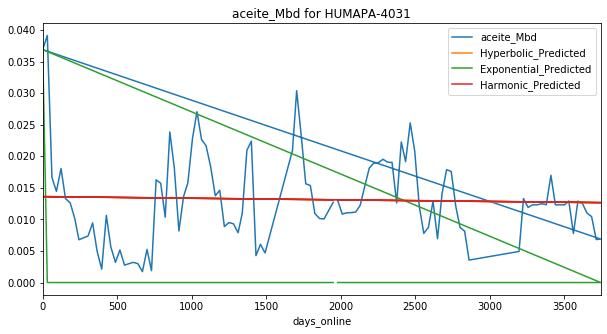

Exponential Fit Curve-fitted Variables: qi=0.030890548828125, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.017240306248302736, b=9.640947965703315e-06, di=0.00010215846839060588
Harmonic Fit Curve-fitted Variables: qi=0.01719433420745499, di=0.00011113390436640583


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


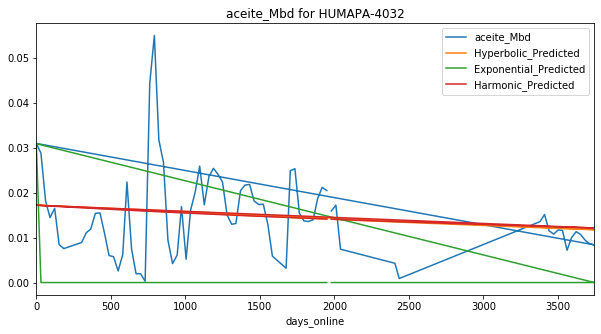

Exponential Fit Curve-fitted Variables: qi=0.028077000011818842, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.035888900384775865, b=1.9999999999999996, di=0.001236422093995588
Harmonic Fit Curve-fitted Variables: qi=0.031088917201062122, di=0.0005244109703763453


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


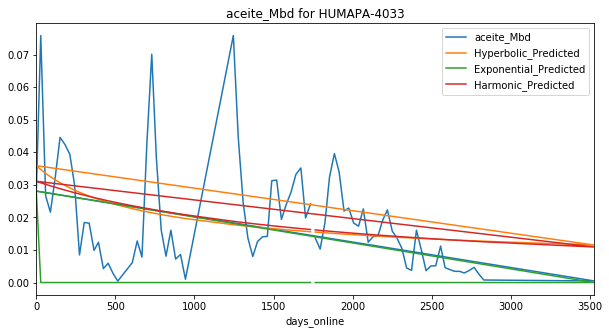

Exponential Fit Curve-fitted Variables: qi=0.05187329296875, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.02578092615910116, b=9.252787474035723e-11, di=0.0004437160820821475
Harmonic Fit Curve-fitted Variables: qi=0.028063315470012135, di=0.0008115542471075238


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


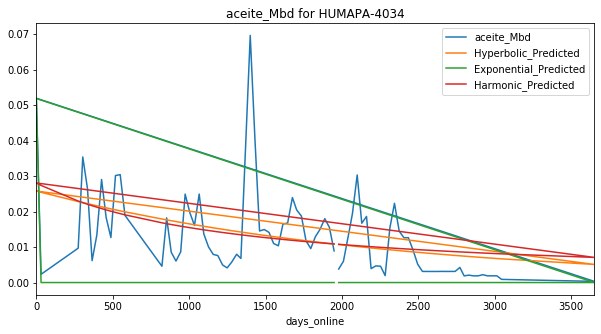

Exponential Fit Curve-fitted Variables: qi=0.038601002627533174, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.07527093995616249, b=1.2318150153011633, di=0.00914223787604741
Harmonic Fit Curve-fitted Variables: qi=0.07478374350610349, di=0.007466018025665695


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


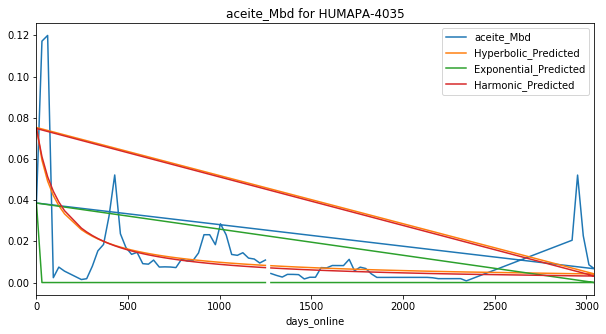

Exponential Fit Curve-fitted Variables: qi=0.053147047851562504, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.02132559668619109, b=4.0670810435847165e-06, di=0.00011331675317612945
Harmonic Fit Curve-fitted Variables: qi=0.021182197899807232, di=0.00011527781537378176


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


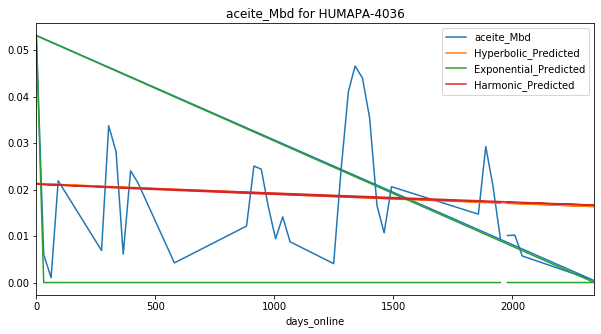

Exponential Fit Curve-fitted Variables: qi=0.03933600255633179, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.12330718596900492, b=0.786262568532793, di=0.0052371630026036
Harmonic Fit Curve-fitted Variables: qi=0.12397975602487062, di=0.006199950502734604


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


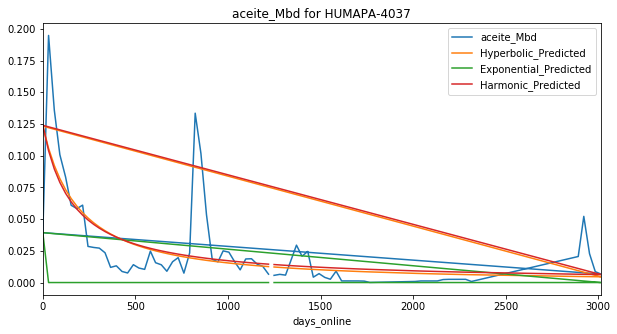

Exponential Fit Curve-fitted Variables: qi=0.005962000654117824, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.013207275630433342, b=1.999999999976023, di=4.994994408875438e-05
Harmonic Fit Curve-fitted Variables: qi=0.013134059832489185, di=4.3786131529774936e-05


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


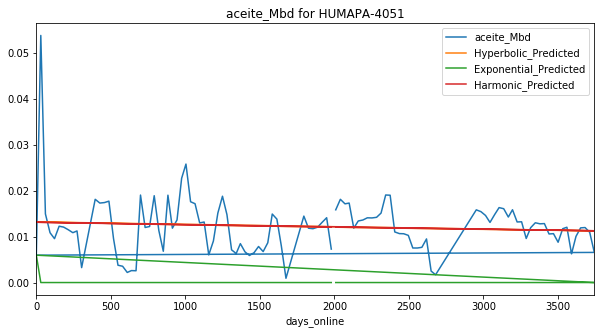

Exponential Fit Curve-fitted Variables: qi=0.075941765625, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.07321739808551636, b=1.9999999999999998, di=0.0399341199324724
Harmonic Fit Curve-fitted Variables: qi=0.017061255707435066, di=0.0002504087391310439


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


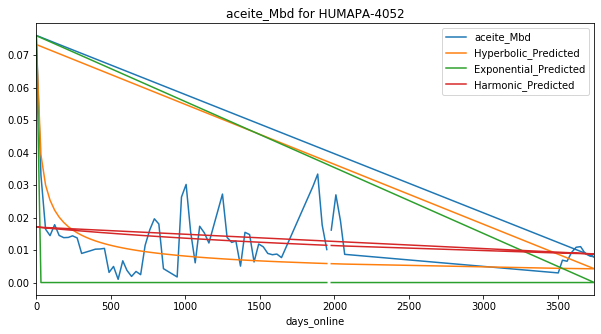

Exponential Fit Curve-fitted Variables: qi=0.02100149704062208, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.017026175099450907, b=1.9999999999922522, di=0.0001805744923634213
Harmonic Fit Curve-fitted Variables: qi=0.016699499662957144, di=0.0001389557343211146


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


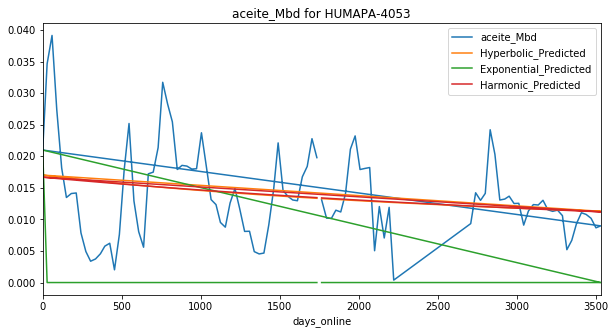

Exponential Fit Curve-fitted Variables: qi=0.0019761805118203492, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.023076541944830737, b=1.1643003984411533, di=0.0004972979599728411
Harmonic Fit Curve-fitted Variables: qi=0.022873381315177754, di=0.00045871351284838233


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


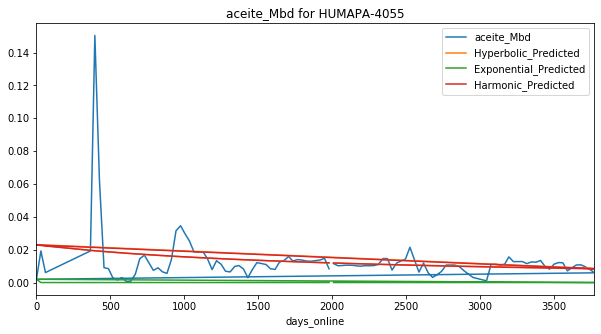

Exponential Fit Curve-fitted Variables: qi=0.01953140625, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.010547183259219705, b=1.9998331845775188, di=1.1616489194409103e-15
Harmonic Fit Curve-fitted Variables: qi=0.010547182629880959, di=4.3649980975030403e-10


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


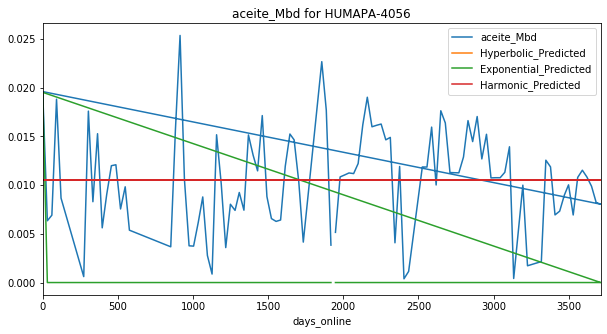

Exponential Fit Curve-fitted Variables: qi=0.06239101171875, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.02897009278268756, b=1.9999999999999998, di=0.002124043404418441
Harmonic Fit Curve-fitted Variables: qi=0.024037362645149697, di=0.0007945482080743488


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


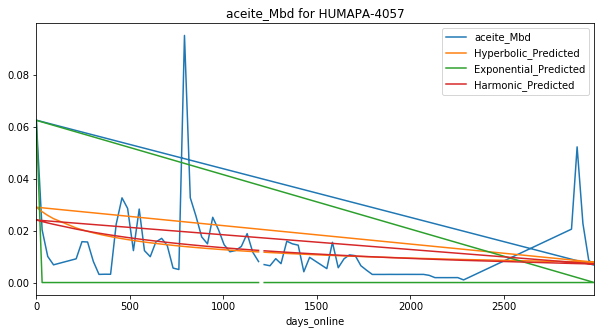

Exponential Fit Curve-fitted Variables: qi=0.3262813220214844, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.32636099999999996, b=0.775229983685994, di=0.018851637645205834
Harmonic Fit Curve-fitted Variables: qi=0.32636099999999996, di=0.023555216987814043


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


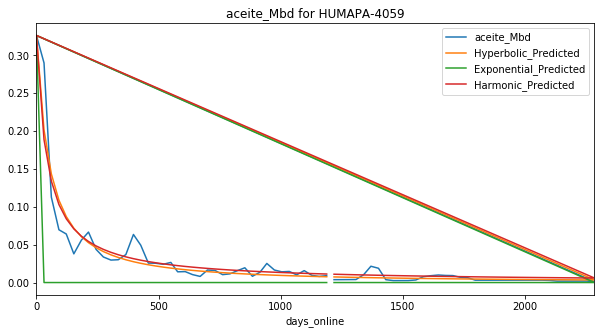

Exponential Fit Curve-fitted Variables: qi=0.0800587412109375, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.08003794743207135, b=1.9999999999999998, di=0.03078772099057889
Harmonic Fit Curve-fitted Variables: qi=0.07131418052969501, di=0.011306220865524045


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


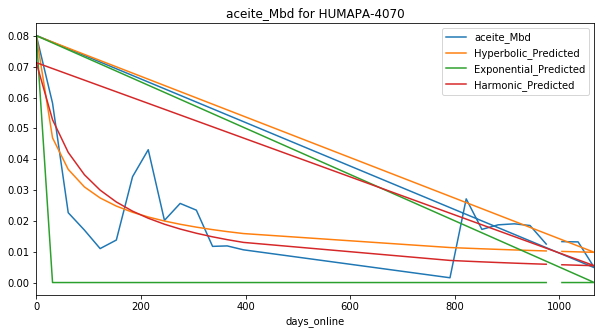

Exponential Fit Curve-fitted Variables: qi=0.03618700783329826, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.05353804978952258, b=1.9999999999999547, di=0.0033051153890140236
Harmonic Fit Curve-fitted Variables: qi=0.042693121249618465, di=0.0010191713385358596


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


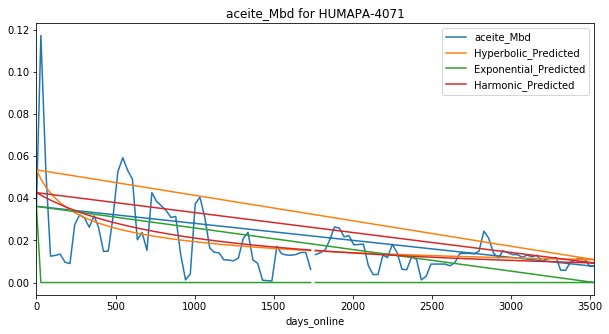

Exponential Fit Curve-fitted Variables: qi=0.0062610917522062355, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.014531969461943075, b=4.2971099768751575e-12, di=5.3306064161423286e-05
Harmonic Fit Curve-fitted Variables: qi=0.014459206668502264, di=5.334988076980381e-05


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


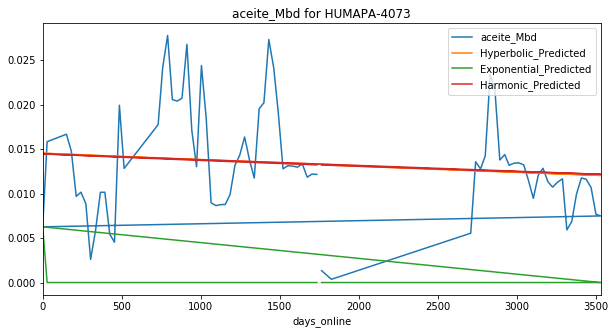

Exponential Fit Curve-fitted Variables: qi=0.003414047965940119, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.03269261133793198, b=0.5332817017020915, di=0.00072953426064918
Harmonic Fit Curve-fitted Variables: qi=0.0335169649907304, di=0.0009311438799267104


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


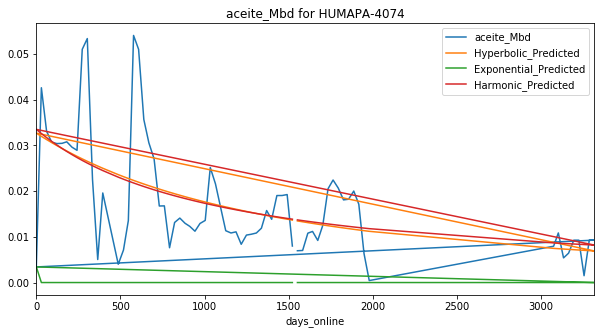

Exponential Fit Curve-fitted Variables: qi=0.03865435546875, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.012791775036333735, b=0.0003538078762792282, di=5.4749655931584575e-05
Harmonic Fit Curve-fitted Variables: qi=0.012641795205398569, di=4.84540955595308e-05


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


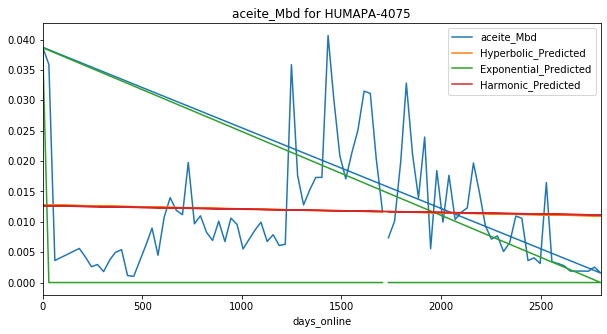

Exponential Fit Curve-fitted Variables: qi=0.034584999031566484, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.038353469410317274, b=0.49540271909912015, di=0.0011282582609553927
Harmonic Fit Curve-fitted Variables: qi=0.039876467881770974, di=0.0016024085618978352


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


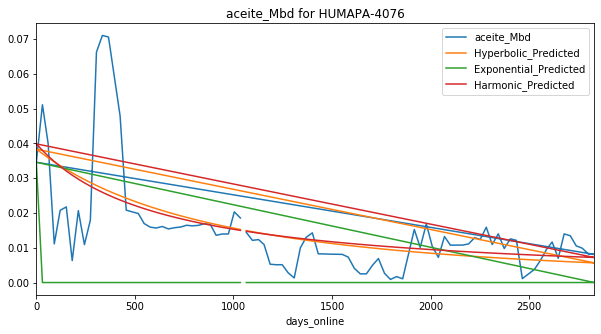

Exponential Fit Curve-fitted Variables: qi=0.01824000002996224, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.017256657331259802, b=1.9999999999999998, di=0.00021522990699386418
Harmonic Fit Curve-fitted Variables: qi=0.016599790426634786, di=0.00013926996545390839


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


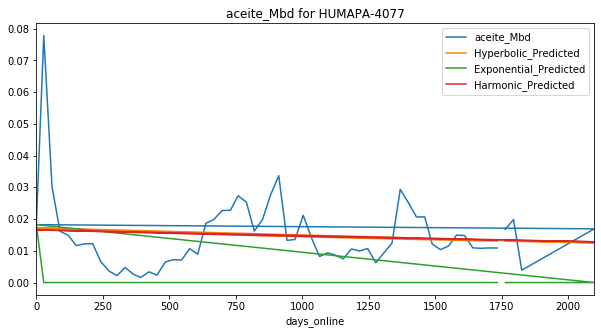

Exponential Fit Curve-fitted Variables: qi=0.04453218216279575, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.09243254941634524, b=0.4742547333988293, di=0.002088686257839275
Harmonic Fit Curve-fitted Variables: qi=0.09789112796343645, di=0.0033606059705290547


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


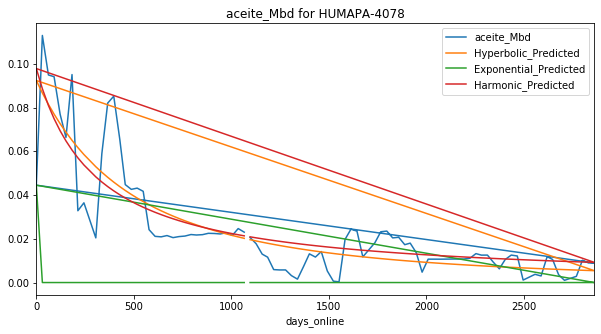

Exponential Fit Curve-fitted Variables: qi=0.006728002748695729, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.032601706926077535, b=1.9772385304601475e-12, di=0.0003865024977503307
Harmonic Fit Curve-fitted Variables: qi=0.033819205917815384, di=0.000621252029442396


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


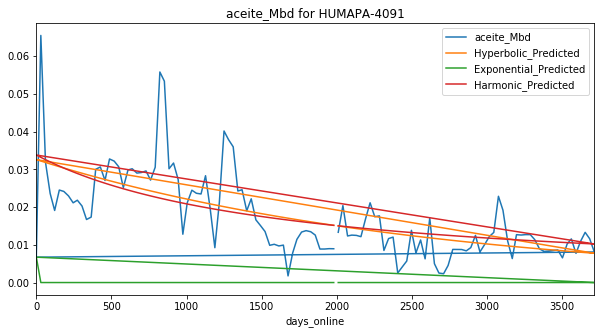

Exponential Fit Curve-fitted Variables: qi=0.003515317398954463, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.06833364237378065, b=0.9397110294396062, di=0.004829124769751042
Harmonic Fit Curve-fitted Variables: qi=0.0683457742466356, di=0.00502616976799128


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


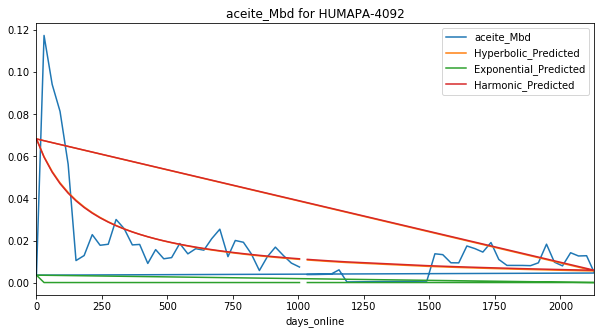

Exponential Fit Curve-fitted Variables: qi=0.01915787109375, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.013564227315866314, b=3.3026782045427676e-06, di=2.0377882948585026e-15
Harmonic Fit Curve-fitted Variables: qi=0.013564223096723746, di=1.253461911250839e-10


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


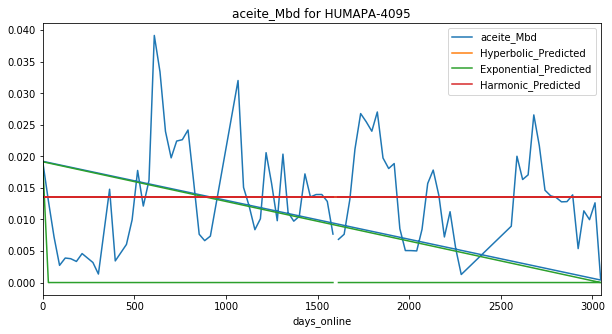

Exponential Fit Curve-fitted Variables: qi=0.02272406576082756, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.061245214718054344, b=1.7576872104658042e-13, di=0.001232213473138498
Harmonic Fit Curve-fitted Variables: qi=0.06836891199863693, di=0.0027642492768867864


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


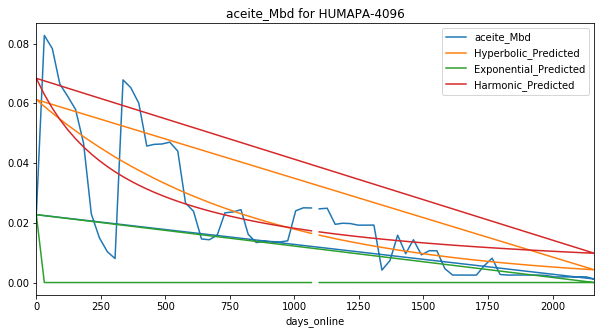

Exponential Fit Curve-fitted Variables: qi=0.0009070256324320933, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.009559517118877755, b=0.025121891274933656, di=1.4471114707933452e-27
Harmonic Fit Curve-fitted Variables: qi=0.009559512557052246, di=6.639446760143148e-14


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


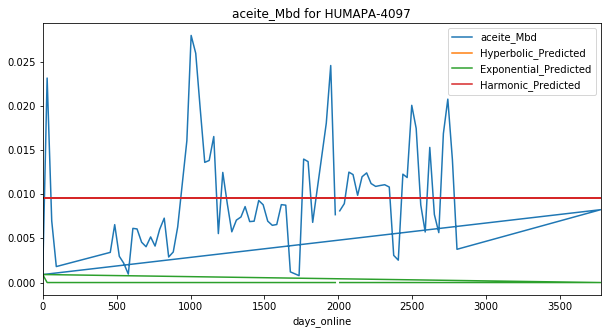

Exponential Fit Curve-fitted Variables: qi=0.004180246755259232, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.01412430937318753, b=1.4706387670149201e-10, di=6.1451912178424044e-15
Harmonic Fit Curve-fitted Variables: qi=0.01412430540218849, di=7.862363601531751e-13


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


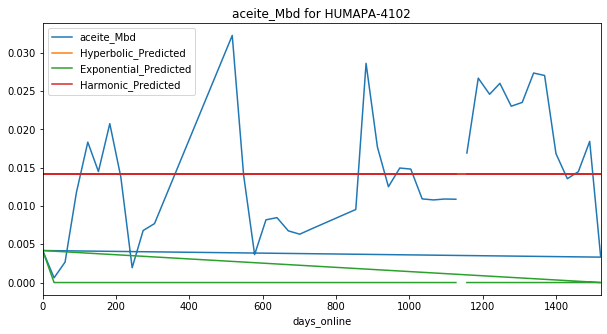

Exponential Fit Curve-fitted Variables: qi=0.016392698132193392, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.01167641207499913, b=2.5860484892011038e-06, di=1.2973009104116843e-18
Harmonic Fit Curve-fitted Variables: qi=0.0116764033478081, di=5.744522070762763e-11


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


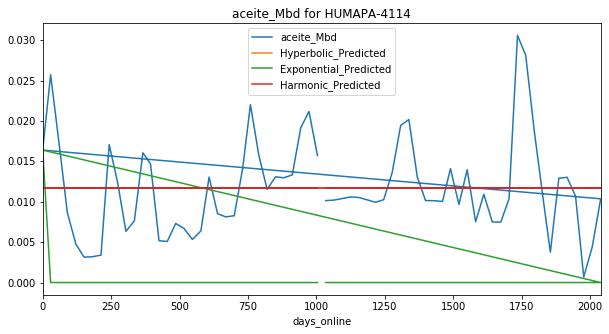

Exponential Fit Curve-fitted Variables: qi=0.007645438530950568, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.017996620879123734, b=5.044502175342674e-06, di=0.00010918934670417275
Harmonic Fit Curve-fitted Variables: qi=0.017870837705932553, di=0.00011020064203894414


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


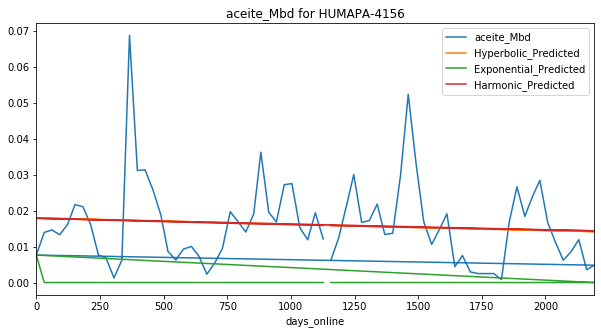

Exponential Fit Curve-fitted Variables: qi=0.05265899687933847, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.05176703043437409, b=0.08957899836826025, di=0.001416274100778084
Harmonic Fit Curve-fitted Variables: qi=0.062128209087375964, di=0.0036069196510529413


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


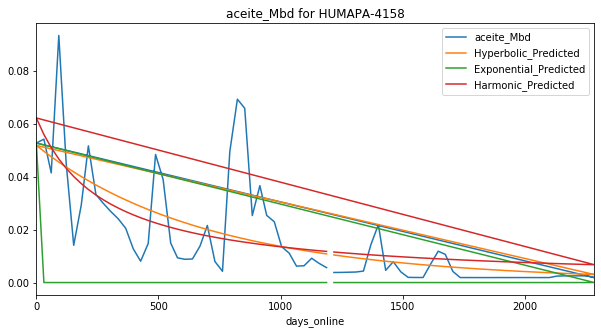

Exponential Fit Curve-fitted Variables: qi=0.012971082915588438, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.022675500608635824, b=1.9999999999999998, di=0.002041678533408103
Harmonic Fit Curve-fitted Variables: qi=0.018552319925003932, di=0.000682720179029763


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


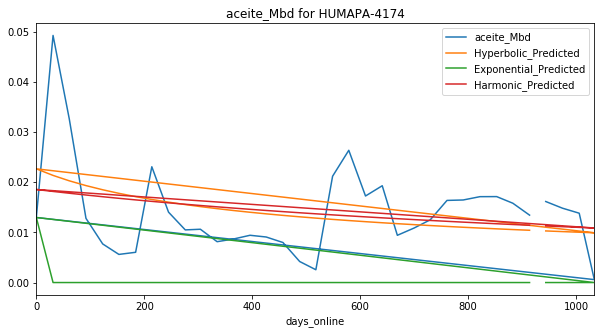

Exponential Fit Curve-fitted Variables: qi=0.024826999946454716, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.02674668211654521, b=1.9999999999999987, di=0.0009417124987521447
Harmonic Fit Curve-fitted Variables: qi=0.02423532900445056, di=0.00048480644340668616


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


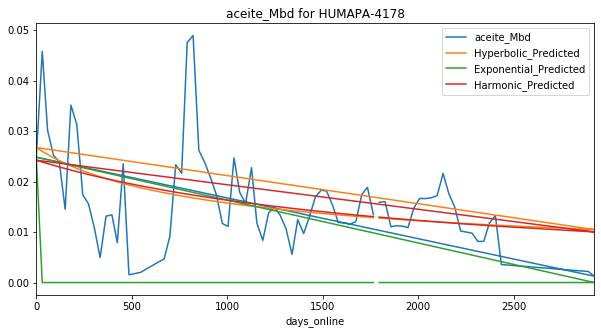

Exponential Fit Curve-fitted Variables: qi=0.035687162109375, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.03575699999999999, b=1.9101575523260308, di=0.009997179110748438
Harmonic Fit Curve-fitted Variables: qi=0.030256742363071697, di=0.003473551771068855


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


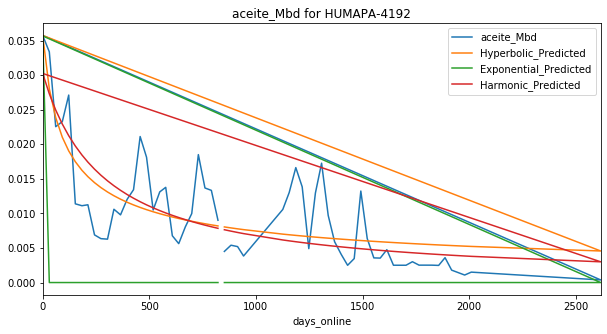

Exponential Fit Curve-fitted Variables: qi=0.040445849609375, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.022819536317394033, b=1.9999999999999998, di=0.001252108623201552
Harmonic Fit Curve-fitted Variables: qi=0.019801618024933416, di=0.0005454103298443328


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


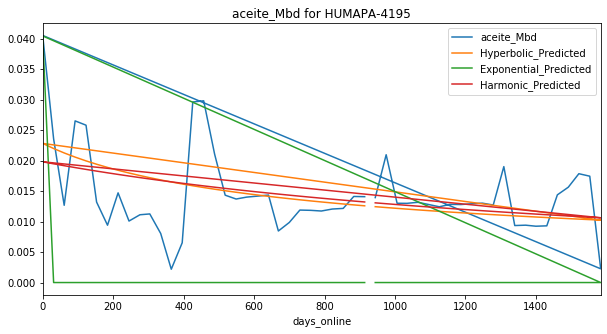

Exponential Fit Curve-fitted Variables: qi=0.04079899570652643, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.037801880794074545, b=1.9999999999999998, di=0.006738859620012984
Harmonic Fit Curve-fitted Variables: qi=0.018977453747289277, di=0.0004520865729272849


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


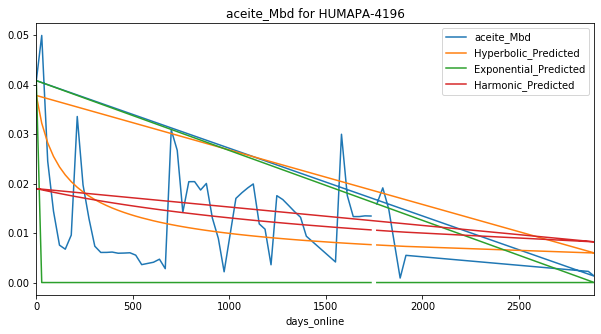

Exponential Fit Curve-fitted Variables: qi=0.000891882257988688, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.009536787763526035, b=0.00035877481797985666, di=1.2714228230611943e-12
Harmonic Fit Curve-fitted Variables: qi=0.009536780303593052, di=1.2985304573609121e-11


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


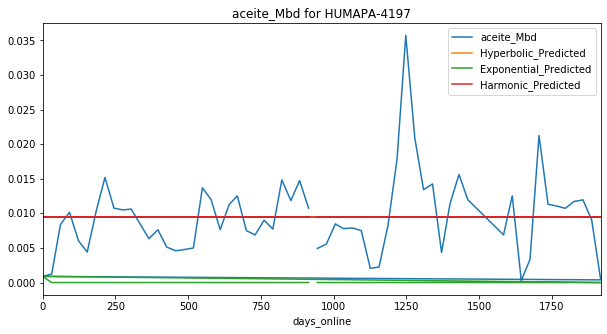

Exponential Fit Curve-fitted Variables: qi=0.01955232421875, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.014621522071479013, b=1.9999999999999998, di=0.001963845231711475
Harmonic Fit Curve-fitted Variables: qi=0.012274459957286675, di=0.0006502196188390112


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


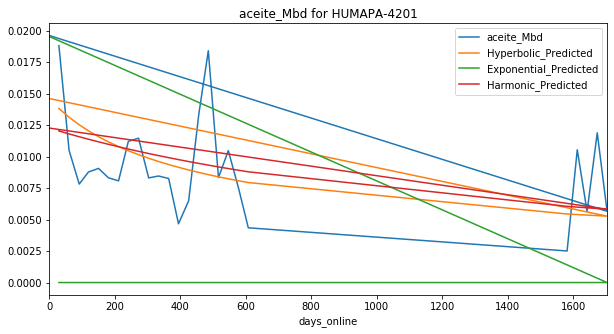

Exponential Fit Curve-fitted Variables: qi=0.050203753906249995, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.048206907746977806, b=1.9999999999999998, di=0.043593184162686344
Harmonic Fit Curve-fitted Variables: qi=0.01331237613159966, di=0.00044265934830375935


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


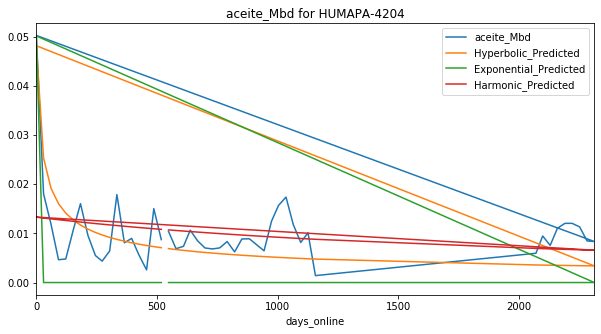

Exponential Fit Curve-fitted Variables: qi=0.03256000728232864, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.06412742414224956, b=1.35496533544309, di=0.009500088121199662
Harmonic Fit Curve-fitted Variables: qi=0.06394424583064141, di=0.007260686557840557


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


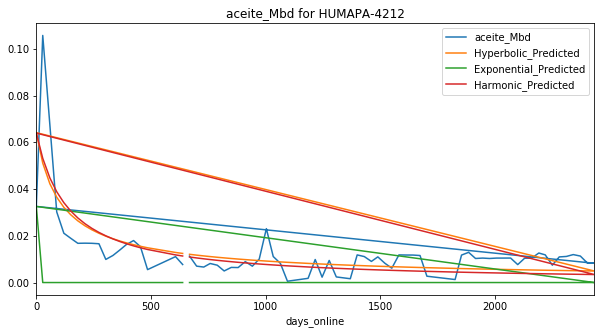

Exponential Fit Curve-fitted Variables: qi=0.016817966807470486, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.011509772484266144, b=1.9999999999999998, di=0.00017555034228912116
Harmonic Fit Curve-fitted Variables: qi=0.011187285610620957, di=0.00012433675238506856


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


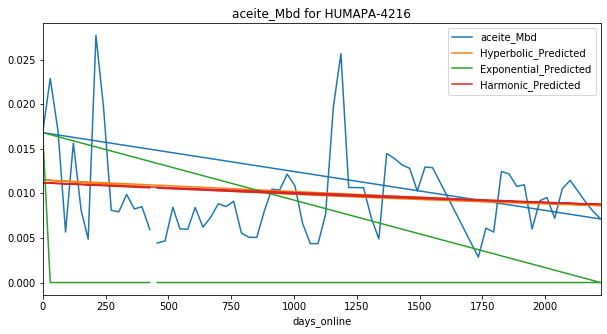

Exponential Fit Curve-fitted Variables: qi=0.02160787400331906, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.02713585368159479, b=0.3498541016973656, di=0.0038602628357990235
Harmonic Fit Curve-fitted Variables: qi=0.028120689494939927, di=0.005799147846749011


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


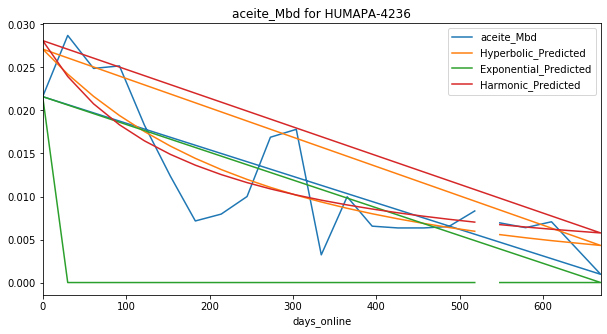

Exponential Fit Curve-fitted Variables: qi=0.06060975292968751, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.06061892793467872, b=1.9999999999999998, di=0.04613332486588539
Harmonic Fit Curve-fitted Variables: qi=0.05998505937190655, di=0.01576330975617607


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


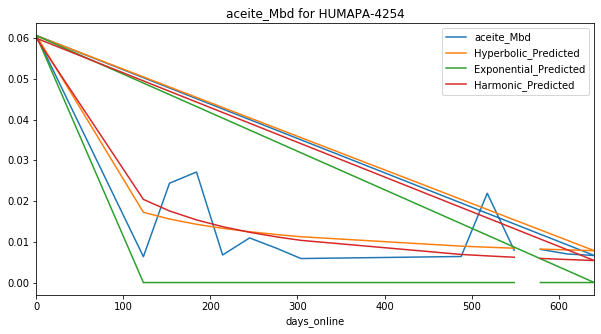

Exponential Fit Curve-fitted Variables: qi=0.016257808709677603, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.02143765159902764, b=1.9999999999950657, di=0.003853780231523746
Harmonic Fit Curve-fitted Variables: qi=0.018680331947646032, di=0.0016303502147188831


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


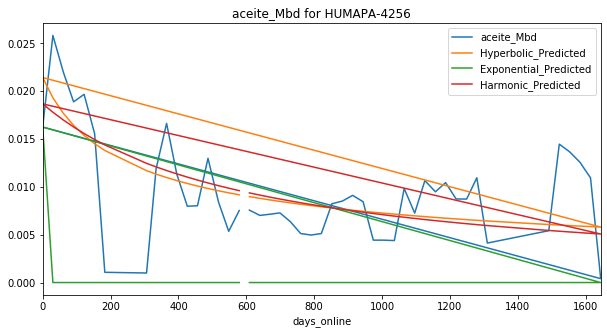

Exponential Fit Curve-fitted Variables: qi=0.32834181884765623, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.32842199999999994, b=0.3622060170567803, di=0.005778350141076016
Harmonic Fit Curve-fitted Variables: qi=0.32842199999999994, di=0.009800454869096174


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


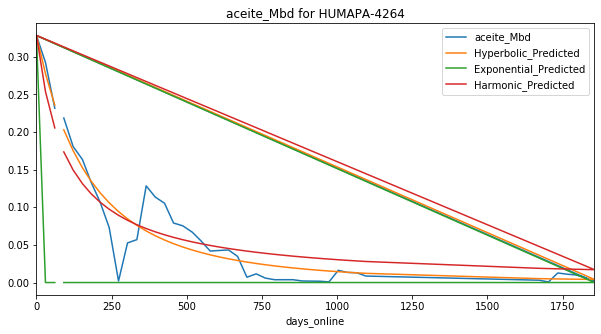

Exponential Fit Curve-fitted Variables: qi=0.03388069726562501, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.033947, b=1.33014722054157, di=0.008358434109931059
Harmonic Fit Curve-fitted Variables: qi=0.03394683282276646, di=0.006789126734706772


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


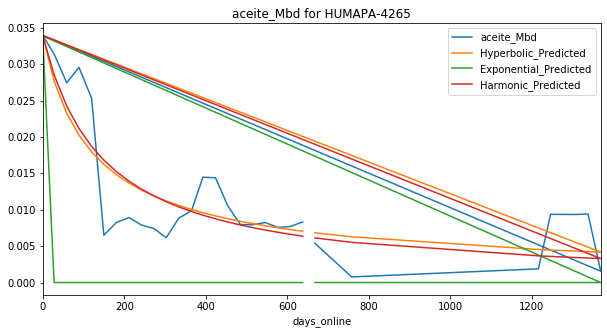

Exponential Fit Curve-fitted Variables: qi=0.0760067021484375, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.07608099999999998, b=1.7169955042460114, di=0.07047774221097054
Harmonic Fit Curve-fitted Variables: qi=0.07521438661387497, di=0.03267885556016279


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


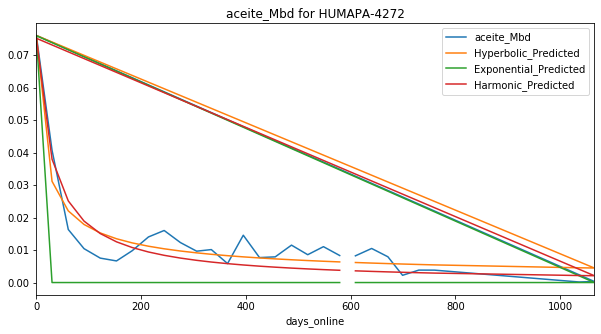

Exponential Fit Curve-fitted Variables: qi=0.00755309628949365, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.013630674109129666, b=4.3873623317574445e-08, di=0.0013152905344069167
Harmonic Fit Curve-fitted Variables: qi=0.01470722461864623, di=0.002592914726073289


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


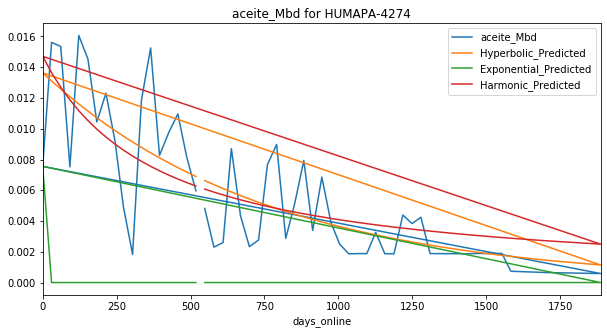

Exponential Fit Curve-fitted Variables: qi=0.010713007259295023, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.02727393423427728, b=0.6698205483140872, di=0.005676483868000173
Harmonic Fit Curve-fitted Variables: qi=0.027753597354408712, di=0.007444878481050449


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


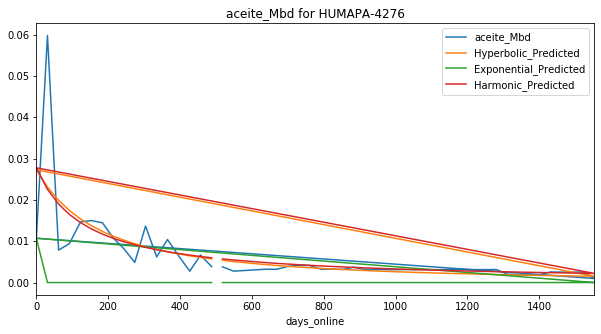

Exponential Fit Curve-fitted Variables: qi=0.006457675439724802, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.015083397924409605, b=1.7131317842619225, di=0.0006911657272863262
Harmonic Fit Curve-fitted Variables: qi=0.014886392810310735, di=0.0005574570073303916


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


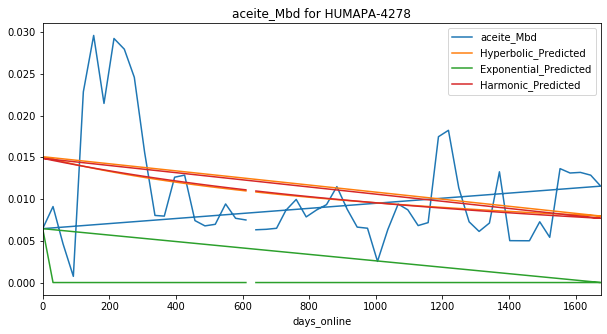

Exponential Fit Curve-fitted Variables: qi=0.035772994140625, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.027776291405492516, b=1.9999999999999998, di=0.008962991202455554
Harmonic Fit Curve-fitted Variables: qi=0.01913025988535425, di=0.0017933964008722569


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


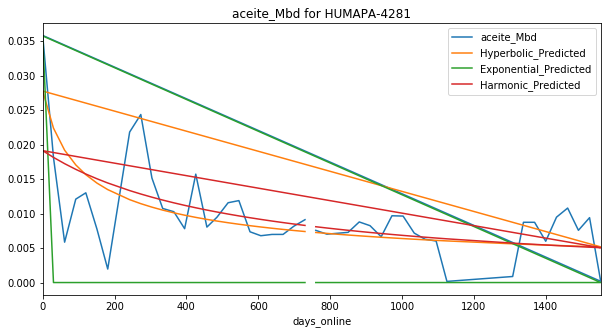

Exponential Fit Curve-fitted Variables: qi=0.02072572265625, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.0159848659122845, b=1.999999993509418, di=0.0015924365465617488
Harmonic Fit Curve-fitted Variables: qi=0.015226337809233893, di=0.0010119469924122458


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


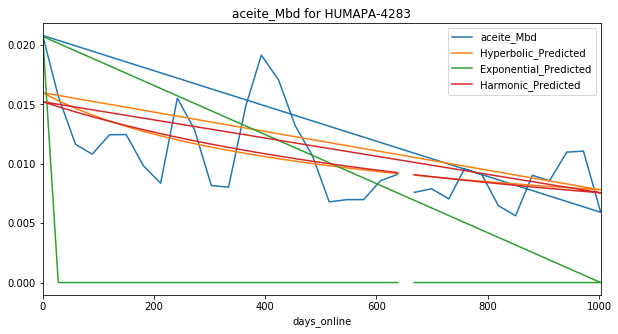

Exponential Fit Curve-fitted Variables: qi=0.06662999626323077, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.07341525845601983, b=1.9999999999999998, di=0.024898087886944045
Harmonic Fit Curve-fitted Variables: qi=0.06936462923027495, di=0.009769082609884397


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


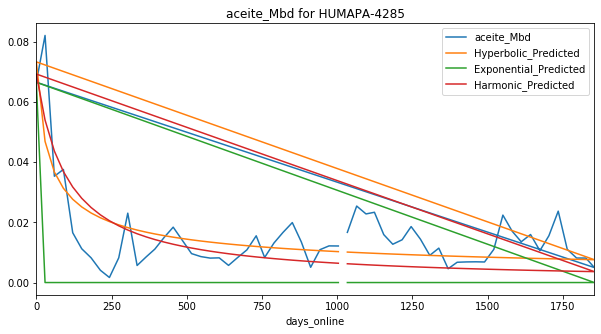

Exponential Fit Curve-fitted Variables: qi=0.053333865234375, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.052931497648492476, b=1.9361835096748492, di=0.07321347764176069
Harmonic Fit Curve-fitted Variables: qi=0.046413391958043504, di=0.018122719771511135


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


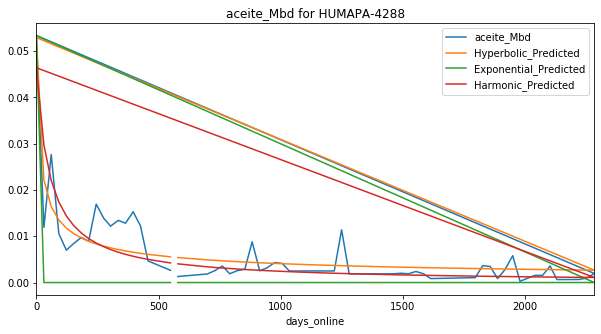

Exponential Fit Curve-fitted Variables: qi=0.03358224405261904, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.036902563748573175, b=0.54358493388652, di=0.004636386391225514
Harmonic Fit Curve-fitted Variables: qi=0.03755741959916693, di=0.006472686344667362


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


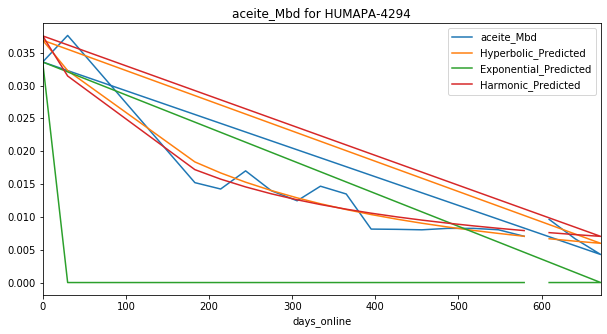

Exponential Fit Curve-fitted Variables: qi=0.059549789062500004, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.05934596527081884, b=1.9999999999999998, di=0.05894396698302199
Harmonic Fit Curve-fitted Variables: qi=0.05358451740162089, di=0.01805233404011176


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


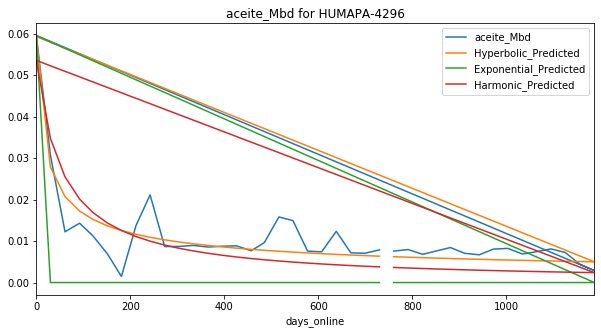

Exponential Fit Curve-fitted Variables: qi=0.054468755859375, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.05452173750492241, b=1.9999999995375775, di=0.07994594582782744
Harmonic Fit Curve-fitted Variables: qi=0.05452198939618352, di=0.029704009346032106


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


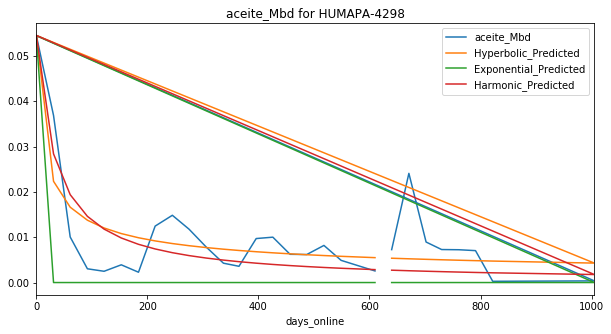

Exponential Fit Curve-fitted Variables: qi=0.013007975397711447, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.013388091900582436, b=1.9999999999997742, di=0.001457667416258527
Harmonic Fit Curve-fitted Variables: qi=0.012296011019771153, di=0.0007957003302022772


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


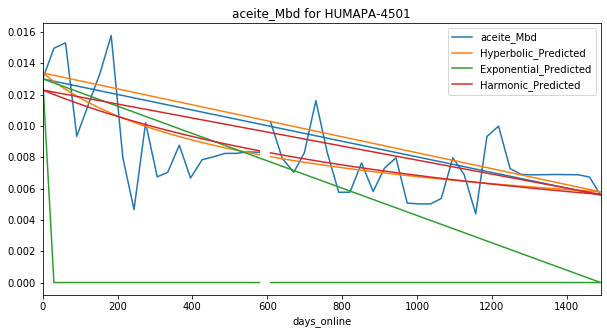

Exponential Fit Curve-fitted Variables: qi=0.026204529471638385, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.03253232627228415, b=1.0777730666834118, di=0.009247838315772916
Harmonic Fit Curve-fitted Variables: qi=0.03222472023219595, di=0.008515285917024622


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


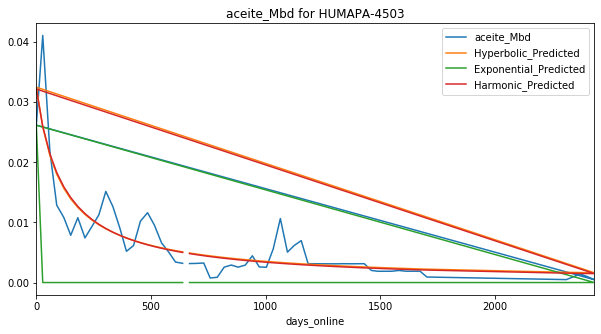

Exponential Fit Curve-fitted Variables: qi=0.013757852573370857, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.013962115926605016, b=1.9999999957267294, di=0.0020364073985974637
Harmonic Fit Curve-fitted Variables: qi=0.012602010211702621, di=0.0010243499353353195


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


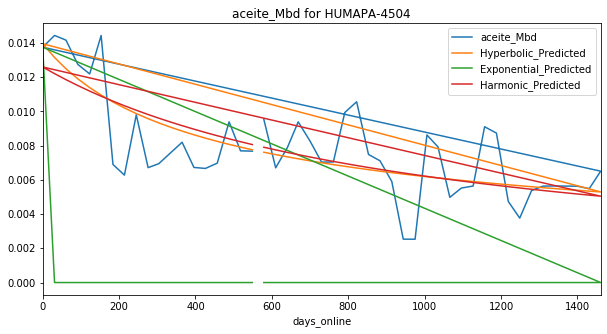

Exponential Fit Curve-fitted Variables: qi=0.021997941526807195, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.021262806830192126, b=1.9999999999999998, di=0.003976826591663064
Harmonic Fit Curve-fitted Variables: qi=0.01294748631346272, di=0.000411511230162902


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


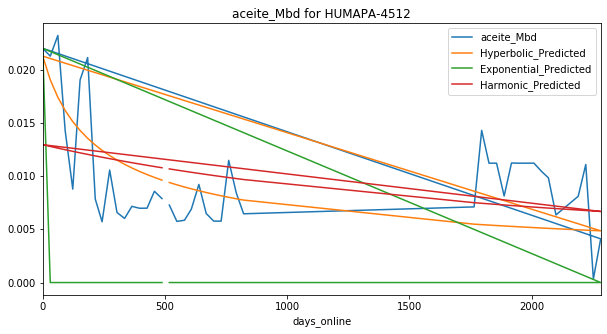

Exponential Fit Curve-fitted Variables: qi=0.026535072265625, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.0237040761638849, b=1.9999999999999998, di=0.0057445782640962026
Harmonic Fit Curve-fitted Variables: qi=0.017403110127520122, di=0.0014563181529882205


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


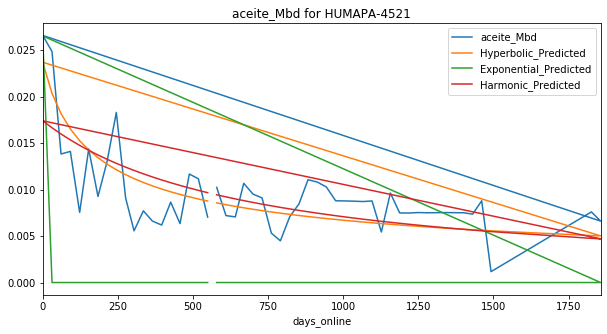

Exponential Fit Curve-fitted Variables: qi=0.021923393972107713, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.0240719433737743, b=1.6133095438998086, di=0.010853901042241355
Harmonic Fit Curve-fitted Variables: qi=0.022505744926766685, di=0.005598145327188924


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


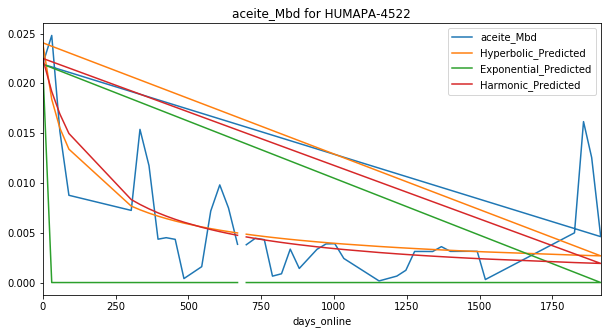

Exponential Fit Curve-fitted Variables: qi=0.022053959554065652, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.023397270865879085, b=1.9999999999834666, di=0.008983353097691552
Harmonic Fit Curve-fitted Variables: qi=0.020557711889997193, di=0.0037523115825379167


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


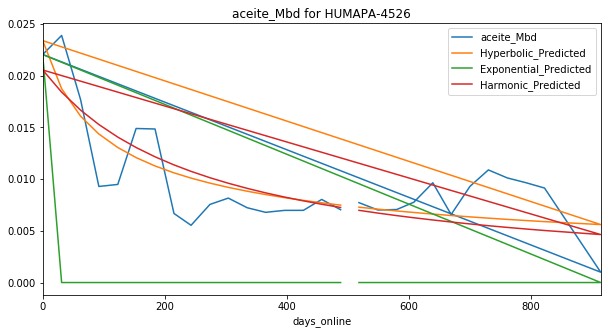

Exponential Fit Curve-fitted Variables: qi=0.007538489415888089, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.015798600093863704, b=1.9999999999999998, di=0.0012193627201514152
Harmonic Fit Curve-fitted Variables: qi=0.013181163906465643, di=0.00044804663367716837


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


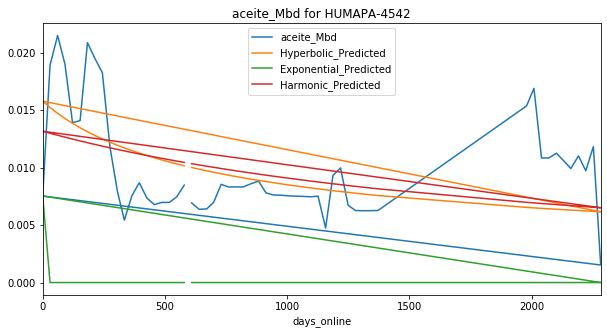

Exponential Fit Curve-fitted Variables: qi=0.011792085956096262, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.010020618090960961, b=1.9999999999291846, di=0.00025462238549928845
Harmonic Fit Curve-fitted Variables: qi=0.009857570792236816, di=0.00020176845689961147


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


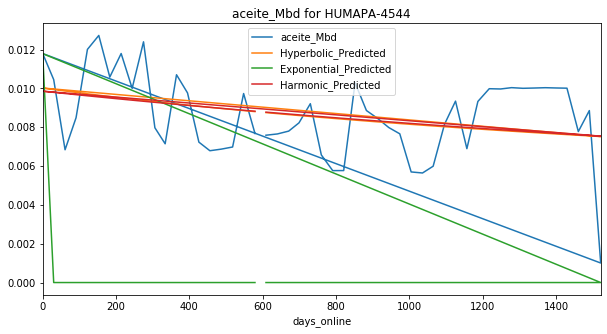

Exponential Fit Curve-fitted Variables: qi=0.10008298819002925, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.14609899584925967, b=0.22447002405114025, di=0.008533638265974476
Harmonic Fit Curve-fitted Variables: qi=0.1452875826722837, di=0.015776183836955945


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


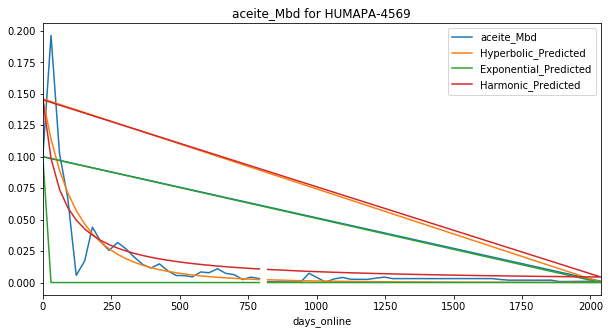

Exponential Fit Curve-fitted Variables: qi=0.0025762617049771342, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.010053802362870972, b=1.111516309944033e-05, di=1.4097974128073633e-05
Harmonic Fit Curve-fitted Variables: qi=0.010017243011314741, di=1.2431085400396383e-05


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


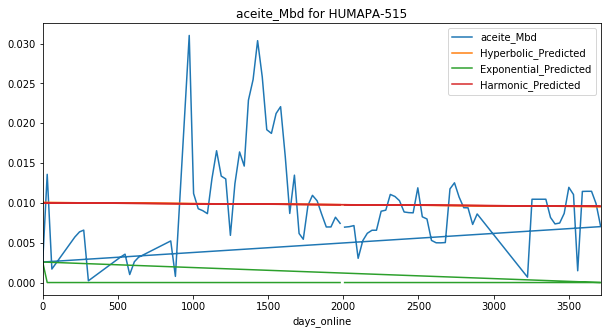

Exponential Fit Curve-fitted Variables: qi=0.025658787109374998, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.020443032268054752, b=1.9999999999999998, di=0.004674624124658336
Harmonic Fit Curve-fitted Variables: qi=0.017658880854006846, di=0.0019606913457177336


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


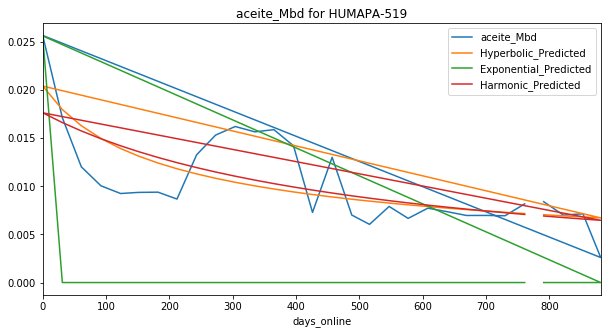

Exponential Fit Curve-fitted Variables: qi=0.005477371096289081, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.006158999967528831, b=3.848891597782412e-05, di=1.1836819461272573e-05
Harmonic Fit Curve-fitted Variables: qi=0.006158999999999995, di=1.00818469135996e-05


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


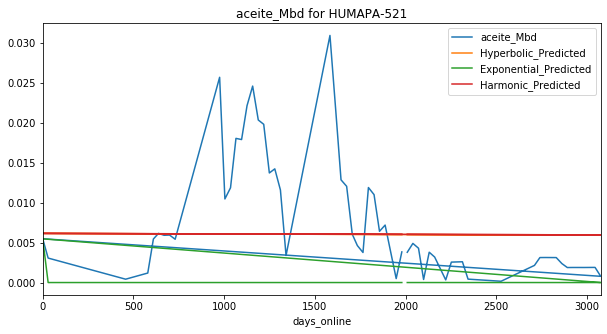

Exponential Fit Curve-fitted Variables: qi=0.0009298997265268915, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.0020199999953397626, b=1.999999999994486, di=5.334397238864268e-11
Harmonic Fit Curve-fitted Variables: qi=0.0020199999998421025, di=3.41303909865643e-13


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


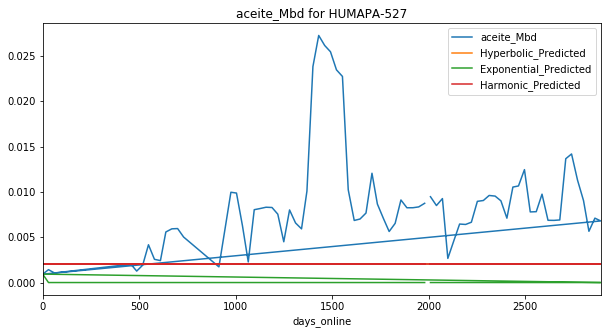

Exponential Fit Curve-fitted Variables: qi=0.006300001108155639, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.011425302157401736, b=1.9999999999999998, di=0.00017425941167845886
Harmonic Fit Curve-fitted Variables: qi=0.010827212826887091, di=9.743031854233293e-05


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


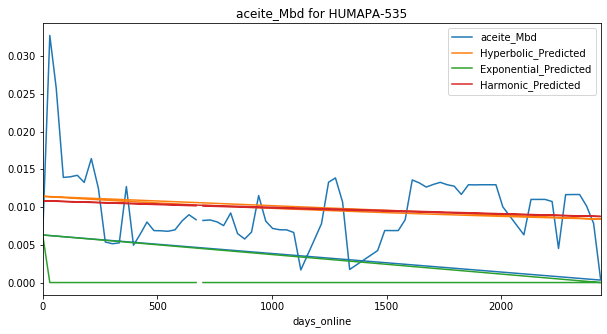

Exponential Fit Curve-fitted Variables: qi=0.1282433505859375, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.1283059999999995, b=1.263154095281276, di=0.03048107807227277
Harmonic Fit Curve-fitted Variables: qi=0.1283059967031888, di=0.02370728261548975


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


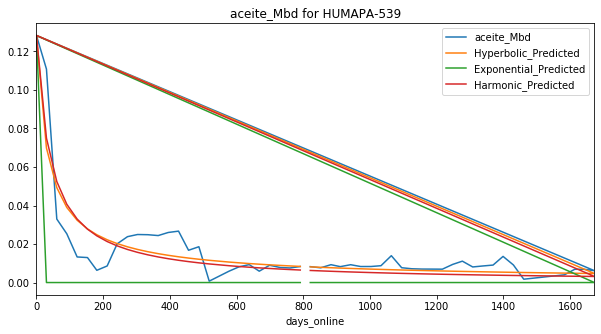

Exponential Fit Curve-fitted Variables: qi=0.013863687416871055, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.01387920848400551, b=1.7809556706813474, di=0.0009307686378650806
Harmonic Fit Curve-fitted Variables: qi=0.013456419936342603, di=0.0006745656950024469


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


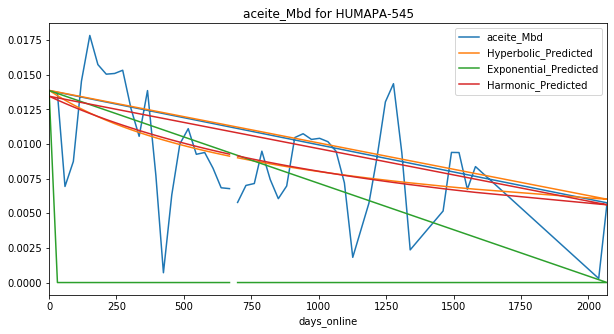

Exponential Fit Curve-fitted Variables: qi=0.006888100360029496, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.021465802564898735, b=1.9999999977558436, di=0.002617276630085552
Harmonic Fit Curve-fitted Variables: qi=0.01898915517090468, di=0.0011394043880239044


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


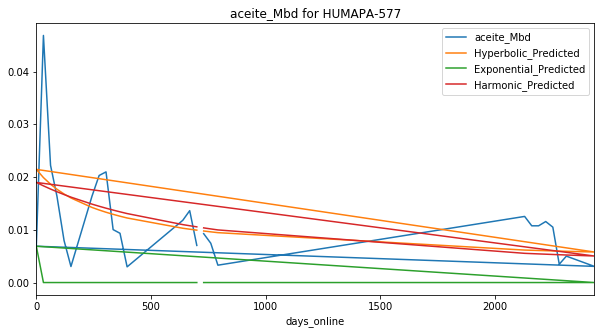

Exponential Fit Curve-fitted Variables: qi=0.011647298539337832, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.05410778399227546, b=0.10894056144092376, di=0.0035441813352607553
Harmonic Fit Curve-fitted Variables: qi=0.05539948478063606, di=0.006671943050843135


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


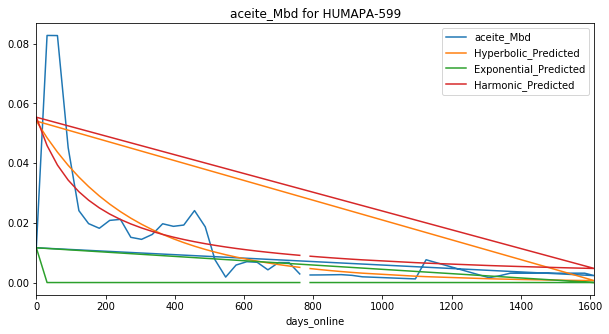

Exponential Fit Curve-fitted Variables: qi=0.019410980504629805, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.02245768185838249, b=0.26739679049541887, di=0.001717371565380619
Harmonic Fit Curve-fitted Variables: qi=0.02400883998679326, di=0.0028817241924698218


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


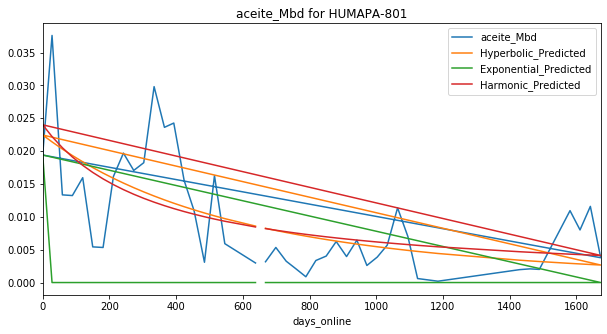

Exponential Fit Curve-fitted Variables: qi=0.01899117956398565, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.02754425060931076, b=1.9999999999999998, di=0.004898087564279749
Harmonic Fit Curve-fitted Variables: qi=0.018273821434723784, di=0.0009001517686810812


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


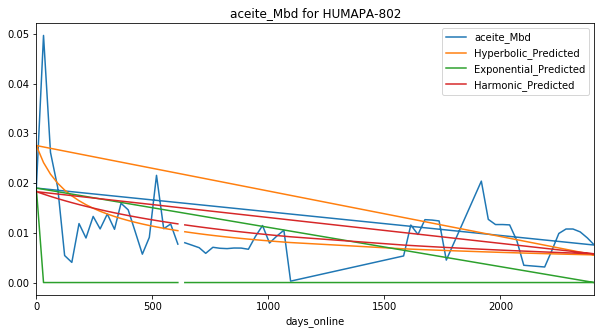

Exponential Fit Curve-fitted Variables: qi=0.009457000437155657, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.05287539005404133, b=0.8675450261074279, di=0.0035631076569126226
Harmonic Fit Curve-fitted Variables: qi=0.05339423403014861, di=0.0039432805955969645


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


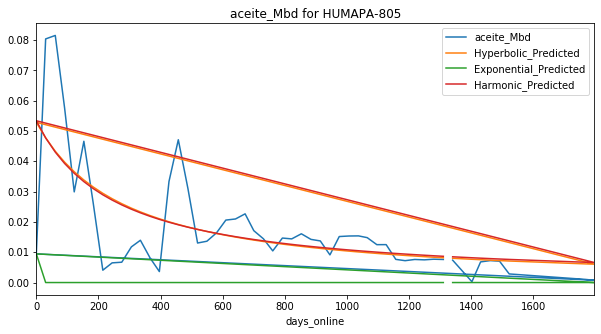

Exponential Fit Curve-fitted Variables: qi=0.011595226902617323, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.018236516828417794, b=6.522922948635417e-08, di=0.00034810718215513804
Harmonic Fit Curve-fitted Variables: qi=0.018272965068926776, di=0.0004365100243630021


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


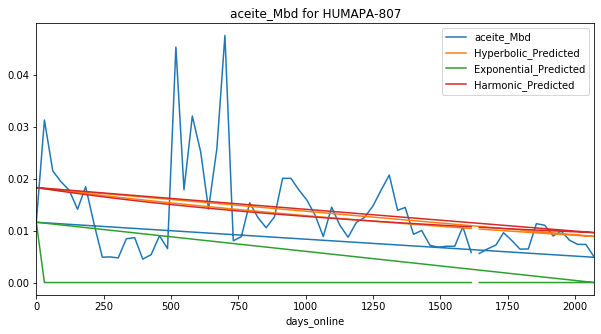

Exponential Fit Curve-fitted Variables: qi=0.006747973765647432, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.010938201744725973, b=1.9999998460153152, di=3.7071433126316386e-05
Harmonic Fit Curve-fitted Variables: qi=0.01093023180526178, di=3.5376179160213515e-05


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


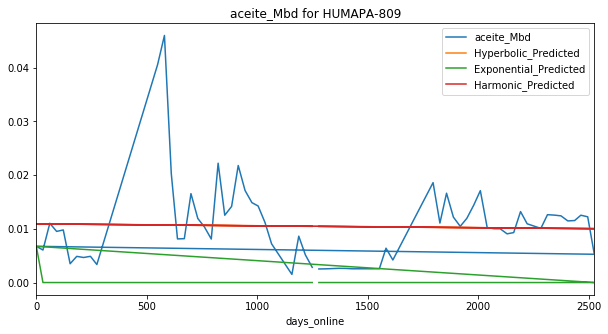

Exponential Fit Curve-fitted Variables: qi=0.009716959020663727, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.012517740415311212, b=0.6983274832653193, di=0.000274043779561421
Harmonic Fit Curve-fitted Variables: qi=0.012545130759718108, di=0.00029040843305133554


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


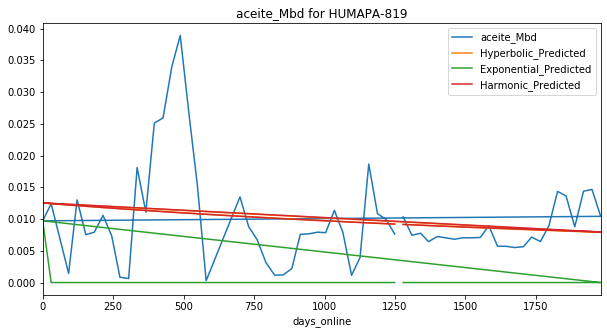

Exponential Fit Curve-fitted Variables: qi=0.0118655703125, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.010455299505226614, b=1.9999999999570053, di=7.945308861655118e-05
Harmonic Fit Curve-fitted Variables: qi=0.010408829736074484, di=7.023986624596986e-05


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


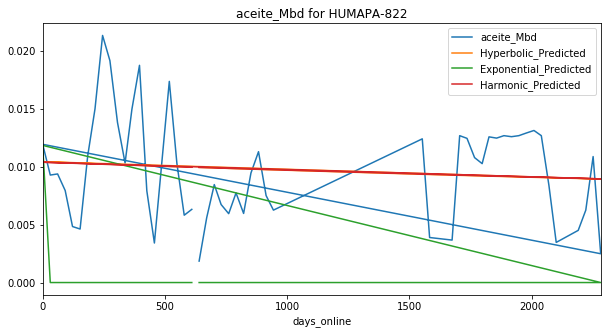

Exponential Fit Curve-fitted Variables: qi=0.09210896191406251, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.09219899796919155, b=1.9999999999999998, di=0.09122142607106148
Harmonic Fit Curve-fitted Variables: qi=0.09107540603475343, di=0.02892165319628623


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


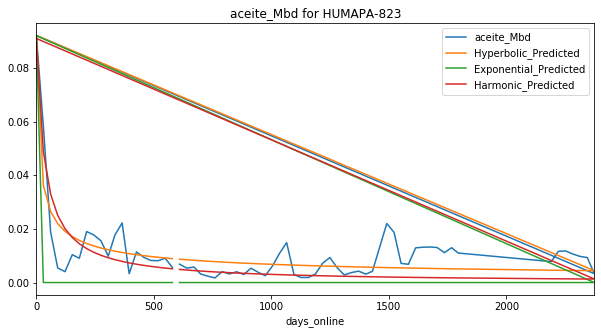

Exponential Fit Curve-fitted Variables: qi=0.0591831474609375, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.05924099999999929, b=1.5992845744697715, di=0.032452868641916745
Harmonic Fit Curve-fitted Variables: qi=0.055489768909398676, di=0.01560489881696134


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


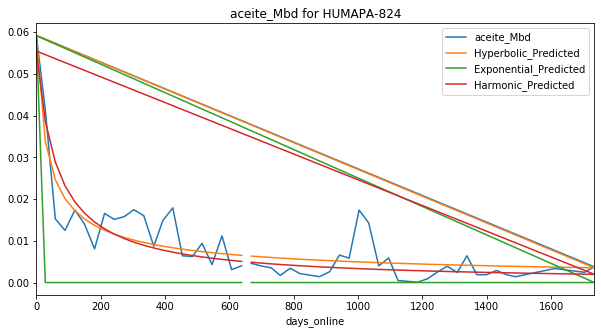

Exponential Fit Curve-fitted Variables: qi=0.0154275, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.009752445139731105, b=4.297717616128093e-12, di=0.0001674968864409519
Harmonic Fit Curve-fitted Variables: qi=0.009616909397412027, di=0.00015918044418348375


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


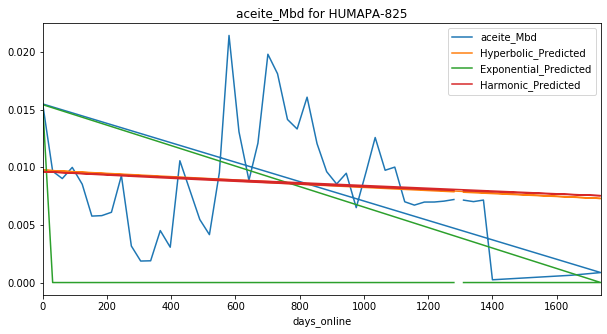

Exponential Fit Curve-fitted Variables: qi=0.01486500003586457, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.03263483377686521, b=1.8660666322837873, di=0.005810959360549138
Harmonic Fit Curve-fitted Variables: qi=0.029651932601689104, di=0.0026688034035604893


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


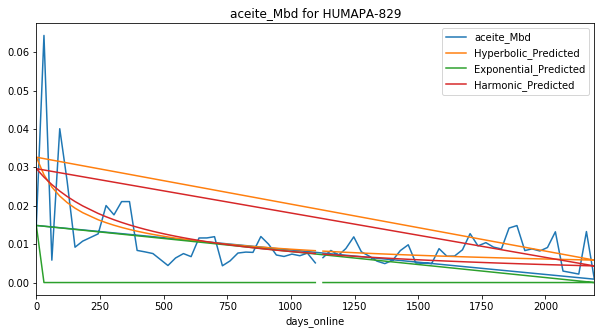

Exponential Fit Curve-fitted Variables: qi=0.027002745189106097, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.010858310002584482, b=1.2777999106279375e-08, di=2.3324022501227385e-05
Harmonic Fit Curve-fitted Variables: qi=0.010825361955387733, di=2.0463926242086465e-05


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


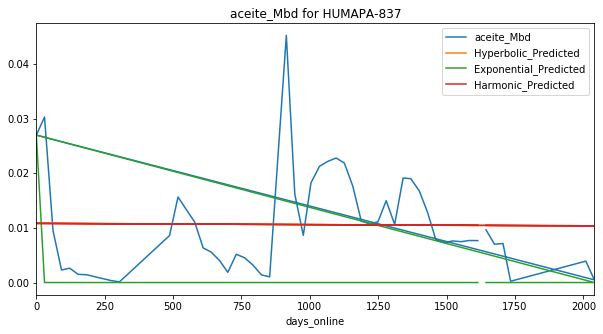

Exponential Fit Curve-fitted Variables: qi=0.035988572265625005, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.036058999999999196, b=1.9999999999999998, di=0.01674412659805297
Harmonic Fit Curve-fitted Variables: qi=0.028352300614425223, di=0.00437332707646478


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


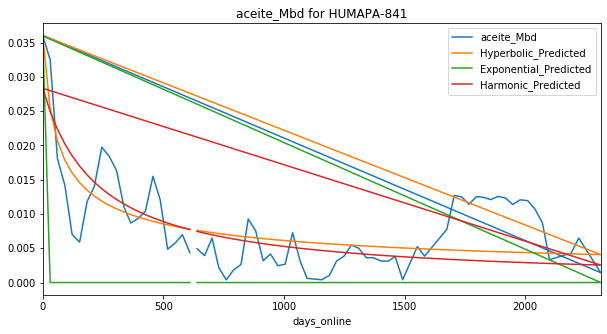

Exponential Fit Curve-fitted Variables: qi=0.04296591796875, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.03555120663553918, b=1.9999999999999998, di=0.010512784189546303
Harmonic Fit Curve-fitted Variables: qi=0.018851390665535935, di=0.0010527054873099501


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


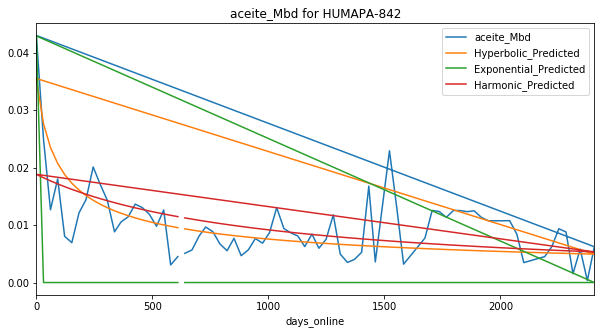

Exponential Fit Curve-fitted Variables: qi=0.08007299996359749, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.10000769175550328, b=0.8954740007820976, di=0.015017455201375247
Harmonic Fit Curve-fitted Variables: qi=0.09973111475416274, di=0.016194063448173222


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


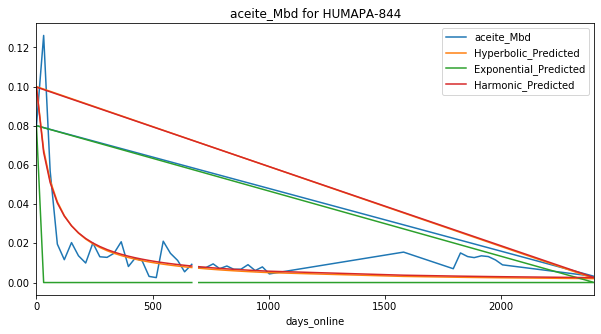

Exponential Fit Curve-fitted Variables: qi=0.057134000456382256, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.10841441061563396, b=0.5103489599353285, di=0.003189907715435803
Harmonic Fit Curve-fitted Variables: qi=0.11139021252975699, di=0.0047051079888978005


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


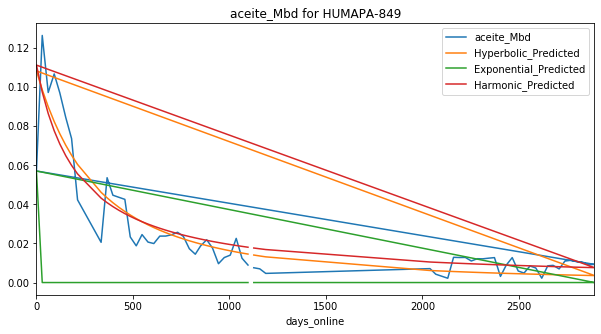

Exponential Fit Curve-fitted Variables: qi=0.042166482421875, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.03290494361151788, b=0.9460357187577508, di=0.001935885168929042
Harmonic Fit Curve-fitted Variables: qi=0.033037030941607065, di=0.00200462744627532


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


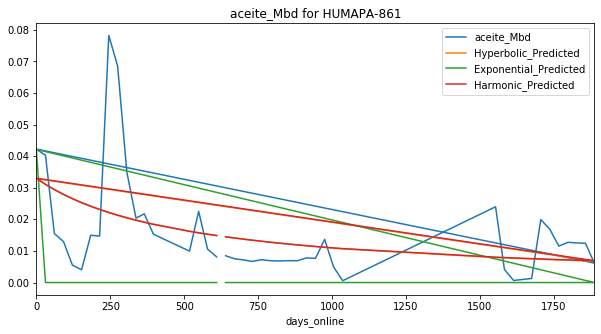

Exponential Fit Curve-fitted Variables: qi=0.009329009988519722, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.02562638574917626, b=1.9999999999999998, di=0.006732129430815131
Harmonic Fit Curve-fitted Variables: qi=0.02260795487832948, di=0.002717975412185317


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


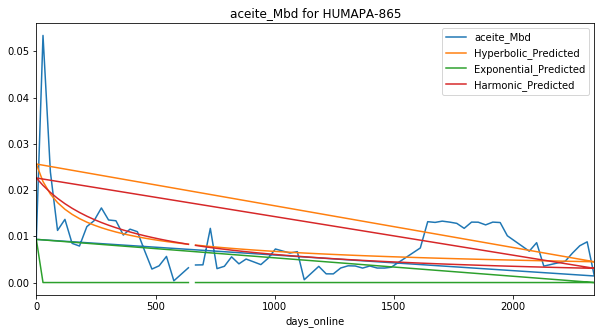

Exponential Fit Curve-fitted Variables: qi=0.029732003275491796, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.05344470155570521, b=1.4541004652637706, di=0.006547114061901931
Harmonic Fit Curve-fitted Variables: qi=0.05104761291674947, di=0.004277969685278438


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


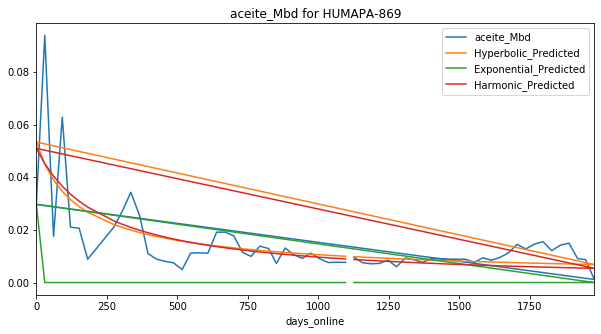

Exponential Fit Curve-fitted Variables: qi=0.011939310474561227, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.011642054700160819, b=5.188283510711609e-08, di=0.0007824550386531091
Harmonic Fit Curve-fitted Variables: qi=0.01145856246789479, di=0.0008855514264859091


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


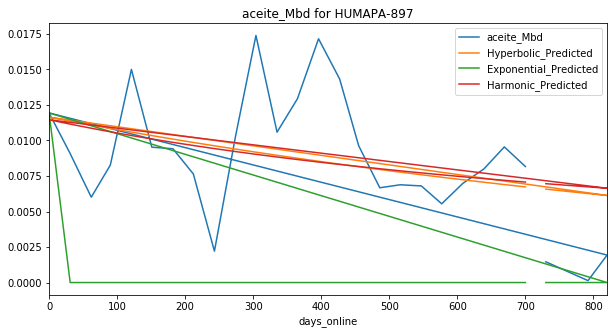

Exponential Fit Curve-fitted Variables: qi=0.09326900003247453, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.1679216064187088, b=3.74915541690669e-08, di=0.010202753953117373
Harmonic Fit Curve-fitted Variables: qi=0.15199814028233555, di=0.017246184256622266


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


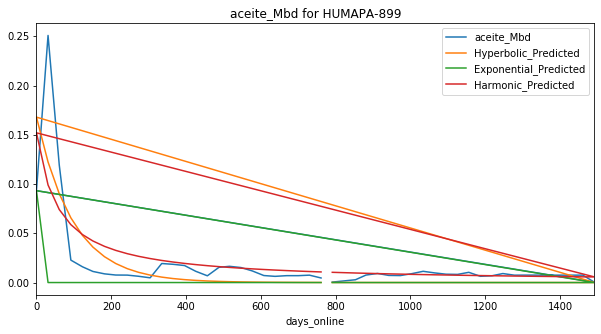

Exponential Fit Curve-fitted Variables: qi=0.006083645481414971, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.014844531193961086, b=4.037527934882712e-06, di=0.00013213989811410983
Harmonic Fit Curve-fitted Variables: qi=0.014732502286997294, di=0.00014131768797089191


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


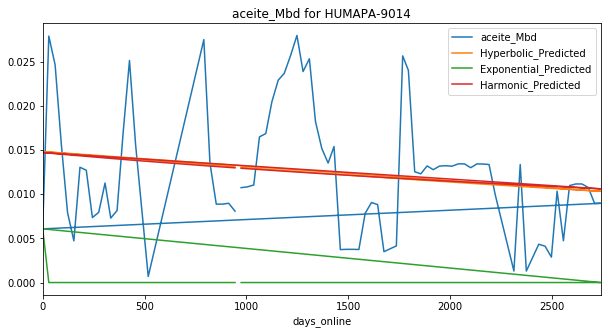

Exponential Fit Curve-fitted Variables: qi=0.03454994287054179, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.03211415461203541, b=1.9999999999999998, di=0.002121631030284947
Harmonic Fit Curve-fitted Variables: qi=0.02896128139074171, di=0.001070986751424798


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


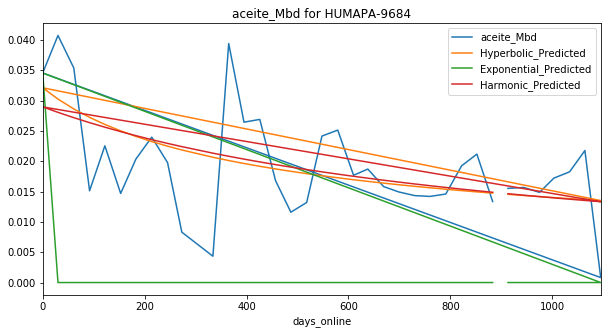

Exponential Fit Curve-fitted Variables: qi=0.050831525390625, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.05093099999999988, b=1.9999999999999998, di=0.0144759231952048
Harmonic Fit Curve-fitted Variables: qi=0.03680755015435052, di=0.0032272870168364516


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


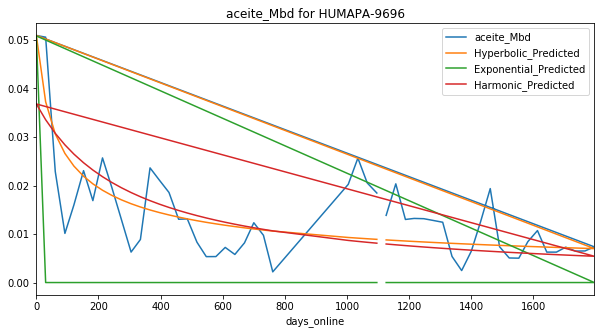

Exponential Fit Curve-fitted Variables: qi=0.13708003369140626, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.13714699999999996, b=1.7699146581256295, di=0.06930288370459158
Harmonic Fit Curve-fitted Variables: qi=0.13652908832746058, di=0.030276865689732854


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


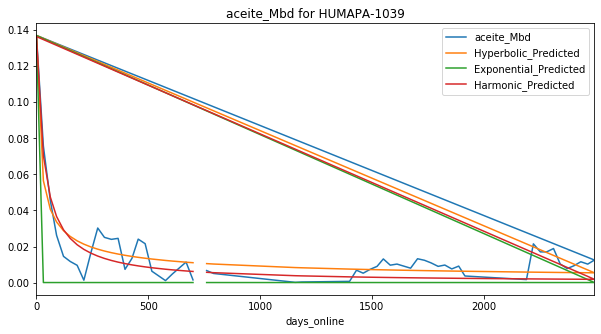

Exponential Fit Curve-fitted Variables: qi=0.5127194045410156, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.5127819999999998, b=3.043640122203741e-07, di=0.006100318137489101
Harmonic Fit Curve-fitted Variables: qi=0.5127819999999998, di=0.01421826754255973


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


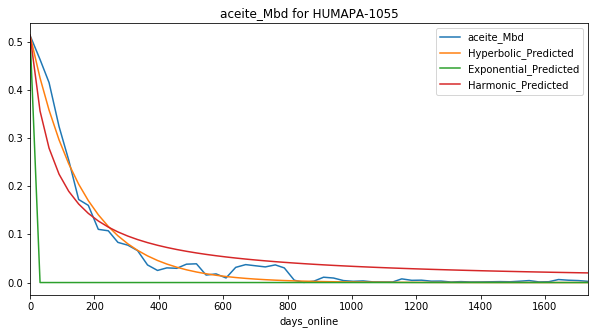

Exponential Fit Curve-fitted Variables: qi=0.02616679296875, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.01110254928535375, b=1.9999999999999998, di=0.000978554328501018
Harmonic Fit Curve-fitted Variables: qi=0.009164417663348912, di=0.00029901582388698383


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


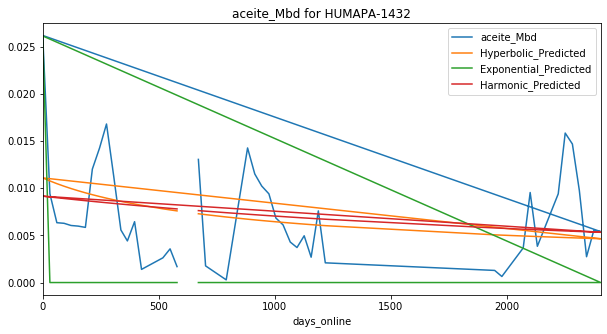

Exponential Fit Curve-fitted Variables: qi=0.044693537109375, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.04203337640391075, b=1.999999999999698, di=0.026561445819968516
Harmonic Fit Curve-fitted Variables: qi=0.029028077457962216, di=0.004447362702452995


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


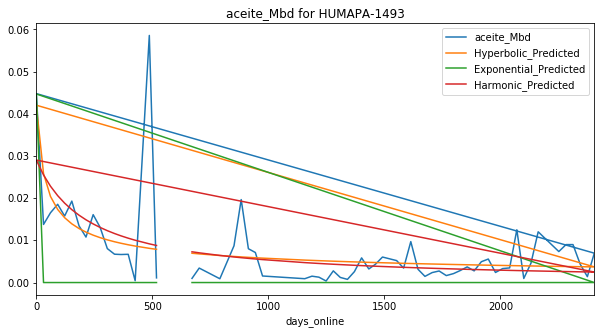

Exponential Fit Curve-fitted Variables: qi=0.017398064824135712, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.014082457919615057, b=1.9999999999978875, di=0.0018418228728255927
Harmonic Fit Curve-fitted Variables: qi=0.013104319479660833, di=0.0010586836891495026


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


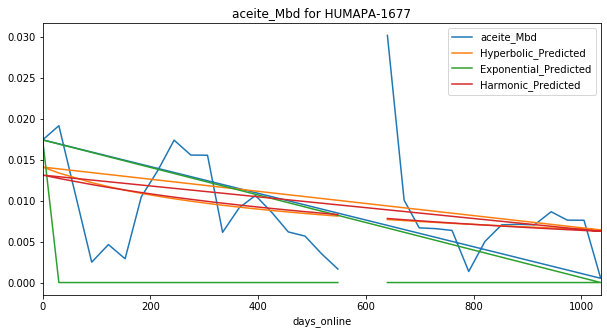

Exponential Fit Curve-fitted Variables: qi=0.074055609375, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.0737076292787552, b=1.1980263246403504, di=0.006089251936560902
Harmonic Fit Curve-fitted Variables: qi=0.0706317674808076, di=0.004734867825029752


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


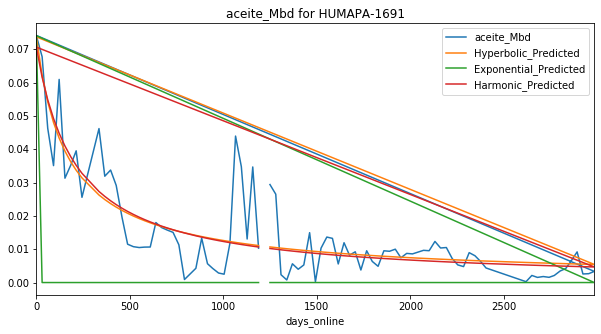

Exponential Fit Curve-fitted Variables: qi=0.006940309210550352, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.07230707333793554, b=0.49266751865357683, di=0.0018752530787991954
Harmonic Fit Curve-fitted Variables: qi=0.07383198121147598, di=0.0025894518318706644


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


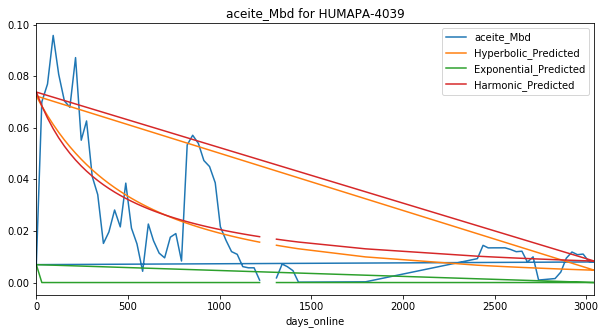

Exponential Fit Curve-fitted Variables: qi=0.009693316312502682, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.06432306359759138, b=0.7867715212994995, di=0.005843879796377081
Harmonic Fit Curve-fitted Variables: qi=0.06324879145365604, di=0.006390252415026172


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


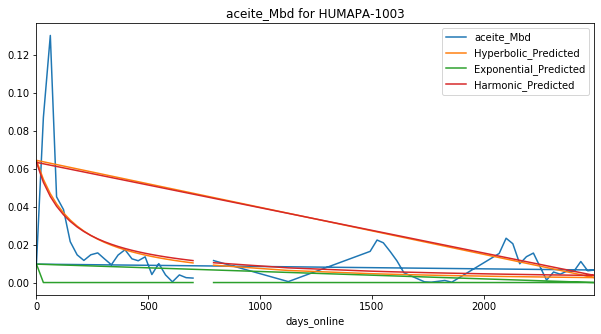

Exponential Fit Curve-fitted Variables: qi=0.06300940722656251, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.05895241761445717, b=1.9999999999999998, di=0.02579182397051807
Harmonic Fit Curve-fitted Variables: qi=0.032067313941037685, di=0.002408489615335202


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


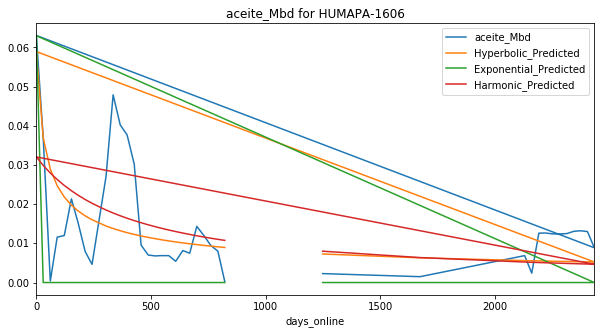

Exponential Fit Curve-fitted Variables: qi=0.007208000569254559, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.03207627184785047, b=5.312398726524481e-10, di=0.000553747374819094
Harmonic Fit Curve-fitted Variables: qi=0.03162329892944591, di=0.0007351363942851696


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


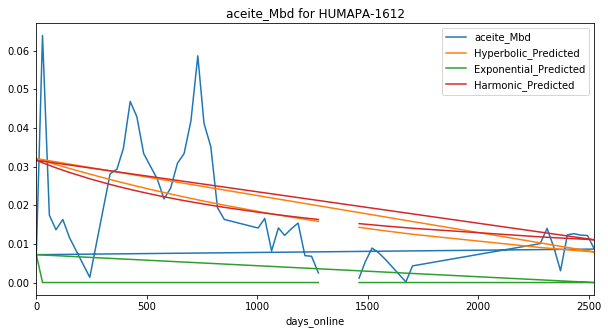

Exponential Fit Curve-fitted Variables: qi=0.017786076371979462, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.028664262626248847, b=0.31454009237519726, di=0.00035552128172415445
Harmonic Fit Curve-fitted Variables: qi=0.029686248116364663, di=0.0004969025763906422


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


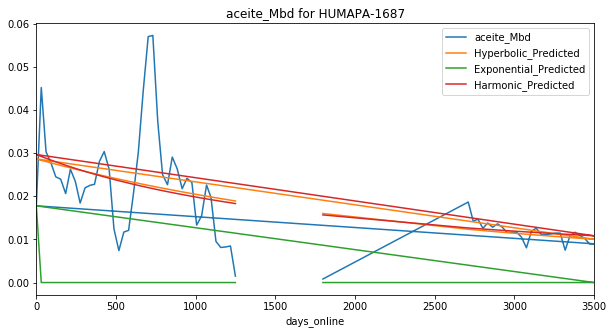

Exponential Fit Curve-fitted Variables: qi=0.007581190071291963, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.012278293828451872, b=1.9997015201213189, di=9.752094153822418e-11
Harmonic Fit Curve-fitted Variables: qi=0.012278294875584605, di=2.6416694457580717e-11


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


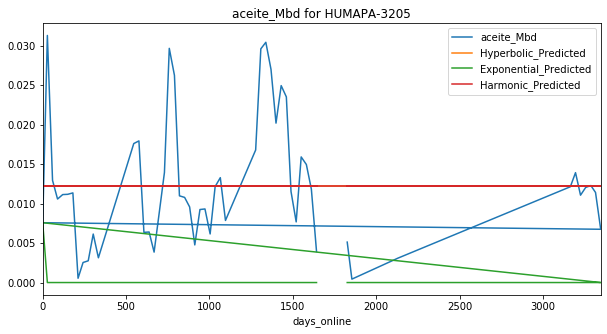

Exponential Fit Curve-fitted Variables: qi=0.027146874999999997, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.022303506615139763, b=1.1201311072514552e-06, di=0.00042900974381106596
Harmonic Fit Curve-fitted Variables: qi=0.021542049822606553, di=0.0004810548526606972


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


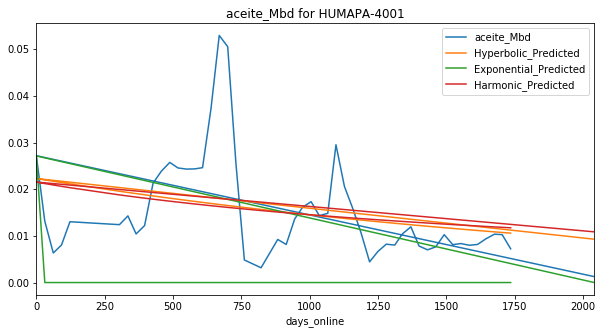

Exponential Fit Curve-fitted Variables: qi=0.02552481287714061, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.01883918501836463, b=1.9999999999887503, di=0.00024504566696593327
Harmonic Fit Curve-fitted Variables: qi=0.018354990541967584, di=0.00017785724358540363


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


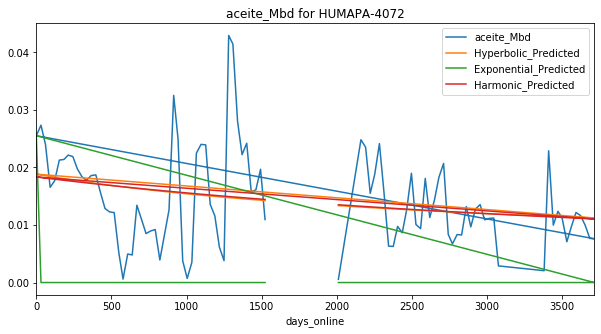

Exponential Fit Curve-fitted Variables: qi=0.002998116962844586, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.02391932713080889, b=2.0570737073272775e-08, di=0.0002550350162654593
Harmonic Fit Curve-fitted Variables: qi=0.023324500307859573, di=0.00025965840239196183


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


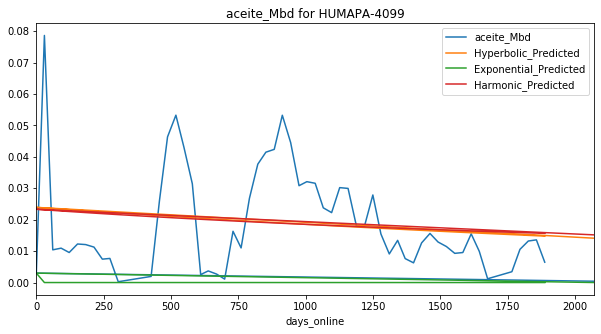

Exponential Fit Curve-fitted Variables: qi=0.038821990023819954, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.04737933475686571, b=1.0518535229805777, di=0.013458075716534434
Harmonic Fit Curve-fitted Variables: qi=0.047337226886146125, di=0.01296086743941536


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


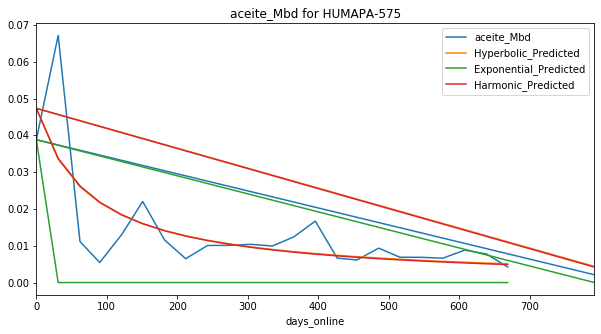

Exponential Fit Curve-fitted Variables: qi=0.01687112615986066, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.00873301146704624, b=5.880193110208154e-08, di=1.0033975565363309e-13
Harmonic Fit Curve-fitted Variables: qi=0.008733003128972692, di=1.2284839720400892e-11


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


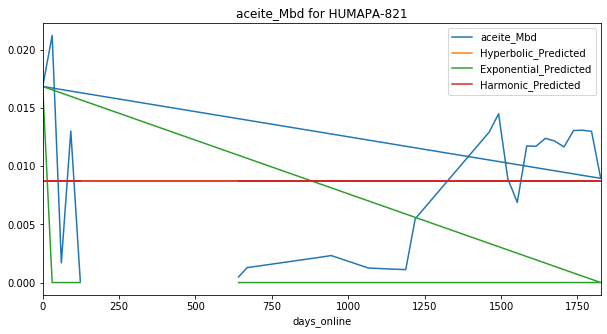

Exponential Fit Curve-fitted Variables: qi=0.01484302623134851, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.0825334370574602, b=0.29563272228007886, di=0.006474099899490382
Harmonic Fit Curve-fitted Variables: qi=0.07878054114782894, di=0.00939155291347559


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


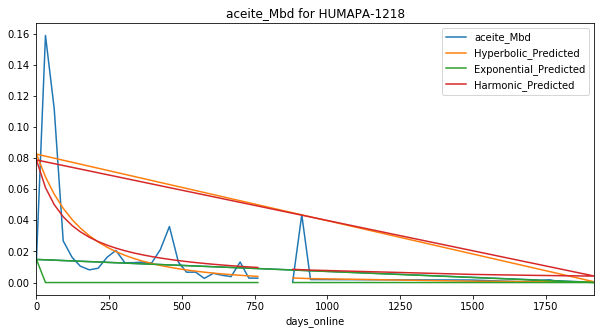

Exponential Fit Curve-fitted Variables: qi=0.0307438359375, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.02426696446921872, b=0.22394406413689566, di=0.00043652964014480084
Harmonic Fit Curve-fitted Variables: qi=0.024651095152858665, di=0.0005998368807048608


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


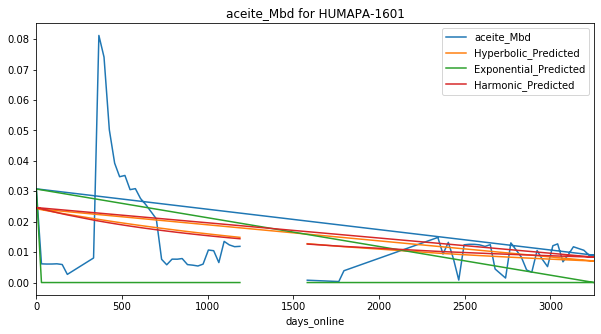

Exponential Fit Curve-fitted Variables: qi=0.04263899850296341, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.06277499999999998, b=2.2897454039673014e-14, di=0.0009655087857282649
Harmonic Fit Curve-fitted Variables: qi=0.06277499999999998, di=0.001526877762120061


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


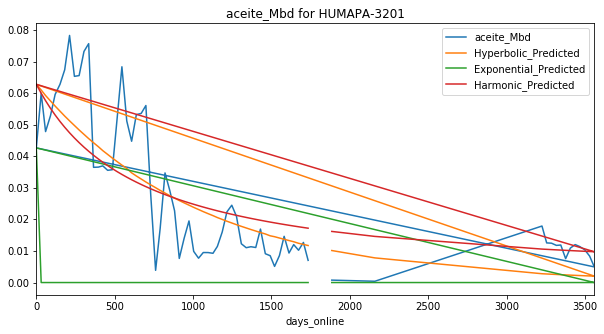

Exponential Fit Curve-fitted Variables: qi=0.010293008894810989, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.022417800502304613, b=8.367288796901906e-08, di=0.001269894516867748
Harmonic Fit Curve-fitted Variables: qi=0.021796858428098358, di=0.0014103524678499358


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


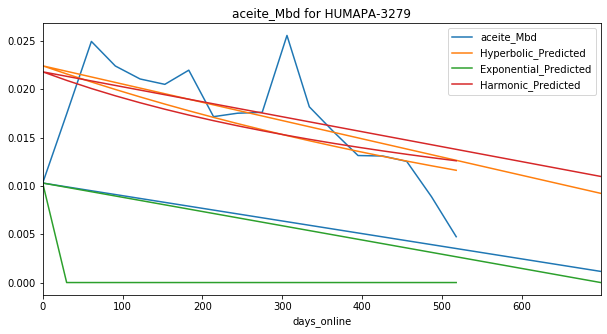

Exponential Fit Curve-fitted Variables: qi=0.0495740002530492, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.10187838016153601, b=0.8295542646634918, di=0.006920259373450155
Harmonic Fit Curve-fitted Variables: qi=0.10169878386809421, di=0.007833648451489298


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


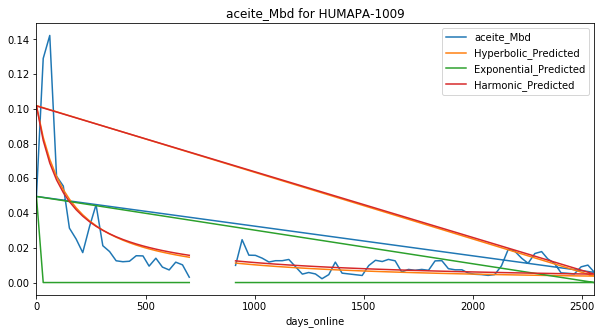

Exponential Fit Curve-fitted Variables: qi=0.034500627042696214, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.033060318931235615, b=2.3361614622792844e-11, di=0.0007795264750953572
Harmonic Fit Curve-fitted Variables: qi=0.03459084810853759, di=0.0013172646759040875


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


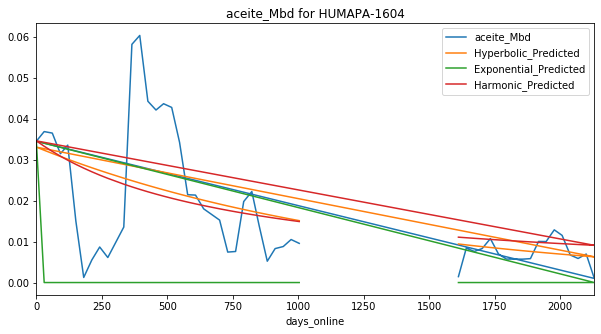

Exponential Fit Curve-fitted Variables: qi=0.011319970353800557, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.017101504996901294, b=7.108899104881435e-08, di=0.0009595859384181378
Harmonic Fit Curve-fitted Variables: qi=0.017872502071019297, di=0.0017958202747088393


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


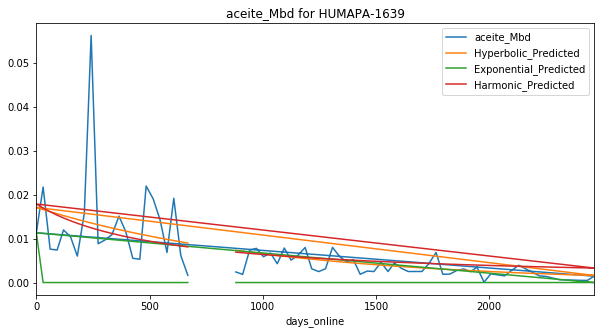

Exponential Fit Curve-fitted Variables: qi=0.011769014328105131, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.00901156408835196, b=1.9999999999999998, di=0.00011995414207458385
Harmonic Fit Curve-fitted Variables: qi=0.008840519370773849, di=9.165014126193962e-05


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


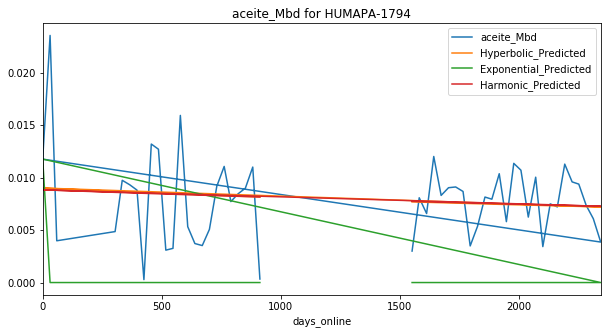

Exponential Fit Curve-fitted Variables: qi=0.017909001574670583, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.03049074968066905, b=6.526951288471361e-15, di=0.0024326037130042054
Harmonic Fit Curve-fitted Variables: qi=0.03366226311026463, di=0.005579233141374242


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


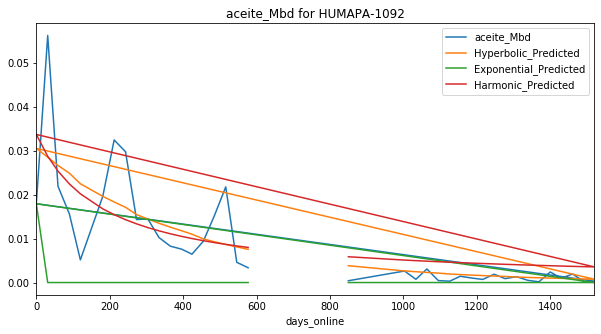

Exponential Fit Curve-fitted Variables: qi=0.013209000709909853, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.11278559216173518, b=9.544028377629782e-09, di=0.0035327215660165166
Harmonic Fit Curve-fitted Variables: qi=0.112039027065881, di=0.0062325999247717645


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


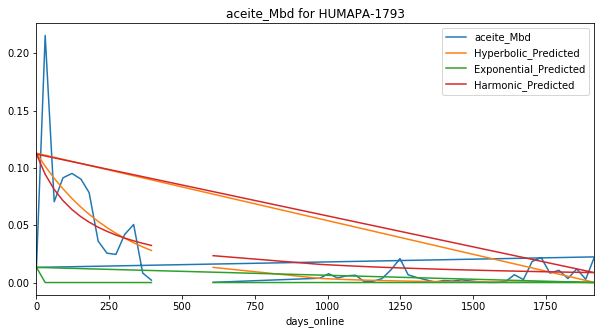

Exponential Fit Curve-fitted Variables: qi=0.0158480000541703, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.03289986828243826, b=1.72343457783341e-08, di=0.0005575567312754281
Harmonic Fit Curve-fitted Variables: qi=0.034111034075800566, di=0.0008432140030134149


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


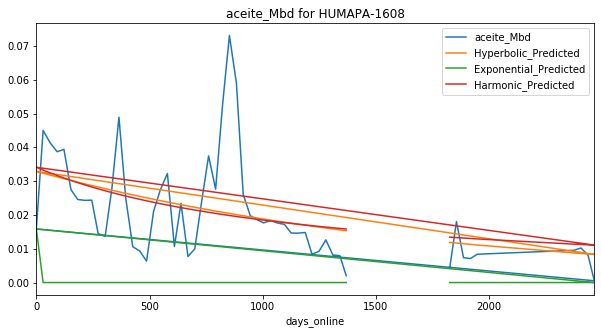

Exponential Fit Curve-fitted Variables: qi=0.0790717060546875, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.07557246459599123, b=1.9999999999999998, di=0.041167334237806386
Harmonic Fit Curve-fitted Variables: qi=0.03401175822182475, di=0.0018761754444239279


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


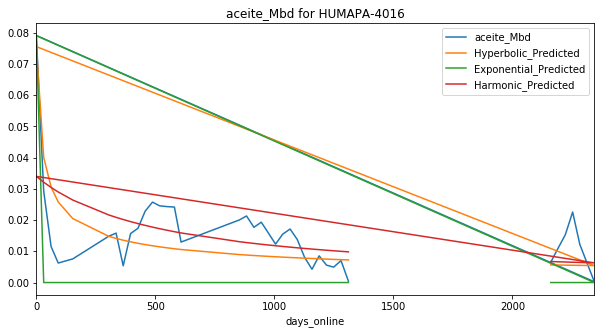

Exponential Fit Curve-fitted Variables: qi=0.011326561675658969, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.010997987614558984, b=1.9999999968414628, di=5.849987331044359e-05
Harmonic Fit Curve-fitted Variables: qi=0.010966620262324813, di=5.308728597443662e-05


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


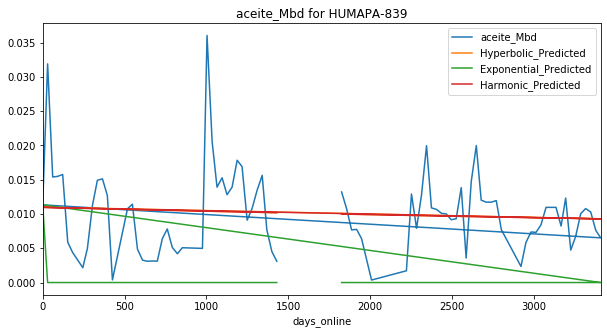

Exponential Fit Curve-fitted Variables: qi=0.024126025495514493, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.03650852896573896, b=1.9999999999999998, di=0.005210785942753773
Harmonic Fit Curve-fitted Variables: qi=0.020431613702447095, di=0.0005586769484831517


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


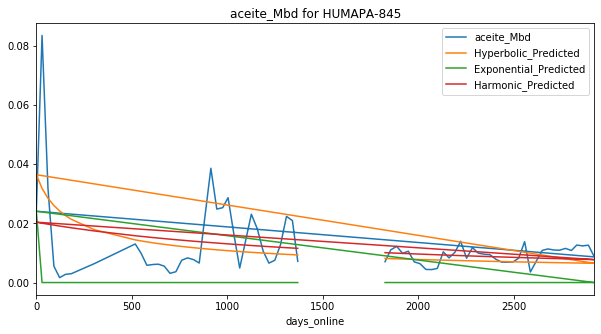

Exponential Fit Curve-fitted Variables: qi=0.015683540970632664, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.06254052370088958, b=2.286480100001593e-16, di=0.00322116145506326
Harmonic Fit Curve-fitted Variables: qi=0.06303202518284051, di=0.005702532698262638


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


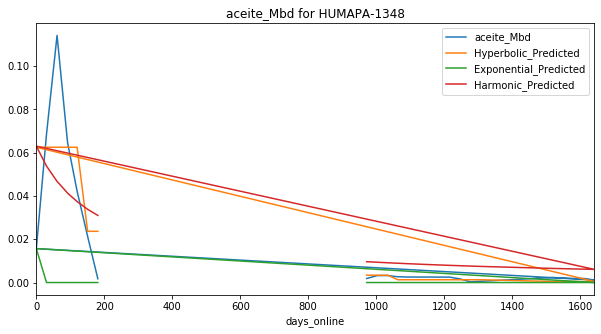

Exponential Fit Curve-fitted Variables: qi=0.06197599890511995, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.07502676776627185, b=1.154230665348709, di=0.01867372419004087
Harmonic Fit Curve-fitted Variables: qi=0.07528479521860872, di=0.016590060627542924


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


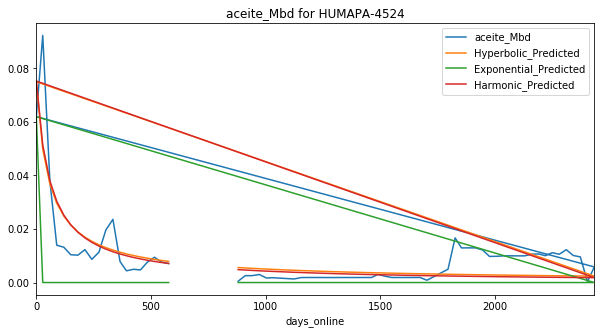

Exponential Fit Curve-fitted Variables: qi=0.014737006113083408, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.03609265422140691, b=1.9999999999810703, di=0.004092279455178506
Harmonic Fit Curve-fitted Variables: qi=0.031362259605952424, di=0.001584248648528617


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


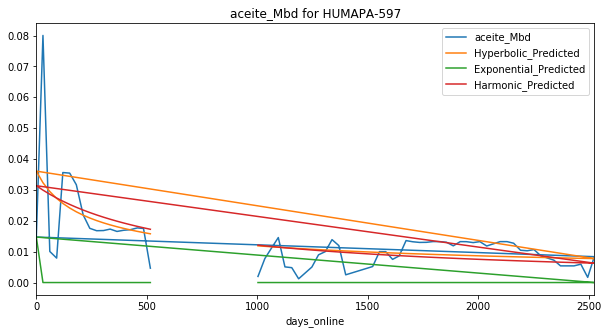

Exponential Fit Curve-fitted Variables: qi=0.005586014720349737, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.015054920096050382, b=1.2527156980965404e-10, di=0.00021015562408902236
Harmonic Fit Curve-fitted Variables: qi=0.014745667141755304, di=0.00019610830236777086


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


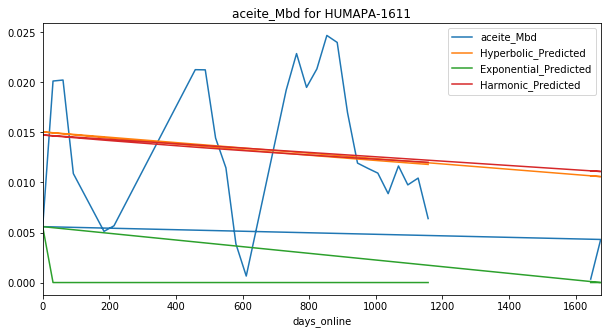

Exponential Fit Curve-fitted Variables: qi=0.008418366979308466, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.14084431217823323, b=9.228402151405646e-09, di=0.0018988042927160663
Harmonic Fit Curve-fitted Variables: qi=0.1427615103954042, di=0.00354178194415905


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


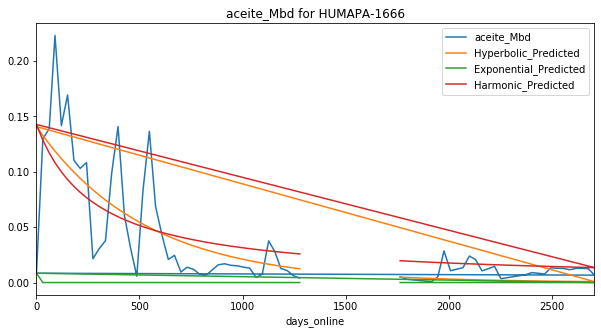

Exponential Fit Curve-fitted Variables: qi=0.010620026026155383, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.0221149999915566, b=2.5101777028481775e-12, di=0.0007906087053928483
Harmonic Fit Curve-fitted Variables: qi=0.022114999999999975, di=0.0012024225985477243


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


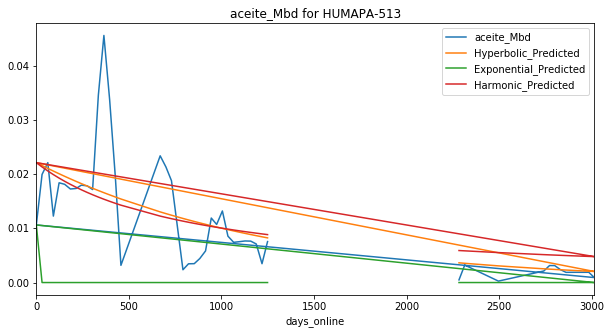

Exponential Fit Curve-fitted Variables: qi=0.05229000000182713, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.10600158599604295, b=0.8877535843616127, di=0.004721636590657039
Harmonic Fit Curve-fitted Variables: qi=0.10597861265558361, di=0.005066880624807998


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


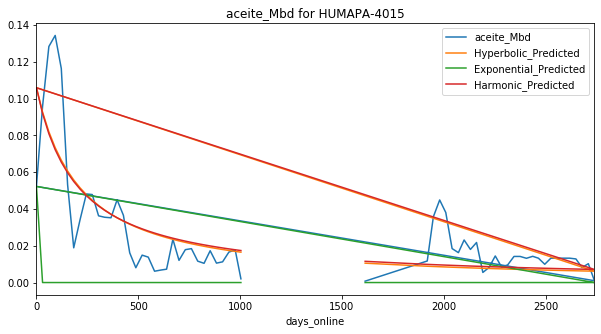

Exponential Fit Curve-fitted Variables: qi=0.022168958706043684, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.03139246481566747, b=1.9999999978266751, di=0.0016423830680936074
Harmonic Fit Curve-fitted Variables: qi=0.027847356734404943, di=0.0007257626886993772


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


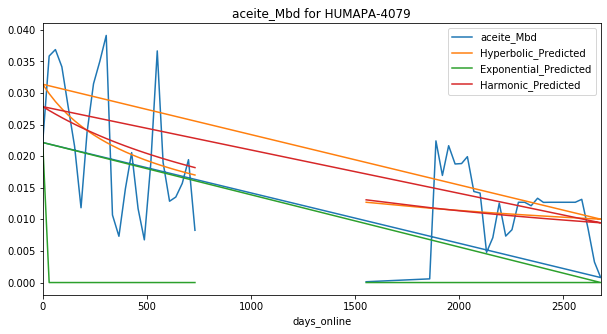

Exponential Fit Curve-fitted Variables: qi=0.010183005030425709, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.02850505352729756, b=0.8876924791399636, di=0.00513231809447233
Harmonic Fit Curve-fitted Variables: qi=0.02855161724496303, di=0.005410825465569133


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


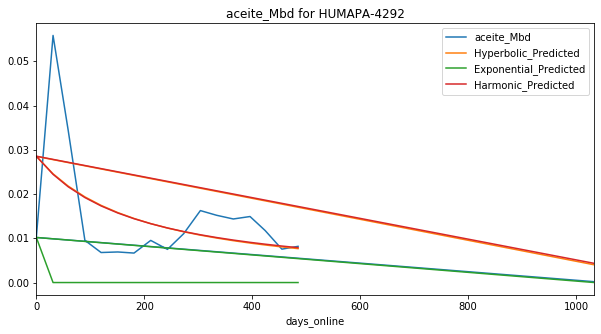

Exponential Fit Curve-fitted Variables: qi=0.0080079453125, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.008070999041826574, b=1.9999999995049624, di=6.891226970254779e-09
Harmonic Fit Curve-fitted Variables: qi=0.00807099947517419, di=7.187939293769226e-10


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


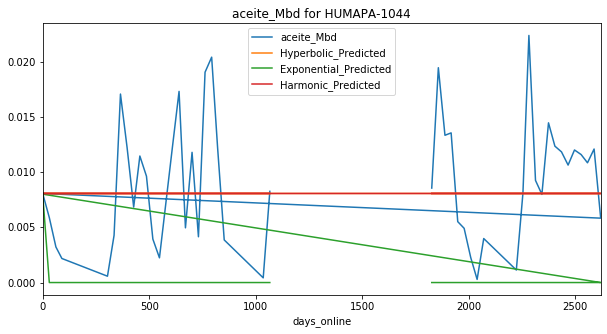

Exponential Fit Curve-fitted Variables: qi=0.047555935546875, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.03996443110009642, b=1.9999999999999998, di=0.021743025792904314
Harmonic Fit Curve-fitted Variables: qi=0.02244274961851342, di=0.0018022721406461553


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


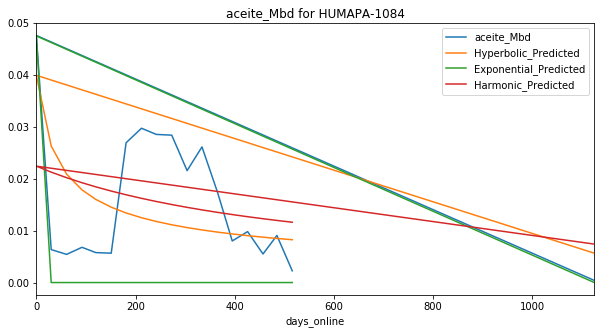

Exponential Fit Curve-fitted Variables: qi=0.011335742187500001, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.011325741624829275, b=1.9999999999999998, di=0.02874151456773275
Harmonic Fit Curve-fitted Variables: qi=0.01126014663334734, di=0.021286546293850832


C:\Users\elias\Anaconda\lib\site-packages\scipy\optimize\minpack.py:787: OptimizeWarning: Covariance of the parameters could not be estimated
  category=OptimizeWarning)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


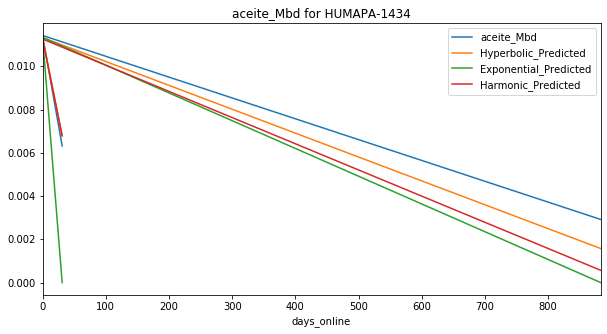

Exponential Fit Curve-fitted Variables: qi=0.02084326171875, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.008957598492878296, b=1.9911831640106468, di=8.256484166500102e-05
Harmonic Fit Curve-fitted Variables: qi=0.008925966408256552, di=7.338994356403131e-05


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


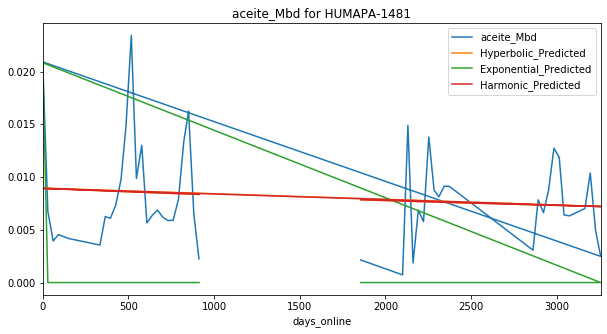

Exponential Fit Curve-fitted Variables: qi=0.01837697427210578, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.02244883979140214, b=2.799960134383281e-16, di=0.0003498892230228851
Harmonic Fit Curve-fitted Variables: qi=0.02298388237141118, di=0.0005287139437534355


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


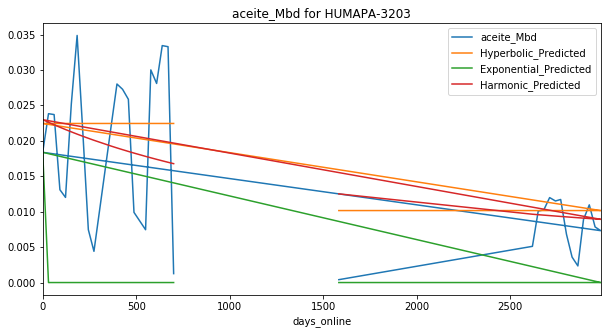

Exponential Fit Curve-fitted Variables: qi=0.05000496671112497, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.08420232896351484, b=0.49838317215668804, di=0.0036221325441889176
Harmonic Fit Curve-fitted Variables: qi=0.0849899812772759, di=0.004901674599841438


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


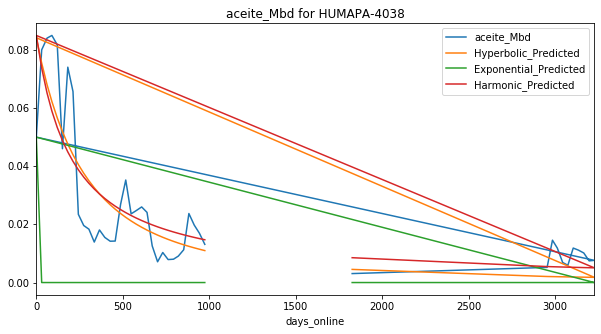

Exponential Fit Curve-fitted Variables: qi=0.011253160426627528, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.023505252982050775, b=1.9999999999993976, di=0.0012511201768311648
Harmonic Fit Curve-fitted Variables: qi=0.02167590135600581, di=0.0006188480525897342


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


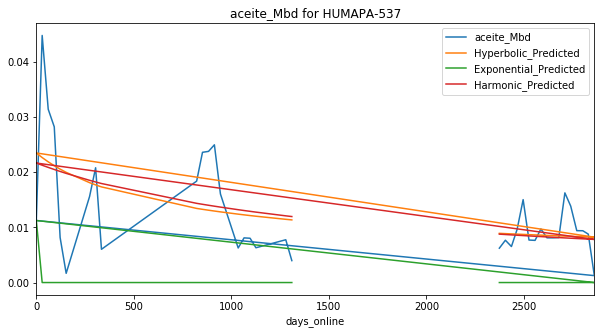

Exponential Fit Curve-fitted Variables: qi=0.008716371802225537, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.017285999833573824, b=1.3297173424987991e-11, di=0.0001924074172698995
Harmonic Fit Curve-fitted Variables: qi=0.017286, di=0.000171149367393622


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


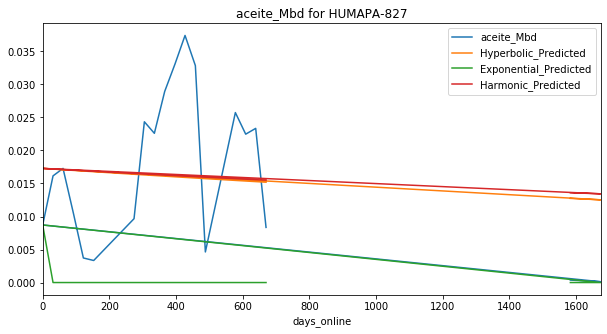

Exponential Fit Curve-fitted Variables: qi=0.007698005957063534, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.03680002086289865, b=1.638873081833412, di=0.0034447703616288347
Harmonic Fit Curve-fitted Variables: qi=0.03435681693287133, di=0.002067400690242529


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


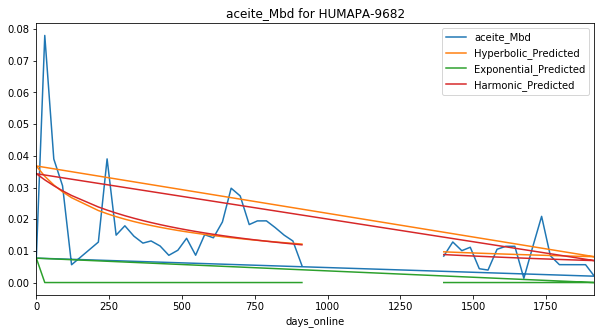

Exponential Fit Curve-fitted Variables: qi=0.018601999605192154, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.02331852220593632, b=7.966192402996189e-16, di=0.0003960809618425477
Harmonic Fit Curve-fitted Variables: qi=0.025236591430039687, di=0.0007087481352654209


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


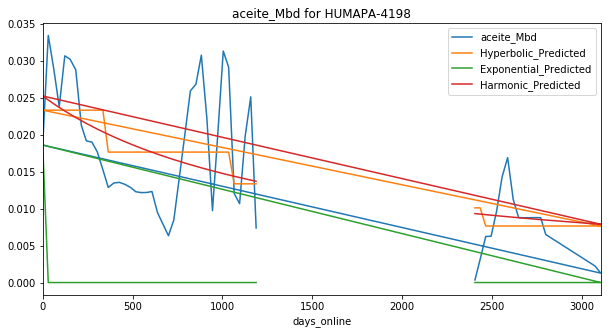

Exponential Fit Curve-fitted Variables: qi=0.027797700166178232, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.02812412738785411, b=1.327765069905731, di=0.004347387418979877
Harmonic Fit Curve-fitted Variables: qi=0.027466929508747885, di=0.0035770188635228296


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


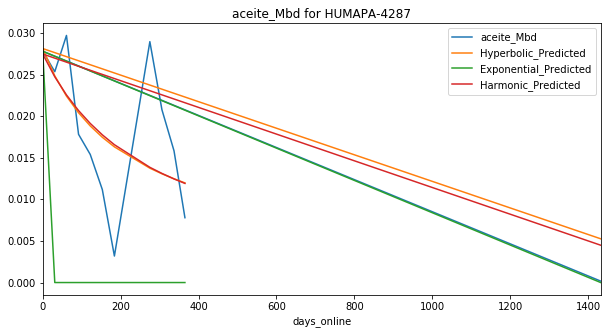

Exponential Fit Curve-fitted Variables: qi=0.02945236328125, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.028688390670424887, b=1.9999999999999998, di=0.04686840197824004
Harmonic Fit Curve-fitted Variables: qi=0.025330744216496153, di=0.017522232749459504


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


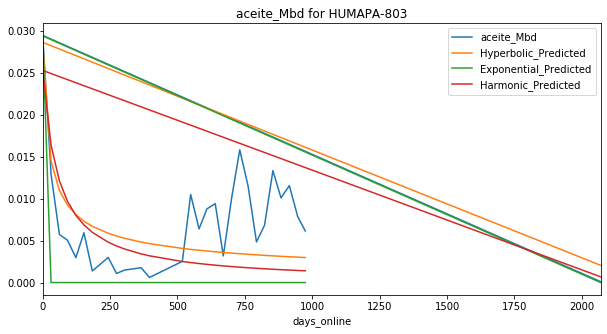

Exponential Fit Curve-fitted Variables: qi=0.034553380859374996, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.019644169770969784, b=1.9999999999999998, di=0.0011879910511891387
Harmonic Fit Curve-fitted Variables: qi=0.015641214921314435, di=0.00034611619175873524


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


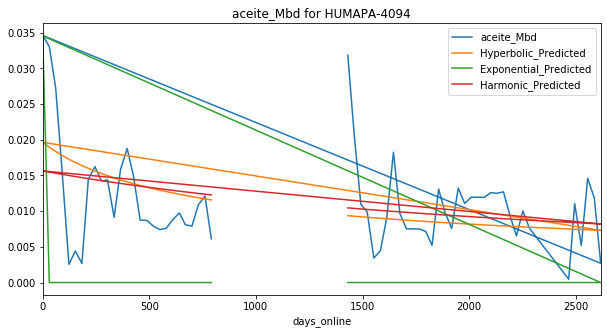

Exponential Fit Curve-fitted Variables: qi=0.018430478329577386, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.07404060880565105, b=9.695168526214208e-09, di=0.002017091380218608
Harmonic Fit Curve-fitted Variables: qi=0.07301693676491453, di=0.0032447227339442095


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


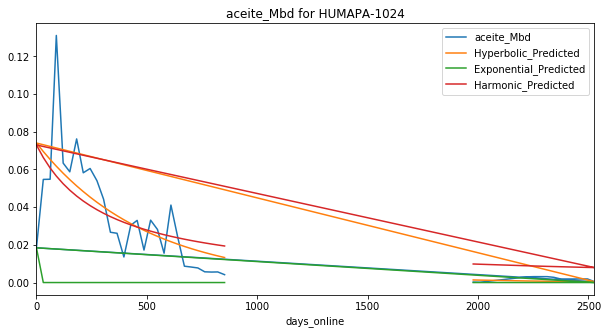

Exponential Fit Curve-fitted Variables: qi=0.06046504282515266, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.10256003812606718, b=0.8936432446035443, di=0.008630414346566296
Harmonic Fit Curve-fitted Variables: qi=0.10202325370220337, di=0.009153264959973997


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


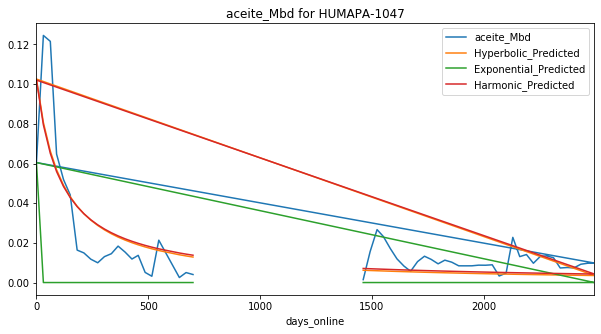

Exponential Fit Curve-fitted Variables: qi=0.02856609765625, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.026276890540111546, b=1.9999999999999998, di=0.0021696710775053357
Harmonic Fit Curve-fitted Variables: qi=0.01707011240077947, di=0.00022392200239873783


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


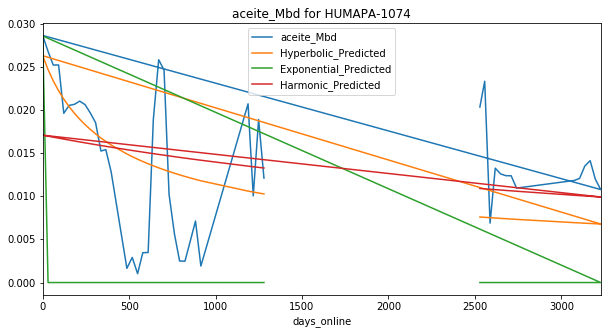

Exponential Fit Curve-fitted Variables: qi=0.01999200493892642, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.023138398068137854, b=1.9999999999999998, di=0.002447892940244804
Harmonic Fit Curve-fitted Variables: qi=0.016185860767000602, di=0.00045823447193529777


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


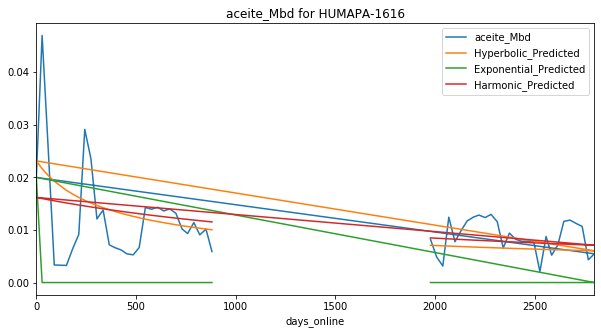

Exponential Fit Curve-fitted Variables: qi=0.020817000019798144, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.016656053391971928, b=9.100212012757983e-13, di=8.866176039245686e-05
Harmonic Fit Curve-fitted Variables: qi=0.01666050228000327, di=9.937077783280239e-05


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


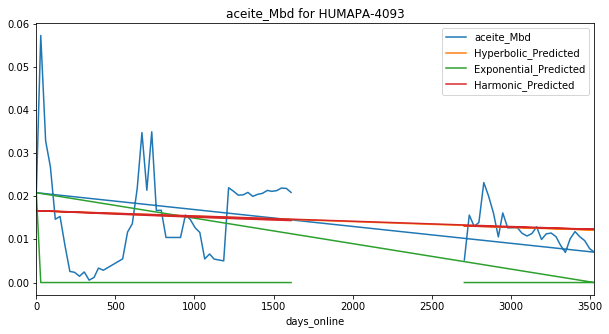

Exponential Fit Curve-fitted Variables: qi=0.01710100007723412, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.025980203212331344, b=1.999999999997526, di=0.0020049185269425925
Harmonic Fit Curve-fitted Variables: qi=0.02374983438684647, di=0.0010190517753400994


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


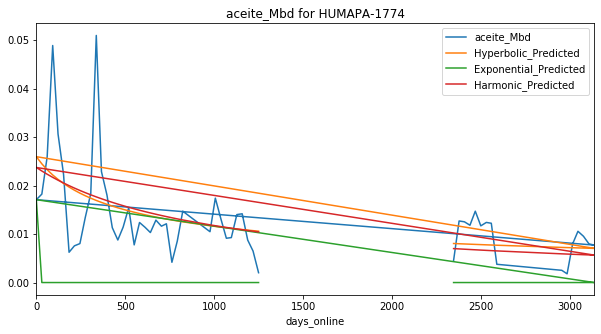

Exponential Fit Curve-fitted Variables: qi=0.025686024010469627, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.03879822918427716, b=1.9999999999999782, di=0.00675861309880348
Harmonic Fit Curve-fitted Variables: qi=0.03015895623470379, di=0.001993774340097647


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


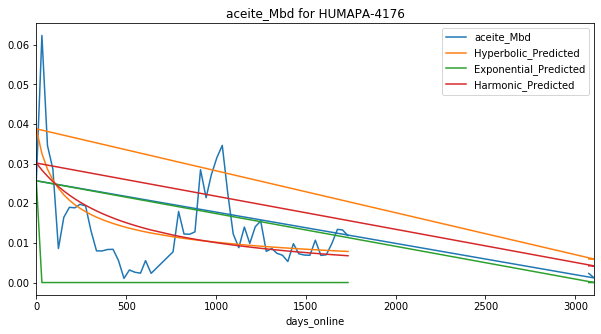

Exponential Fit Curve-fitted Variables: qi=0.03268603515625, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.021232574621027234, b=1.9999999999999998, di=0.0009718173190308754
Harmonic Fit Curve-fitted Variables: qi=0.018359105880612205, di=0.000353120647473255


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


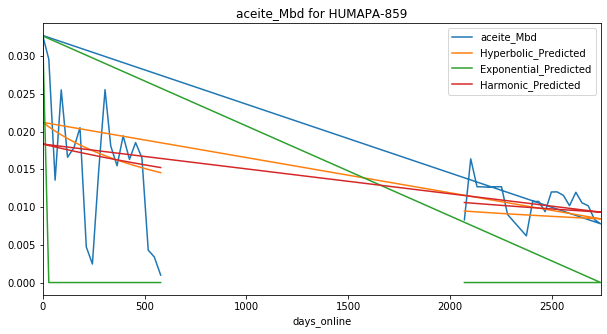

Exponential Fit Curve-fitted Variables: qi=0.00756900048614006, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.06119386993527795, b=0.9707073569492677, di=0.0028620540328035916
Harmonic Fit Curve-fitted Variables: qi=0.06126545385161816, di=0.0029107899893677926


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


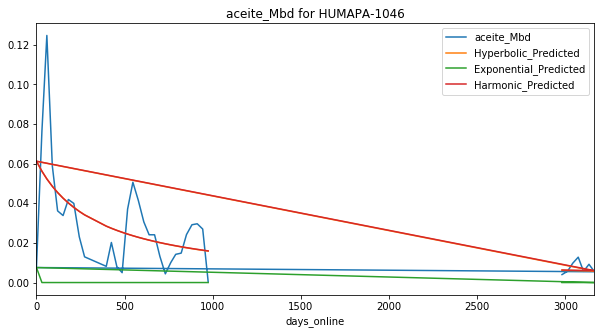

Exponential Fit Curve-fitted Variables: qi=0.01968100008375028, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.11113611609726745, b=0.3172447524316986, di=0.0031859313014348596
Harmonic Fit Curve-fitted Variables: qi=0.110955255681019, di=0.004761588879156732


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


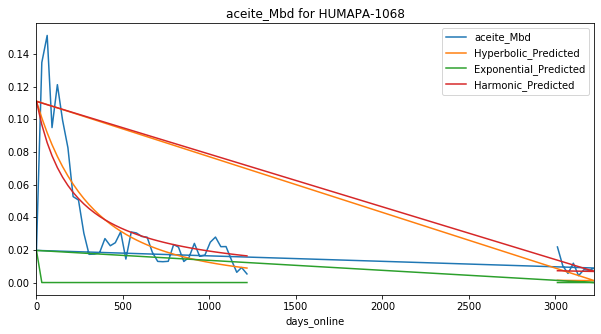

Exponential Fit Curve-fitted Variables: qi=0.022949999999999998, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.016967734180843127, b=8.446309234147141e-11, di=9.191350395726249e-05
Harmonic Fit Curve-fitted Variables: qi=0.01694708508099997, di=0.00010002532644105486


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


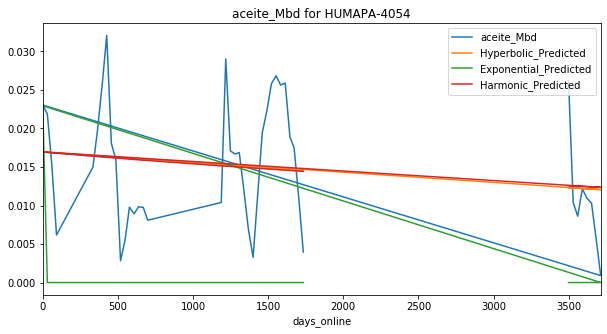

Exponential Fit Curve-fitted Variables: qi=0.05508215624999999, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.014292819434316985, b=1.9999999999999998, di=0.0001210200328857224
Harmonic Fit Curve-fitted Variables: qi=0.01412705147737294, di=9.838280693472802e-05


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


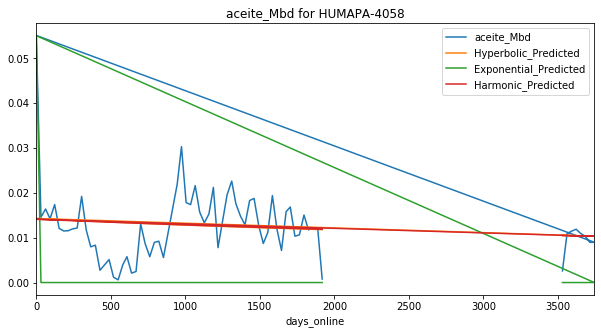

Exponential Fit Curve-fitted Variables: qi=0.01562100005605693, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.05434991718531525, b=1.84953174930361e-09, di=0.004352731526769478
Harmonic Fit Curve-fitted Variables: qi=0.05006653471205019, di=0.005169253164059263


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


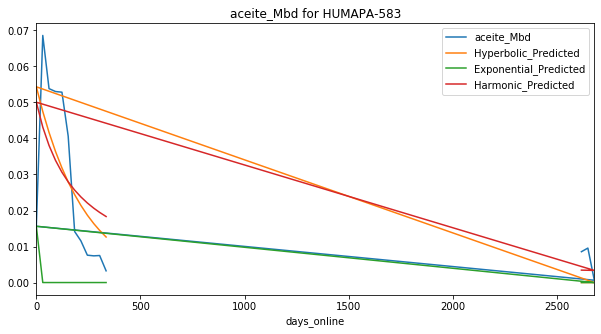

Exponential Fit Curve-fitted Variables: qi=0.0029200295668421533, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.02350504669342747, b=1.9999999999999998, di=2.229176016260863e-15
Harmonic Fit Curve-fitted Variables: qi=0.023505036381878442, di=5.2937915791558434e-14


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


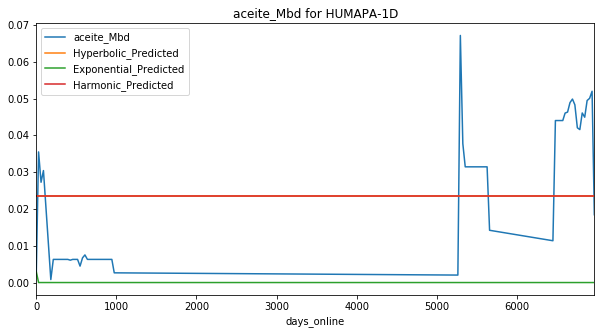

Exponential Fit Curve-fitted Variables: qi=0.010162028251777496, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.02180574915155474, b=1.9997838463745774, di=2.5515502058829627e-23
Harmonic Fit Curve-fitted Variables: qi=0.02180573805984463, di=1.3096143055180897e-13


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


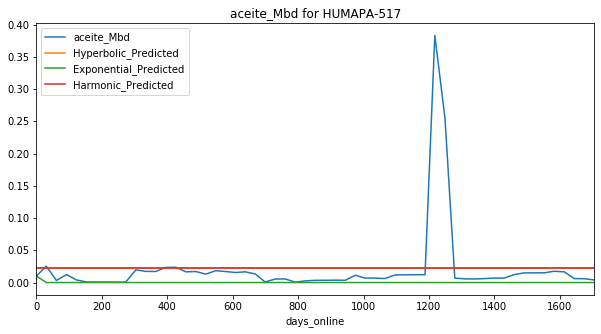

Exponential Fit Curve-fitted Variables: qi=0.03132899850339157, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.03743256446832655, b=1.9999999999999984, di=0.01340528884622834
Harmonic Fit Curve-fitted Variables: qi=0.0342319921983477, di=0.006564575871225003


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


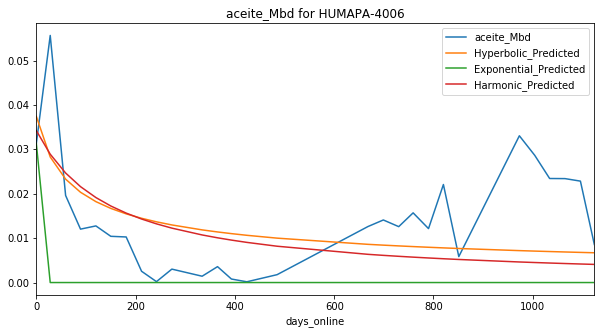

Exponential Fit Curve-fitted Variables: qi=0.027072011755960766, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.08500307216143417, b=1.7314785729647337, di=0.005110859525296429
Harmonic Fit Curve-fitted Variables: qi=0.08236338922943831, di=0.0033358507965627355


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


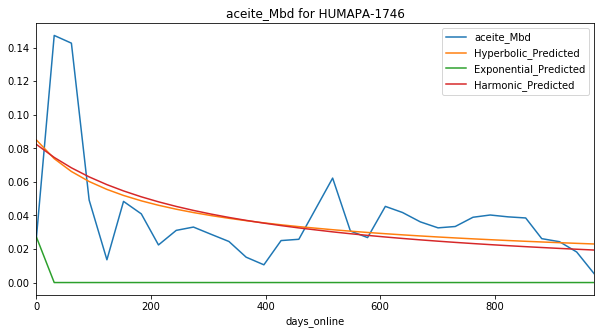

Exponential Fit Curve-fitted Variables: qi=0.006083005159590332, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.02082861482799123, b=0.3575062965878738, di=0.0015858160474731217
Harmonic Fit Curve-fitted Variables: qi=0.021177521385165623, di=0.0020268400207410176


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


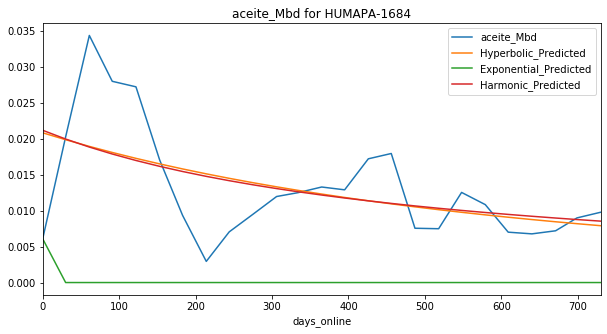

Exponential Fit Curve-fitted Variables: qi=0.007842095703356634, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.01841287116213316, b=1.999970704077705, di=0.0013803173861279485
Harmonic Fit Curve-fitted Variables: qi=0.0182273669793754, di=0.001140568408555755


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


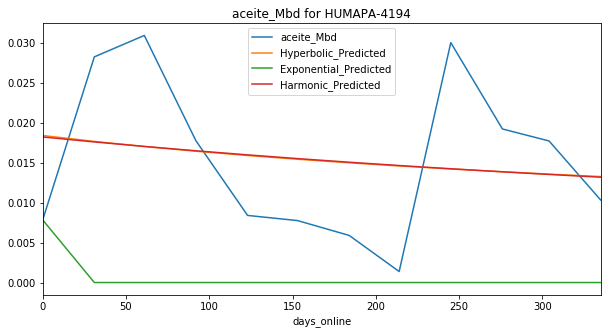

Exponential Fit Curve-fitted Variables: qi=0.01798007237340927, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.03667218469137616, b=1.3210684098055483, di=0.006945860561373251
Harmonic Fit Curve-fitted Variables: qi=0.03682788742522773, di=0.006062663919072344


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


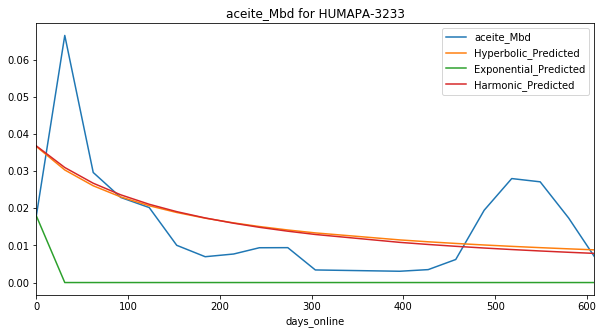

Exponential Fit Curve-fitted Variables: qi=0.019072993366208803, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.02339216609632556, b=1.729351673300007, di=0.006867462578740701
Harmonic Fit Curve-fitted Variables: qi=0.02329206565143363, di=0.005535225519888862


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


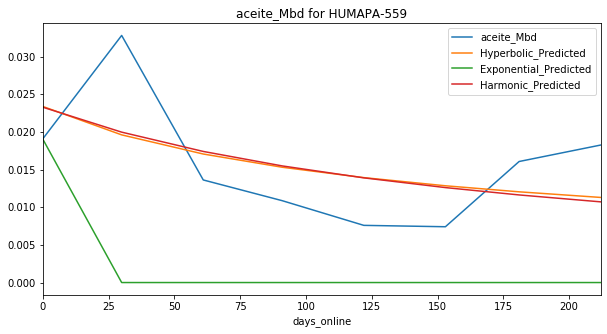

Exponential Fit Curve-fitted Variables: qi=0.015469954230212688, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.015829970905848118, b=8.924949613493574e-08, di=0.009721508006347634
Harmonic Fit Curve-fitted Variables: qi=0.015829857288346023, di=0.012714283637327945


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


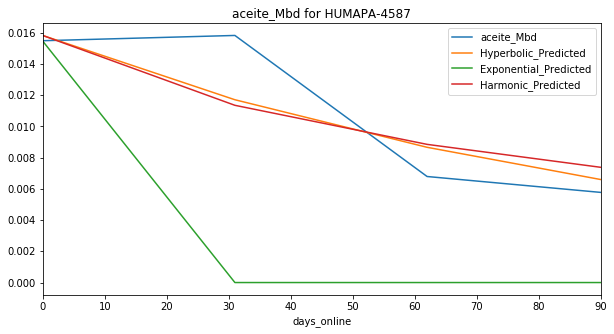

C:\Users\elias\Anaconda\lib\site-packages\scipy\optimize\minpack.py:787: OptimizeWarning: Covariance of the parameters could not be estimated
  category=OptimizeWarning)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)


Exponential Fit Curve-fitted Variables: qi=0.011562936240139468, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.013475995402459405, b=1.973891514405687, di=2.441311866339789e-10
Harmonic Fit Curve-fitted Variables: qi=0.013474223602132197, di=9.9359751553989e-07


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


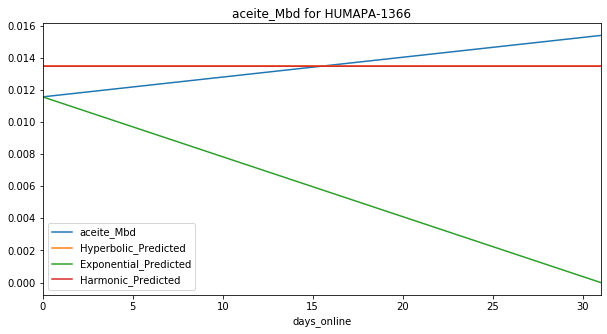

Exponential Fit Curve-fitted Variables: qi=0.021169416209324176, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.015897073928281553, b=1.9999995524925867, di=0.000480829031596074
Harmonic Fit Curve-fitted Variables: qi=0.01587222621816618, di=0.00044856203365488065


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


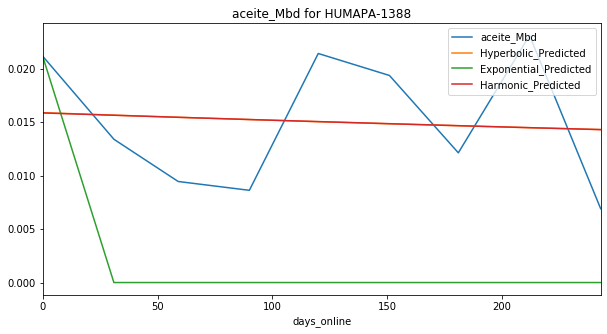

Exponential Fit Curve-fitted Variables: qi=0.016230038768782613, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.015574366212130568, b=9.160270423826273e-09, di=0.0015411586353131339
Harmonic Fit Curve-fitted Variables: qi=0.01553750082836842, di=0.0018997599321934596


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


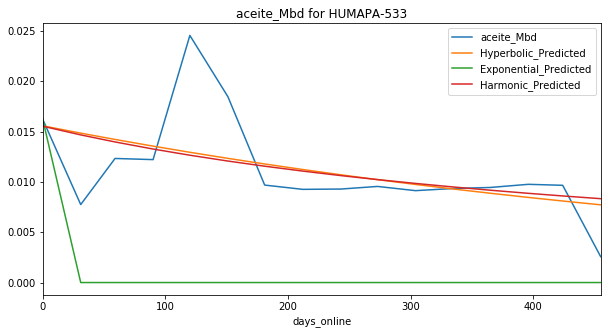

Exponential Fit Curve-fitted Variables: qi=0.0029990227941921153, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.009481431730527153, b=1.5378684498465832e-07, di=0.004223897259992794
Harmonic Fit Curve-fitted Variables: qi=0.009050311454608651, di=0.0034150163050591987


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


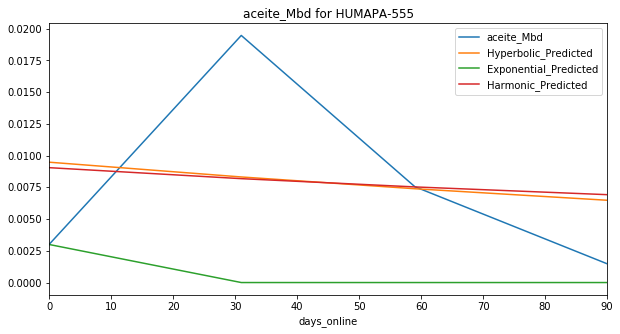

Exponential Fit Curve-fitted Variables: qi=0.0075070184397096305, di=5.0
Hyperbolic Fit Curve-fitted Variables: qi=0.018236770453321074, b=3.8089427475391763e-10, di=0.0036854960559952105
Harmonic Fit Curve-fitted Variables: qi=0.017470474895429338, di=0.003980531772730708


C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\elias\Anaconda\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


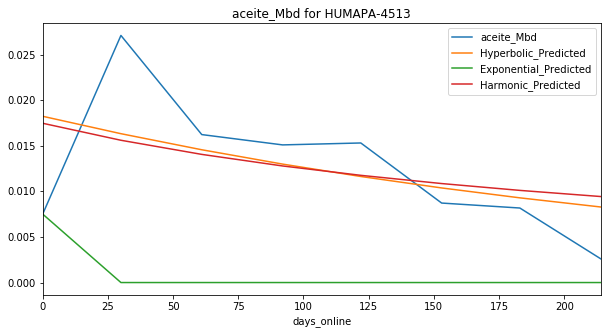

'Tiempo de procesamiento: 483.9279442000002 segundos'

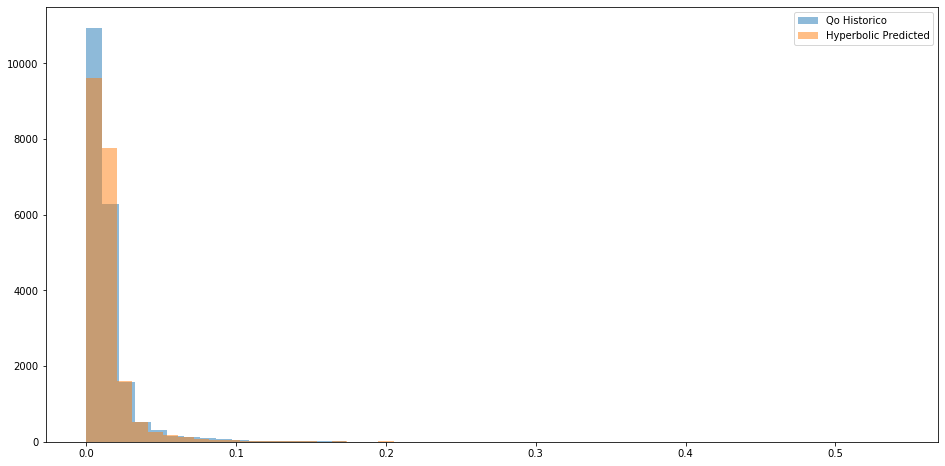

In [46]:
productividad()

In [37]:
outliers=[]
def detect_outlier(data_1):
    global z_score
    global outliers
    threshold=3
    mean_1 = np.mean(data_1)
    std_1 =np.std(data_1)
    
    
    for y in data_1:
        z_score= (y - mean_1)/std_1 
        if np.abs(z_score) > threshold:
            outliers.append(y)
    return z_score

In [38]:
score=[]
def outlier_filter(data):
    global score
    global outliers
    threshold=3
    mean_1 = np.mean(data)
    std_1 =np.std(data)
    
    
    for y in data:
        z = (y - mean_1)/std_1 
        score.append(z)
    return score

In [39]:
df=campo
outliers=outlier_filter(df.aceite_Mbd)

In [40]:
display(score)

[0.2770316889166332,
 -1.183617884839536,
 1.2216736752980148,
 0.44379426217172896,
 1.2221802317801302,
 0.900494206549754,
 1.2293379856501783,
 0.8455250234435534,
 1.354216746873358,
 -1.1554649760986748,
 0.7765920519836945,
 1.409041415356927,
 0.3105109937487622,
 0.8497161992674964,
 0.7308652587673808,
 1.2054583289823504,
 0.7542559826875606,
 0.8751472481037111,
 1.2573989992041747,
 2.1195530964116798,
 0.7784941564679793,
 0.7772018331962607,
 1.4384798496433555,
 2.1437577850966107,
 0.6837650731007987,
 0.8699749338052137,
 1.3487231770722867,
 2.2307067449994147,
 -0.8383530652654511,
 0.6417898694172877,
 0.9008859569901971,
 1.3005036324994002,
 2.345866520199186,
 1.8888954220780005,
 0.7686774846020957,
 0.9054049342752301,
 1.3297205112668116,
 2.353520256310669,
 2.1129693727499923,
 0.7729210280941702,
 0.9718972702790127,
 1.4003317657832213,
 2.4388040250739547,
 1.9995538437272062,
 0.7885993540438542,
 0.9743520047226629,
 -1.1546064484624854,
 1.39692711205

In [43]:
selected_row=score[score<=3]

TypeError: '<=' not supported between instances of 'list' and 'int'